NOTEBOOK THREE

# Set up and Config

In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import seaborn as sns
import anndata as ad
import PyPDF2
import matplotlib.pyplot as plt
import statistics as st
from pathlib import Path
import scipy.stats as stats
from collections import defaultdict
from statannot import add_stat_annotation
import gseapy as gp

In [2]:
#Adata Files
adata_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_processed_04192022.h5ad"
adata = sc.read_h5ad(adata_processed)

adata_kidney_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_kidney_processed_05182022.h5ad"
tissue = sc.read_h5ad(adata_kidney_processed)

sc.settings.verbosity = 3             
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.1 scipy==1.6.2 pandas==1.2.4 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.9.8 pynndescent==0.5.5


# Clustering

In [3]:
#adata_kidney = adata[adata.obs['tissue'] == "Kidney"].copy()
#sc.pp.pca(adata_kidney)
#sc.pp.neighbors(adata_kidney, n_pcs=9)
#sc.tl.leiden(adata_kidney) 
#sc.tl.umap(adata_kidney)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [4]:
#adata_kidney_processed = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/adata_files/adata_kidney_processed_05182022.h5ad"
#adata_kidney.write(adata_kidney_processed)
#tissue = sc.read_h5ad(adata_kidney_processed)

# Clustering consistancy

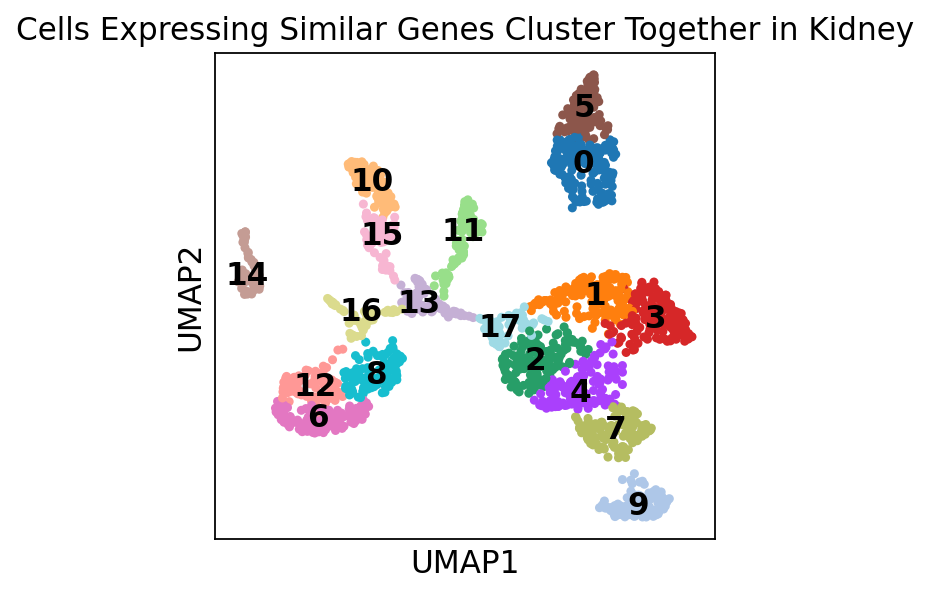

In [3]:
sc.pl.umap(tissue, color = ['leiden'], wspace= 0.5, legend_loc='on data', title = 'Cells Expressing Similar Genes Cluster Together in Kidney',
           save ='kidney_leiden_numbers_05192022.png')


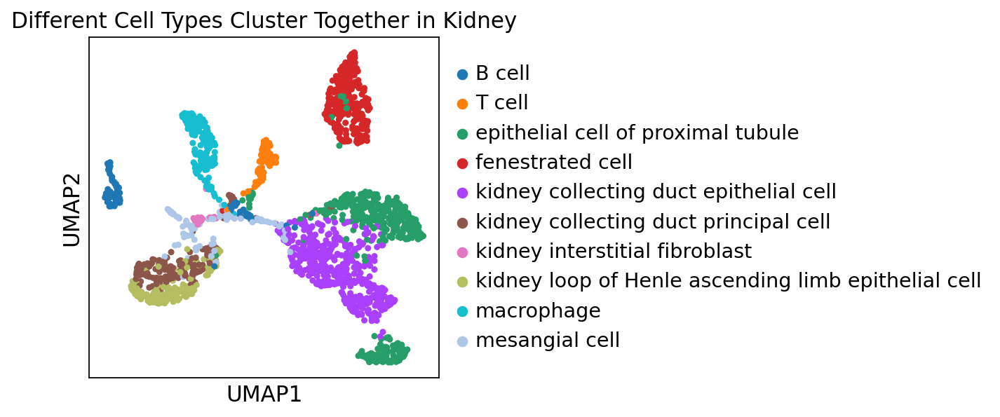

In [4]:
sc.pl.umap(tissue, color = ['cell_ontology_class'], wspace=1.0, 
           title = 'Different Cell Types Cluster Together in Kidney', save = 'UMAP_cell_ontology_class_kidney_05192022.png')


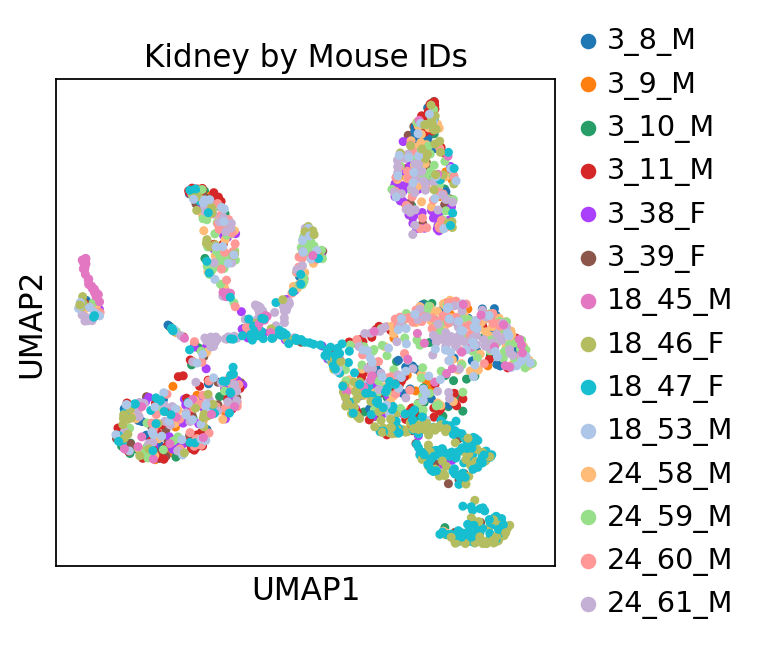

In [4]:
sc.pl.umap(tissue, color = ['mouse.id'], wspace=1.0, 
           title = 'Kidney by Mouse IDs', save = 'UMAP_mouse_id_kidney_06092022.png')


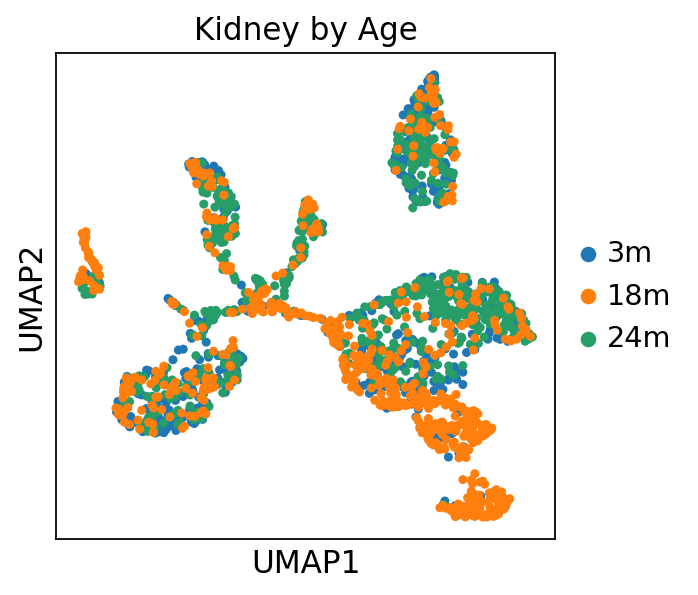

In [5]:
sc.pl.umap(tissue, color = ['age'], wspace=1.0, 
           title = 'Kidney by Age', save = 'UMAP_age_kidney_06092022.png')

## Kidney

### mt genes

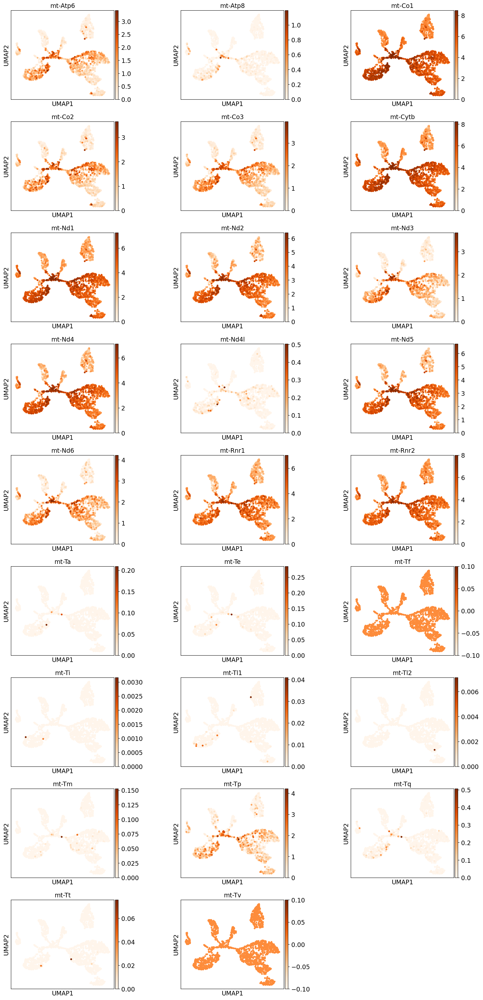

In [9]:
sc.pl.umap(tissue, color = ['mt-Atp6','mt-Atp8','mt-Co1','mt-Co2','mt-Co3','mt-Cytb','mt-Nd1','mt-Nd2','mt-Nd3','mt-Nd4','mt-Nd4l','mt-Nd5','mt-Nd6','mt-Rnr1','mt-Rnr2','mt-Ta','mt-Te','mt-Tf','mt-Ti','mt-Tl1','mt-Tl2','mt-Tm','mt-Tp','mt-Tq','mt-Tt','mt-Tv'], wspace= 0.5, color_map='Oranges', ncols=3, save = 'UMAP_mt_gene_exp_kidney_05192022.png')



* "Mechanistically, through an autocrine effect, macrophage-derived TSP1 suppressed Smpdl3b expression in liver, which amplified liver proinflammatory signalling (Toll-like receptor 4 signal pathway) and promoted NAFLD progression." https://pubmed.ncbi.nlm.nih.gov/33294831/

* "Binding of mycobacterial trehalose 6,6'- dimycolate (TDM) to [Fcer1g] receptor complex leads to phosphorylation of ITAM, triggering activation of SYK, CARD9 and NF-kappa-B, consequently driving maturation of antigen-presenting cells and shaping antigen-specific priming of T-cells toward effector T-helper 1 and T-helper 17 cell subtypes." https://www.proteinatlas.org/ENSG00000158869-FCER1G 

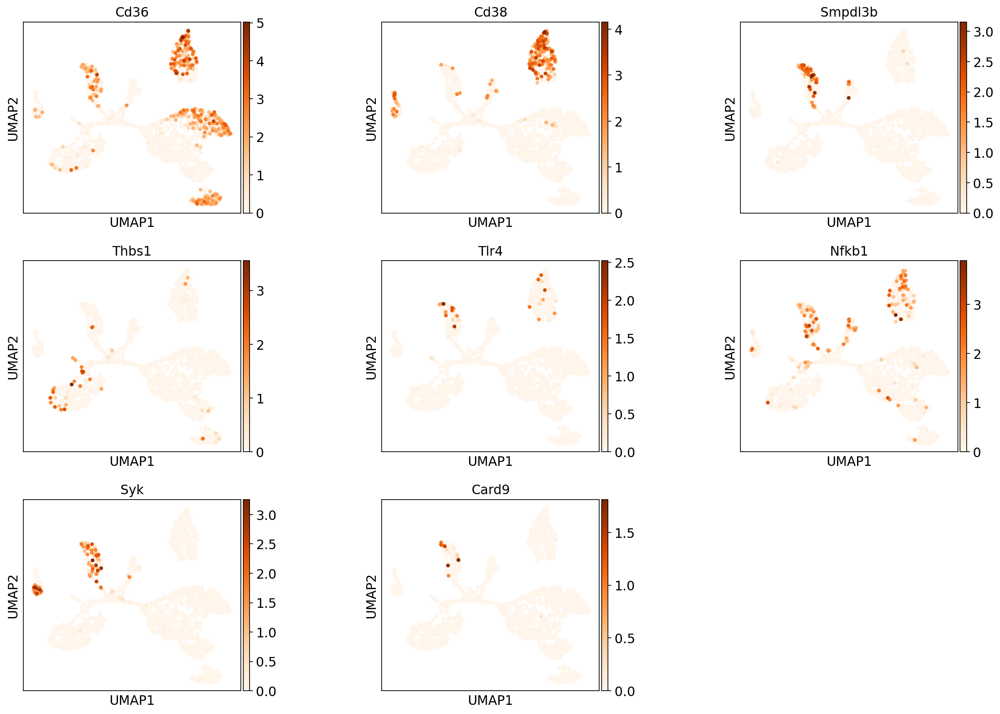

In [18]:
sc.pl.umap(tissue, color = ['Cd36', 'Cd38','Smpdl3b','Thbs1','Tlr4','Nfkb1','Syk','Card9'], wspace= 0.5, color_map='Oranges', ncols=3)

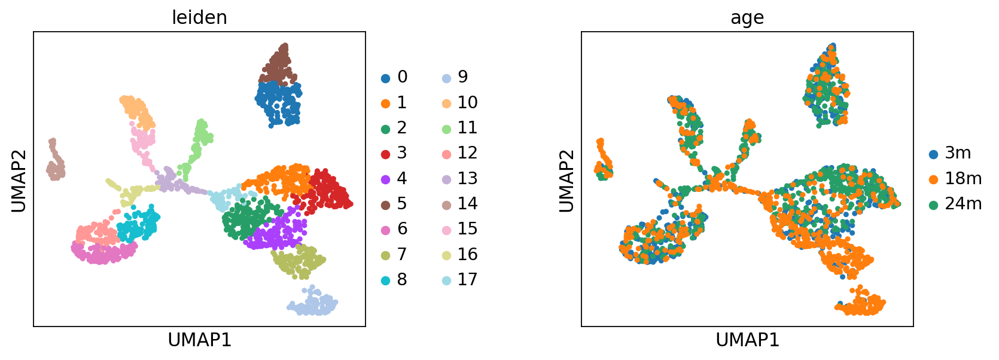

In [19]:
sc.pl.umap(tissue, color = ['leiden', 'age'], wspace=.5)

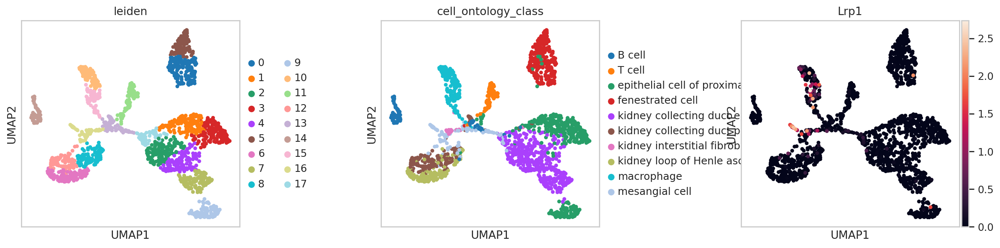

In [126]:
sc.pl.umap(tissue, color = ['leiden', 'cell_ontology_class','Lrp1'], wspace= 0.5)

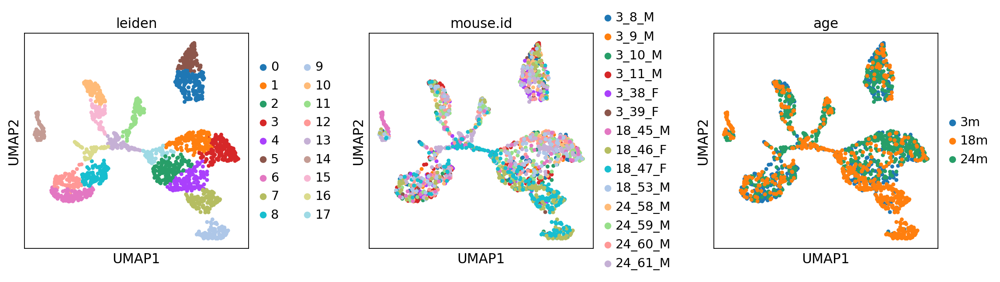

In [15]:
sc.pl.umap(tissue, color = ['leiden', 'mouse.id', 'age'], wspace= 0.4, 
          save = 'leiden_mouseid_age_kidney_05192022.png')

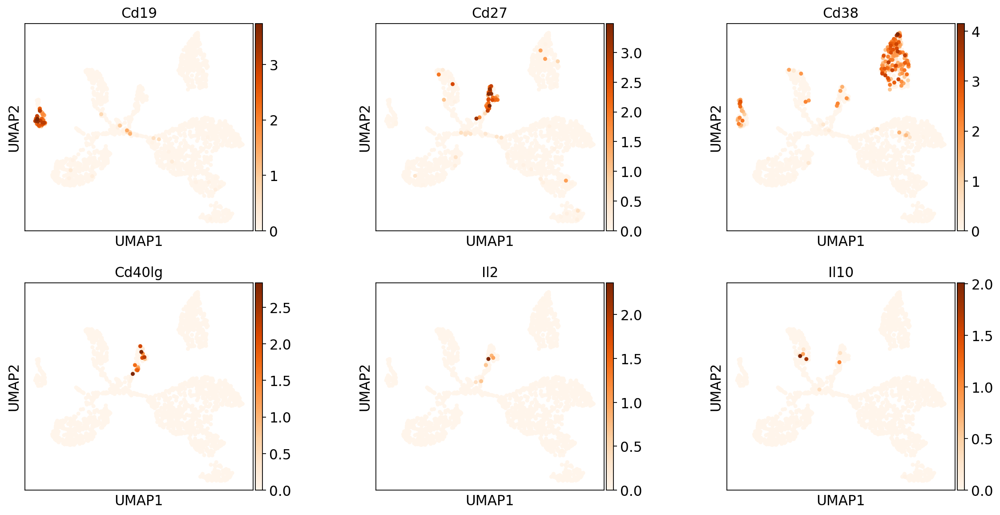

In [22]:
sc.pl.umap(tissue, color = ['Cd19', 'Cd27','Cd38', 'Cd40lg', 'Il2', 'Il10'], wspace= 0.4, color_map='Oranges', ncols = 3)
#B cell marker, Cd19+, Cd27-, Cd38+
#Ig Secreting Cells (ISC) can be generated in vitro by culturing human B cells w/T cell-derived stimuli CD40L, IL-2, and IL-10

### Macrophage inflammatory protein production

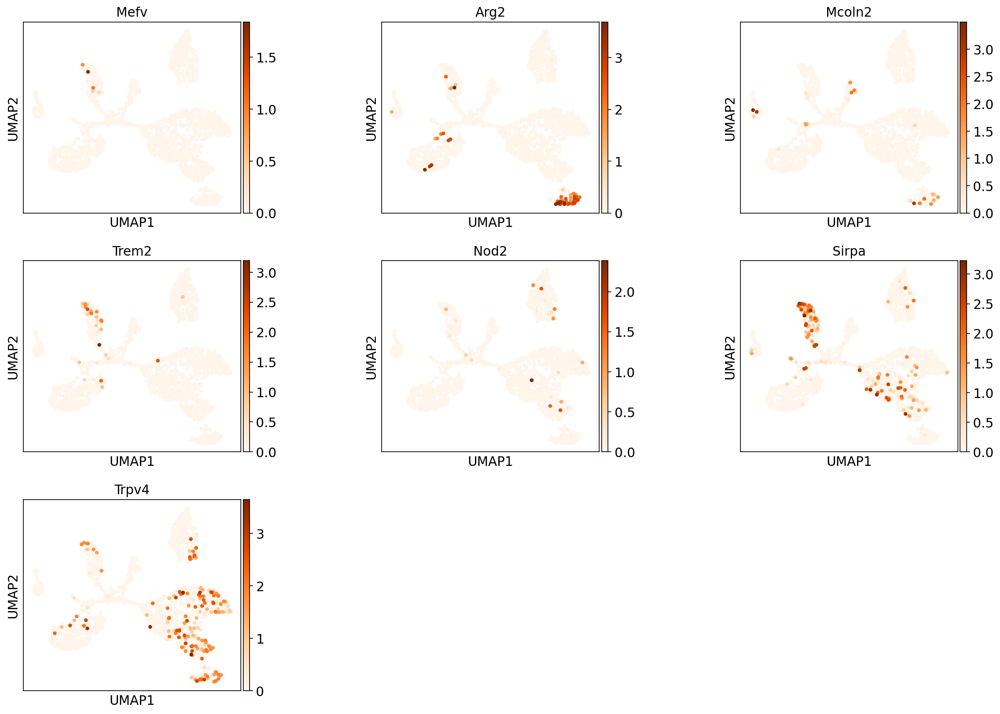

In [23]:
#as noted on geneontology.org 
sc.pl.umap(tissue, color = ['Mefv', 'Arg2','Mcoln2','Trem2','Nod2','Sirpa','Trpv4'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### B cell receptor complex

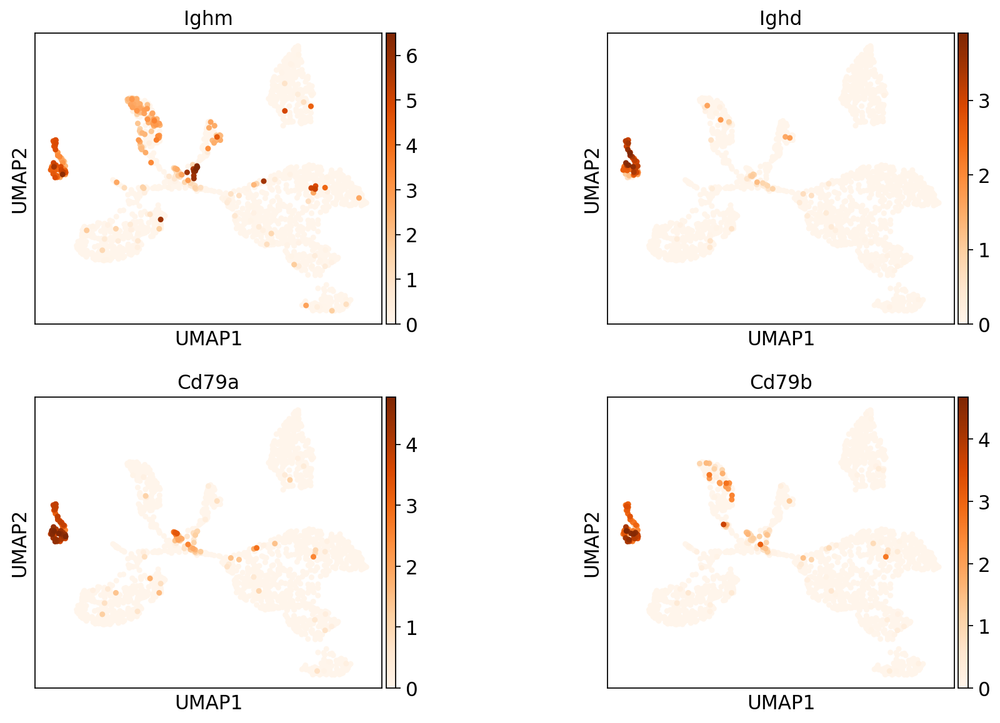

In [17]:
#as noted on geneontology.org
#sc.pl.umap(tissue, color = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
sc.pl.umap(tissue, color = ['Ighm','Ighd','Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 2,
          save = 'BCR_genes_express_in_Bcells_kidney_05192022.png')


### Macrophage regulation

According to Human Protein Atlas
* Ulbp1: All immune cells, higest in macrophages
* Grn: Many immune cells, most highly in Hofbauer, Kupffer and macrophage cells
* Cx3cl1: low in immune cells
* Fer1l5: low in immune cells
* Cd200: Enriched in B cells, monocytes. most immune cells
* Syt11: all immune cells
* Bpi: Among immune cells, highest in monocytes
* Pla2g10: barely detected in immune cells

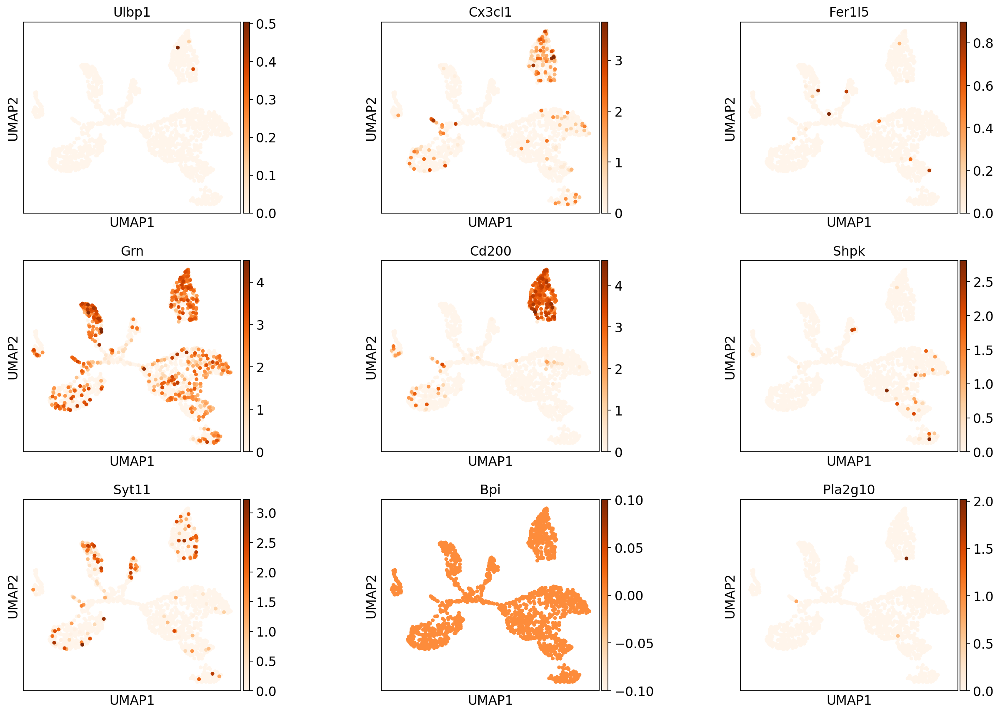

In [25]:
#as noted on geneontology.org
sc.pl.umap(tissue, color = ['Ulbp1','Cx3cl1','Fer1l5','Grn','Cd200','Shpk', 'Syt11','Bpi','Pla2g10'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### B cell differentiation

* Cd24a: results in acquisition of features of immature B cell
* Bcl6: results in acquisition of features of B cell

... storing 'FACS.selection' as categorical
... storing 'age' as categorical
... storing 'cell_ontology_class' as categorical
... storing 'cell_ontology_id' as categorical
... storing 'free_annotation' as categorical
... storing 'method' as categorical
... storing 'mouse.id' as categorical
... storing 'sex' as categorical
... storing 'subtissue' as categorical
... storing 'tissue' as categorical
... storing 'leiden' as categorical


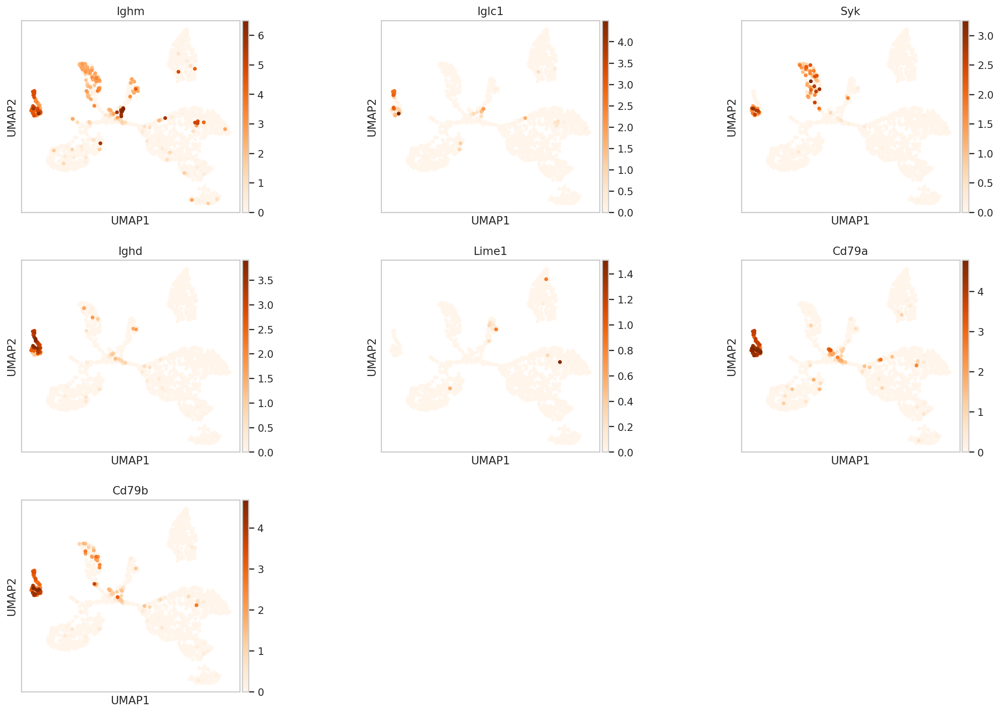

In [56]:
#as noted on geneontology.org
#sc.pl.umap(tissue, color = ['Rag1', 'Rag2','Cd24a','Bcl6','Atm','Foxp1','Dock10','Dpp4','Bax','Prdm1','Traf3ip2','Adgrg3','Atp11c', 'Bak1','Plcl2'], wspace= 0.5, color_map= 'Oranges', ncols= 3)

sc.pl.umap(tissue, color = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b'], wspace= 0.5, color_map= 'Oranges', ncols= 3)



### Interferon genes

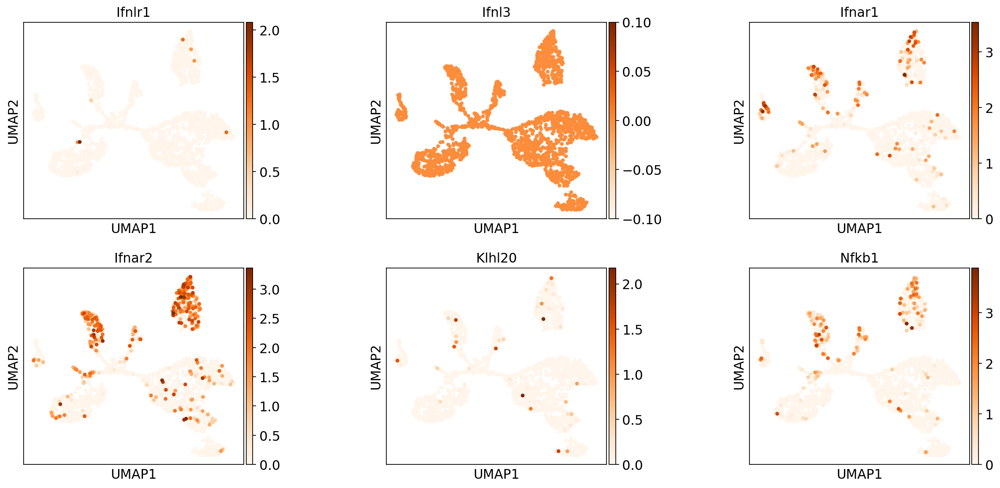

In [27]:
sc.pl.umap(tissue, color = ['Ifnlr1','Ifnl3','Ifnar1','Ifnar2','Klhl20','Nfkb1'], wspace= 0.5, color_map= 'Oranges', ncols= 3)
#Ifnl3 is interferon lambda
#Ifnlr1 is interferon lambda receptor 
#Ifnar1 IFN-a and -b receptor
#Ifnar2 IFN-a and -b receptor
#Klhl20 IFN gamma binding
#Nfkb1 is Nf-kb

### Macropahge proliferation genes

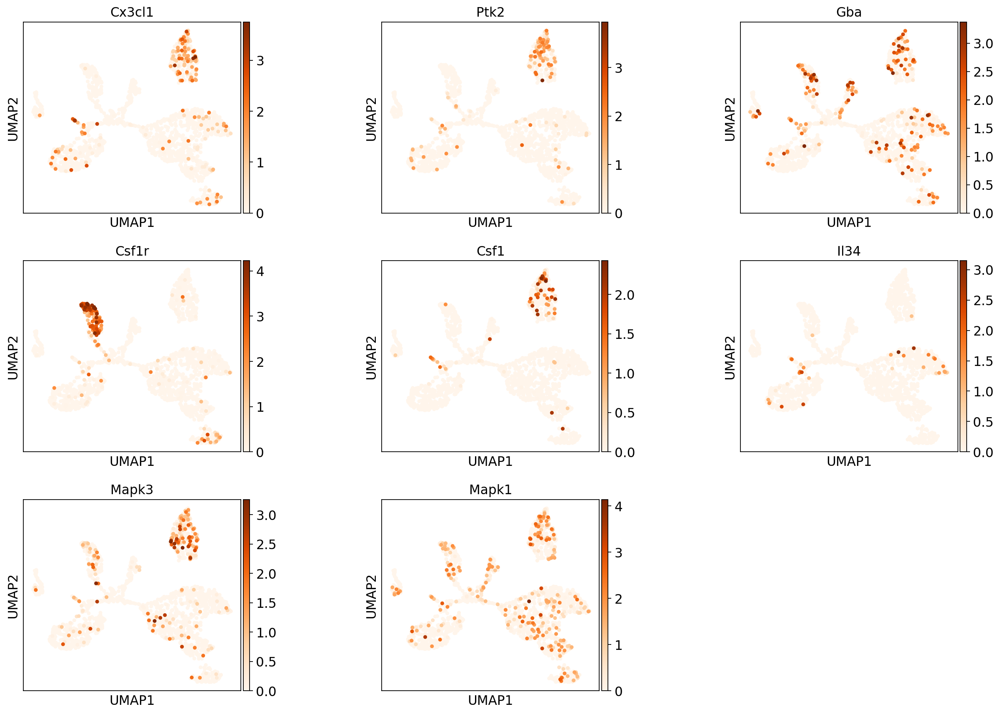

In [28]:
sc.pl.umap(tissue, color = ['Cx3cl1','Ptk2','Gba','Csf1r','Csf1','Il34','Mapk3','Mapk1'], wspace= 0.5, color_map= 'Oranges', ncols= 3)

### 'Iglc3','Iglc2','Igkc'

Highly expressed in B cells and Plasma cells, less so in T cells, not macrophages

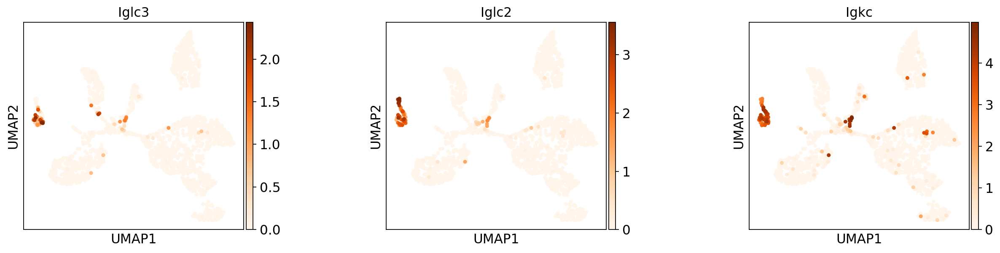

In [29]:
sc.pl.umap(tissue, color = ['Iglc3','Iglc2','Igkc'], wspace= 0.5, color_map= 'Oranges', ncols= 3)


### 'Cd79a','Cd79b','Cd37'

"CD37 is a tetraspanin expressed prominently on the surface of B cells" (https://pubmed.ncbi.nlm.nih.gov/33333768/)

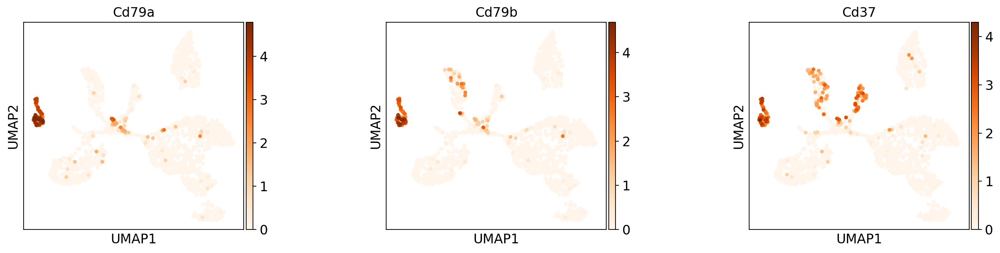

In [30]:
sc.pl.umap(tissue, color = ['Cd79a','Cd79b','Cd37'], wspace= 0.5, color_map= 'Oranges')

### Macrophage M1/M2 polarization, Yunna et al. 2020

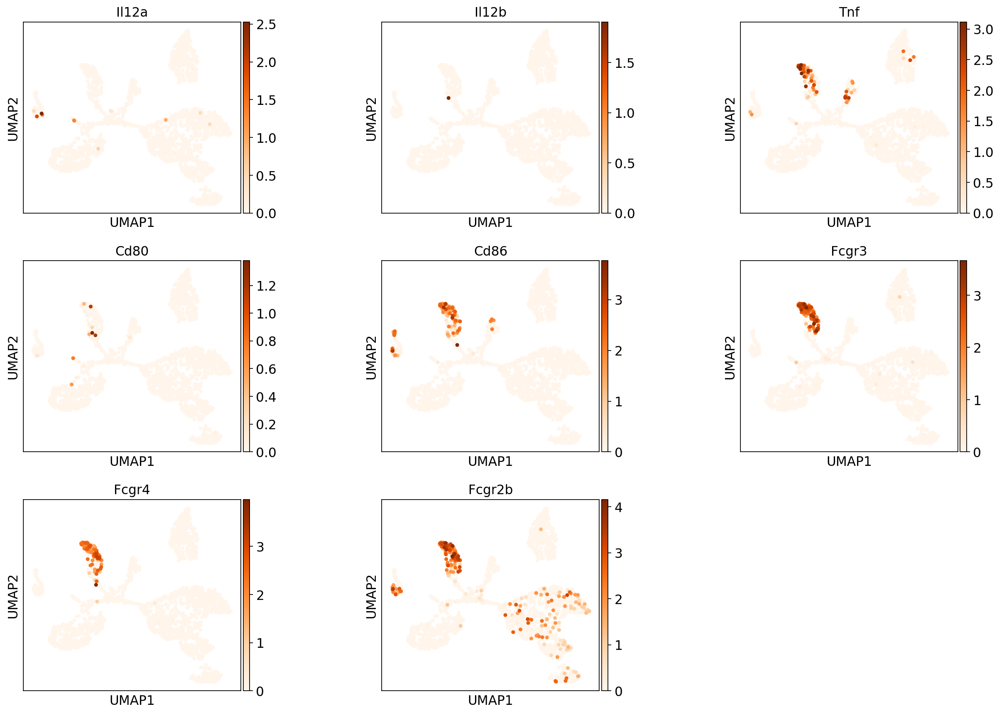

In [19]:
#M1
sc.pl.umap(tissue, color = ['Il12a','Il12b',
                            'Tnf','Cd80','Cd86',
                            'Fcgr3','Fcgr4','Fcgr2b'], wspace= 0.5, color_map= 'Oranges',ncols = 3,
          save = 'kidney_Macrophage_M1_M2_polarization_Yunna_et_al_2020_05192022.png')
#M1 overexpress: Cd80, Cd86, Cd16/32
#Fcgr3 is Cd16. Fcgr4 similar?
#Fcgr2b is Cd32

#M1 produce Il-12, Il-6, Tnf

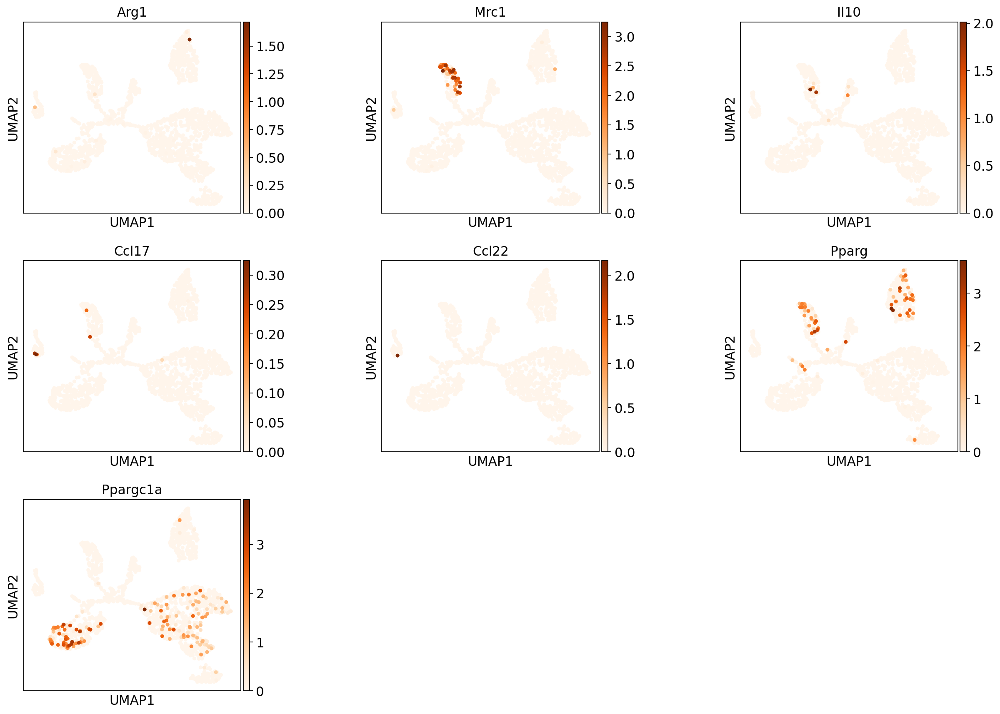

In [33]:
#M2, leiden 10?
sc.pl.umap(tissue, color = ['Arg1','Mrc1','Il10',
                            'Ccl17','Ccl22', 'Pparg',
                           'Ppargc1a'], wspace= 0.5, color_map= 'Oranges',ncols = 3)

#M2 overexpress: 'Arg1','Mrc1','Il10','Ccl17','Ccl22'
#Mrc1 is Cd206, mannose receptor
#Pparg, nuclear transcpxn factor promotes M2, inhibits M1
#Ppargc1a, This protein interacts with PPARgamma, It provides a direct link between external physiological stimuli and the regulation of mitochondrial biogenesis, and is a major factor that regulates muscle fiber type determination.

### Jablonski M1 & M2 marker genes

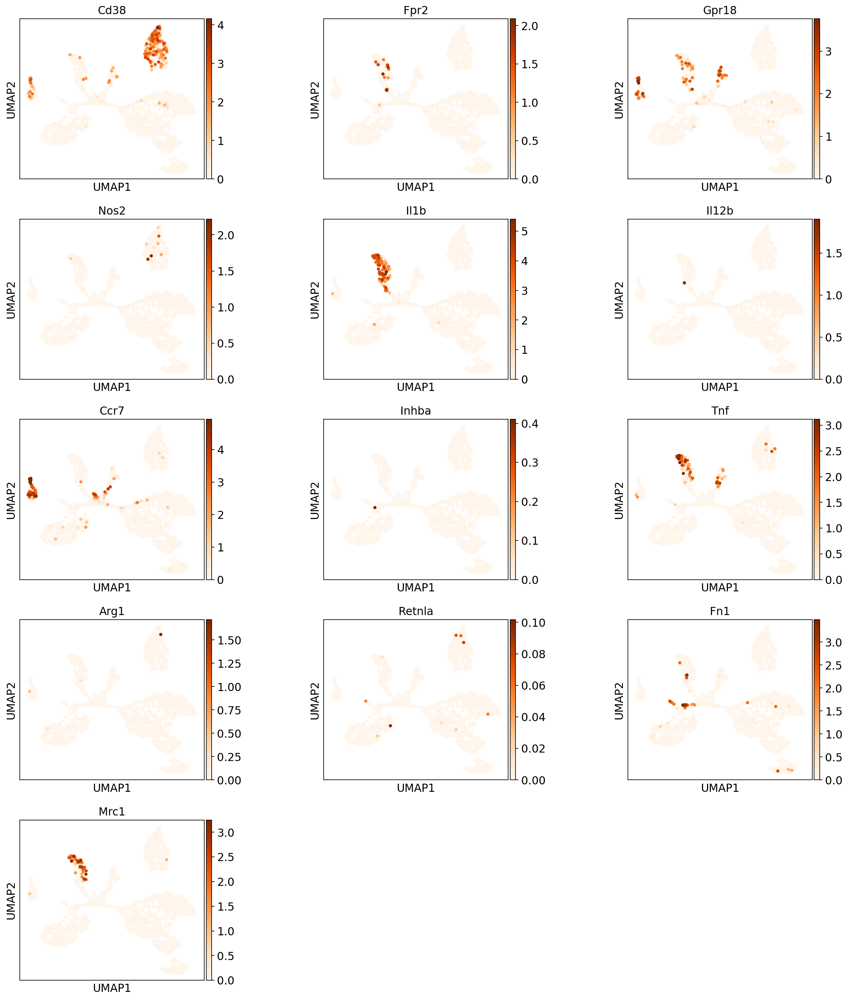

In [37]:
sc.pl.umap(tissue, color = ['Cd38','Fpr2','Gpr18',
                   'Nos2','Il1b','Il12b','Ccr7',
                   'Inhba','Tnf','Arg1','Retnla','Fn1',
                   'Mrc1'], wspace= 0.5, color_map= 'Oranges',ncols = 3)

In [38]:
M1_short = ['Junb','Cebpd','Cav1','Herpud1','Tgm2','Egr1','Il2rg','Dck','Ifitm3','Srgn','Sqstm1','Atf4','Tapbp','Hspa5']

M2_short = ['Egr2','Tns1','Ypel3','Pdcd4','Dnmt1','Gmnn','Rapgef6','Mxi1','H2afv','Nfic','Tsc22d3','AU020206','Dag1','Parp1','Paip2','Erp29','Sash3','Ptpn22','Siva1','Rmnd5a','Selplg','Cdk2ap2','Timp2','Map1lc3b','Ppp2r5c','Cd151','Dusp3','Vamp4','Crip1','Gltp','Ctnnb1','B4galnt1']


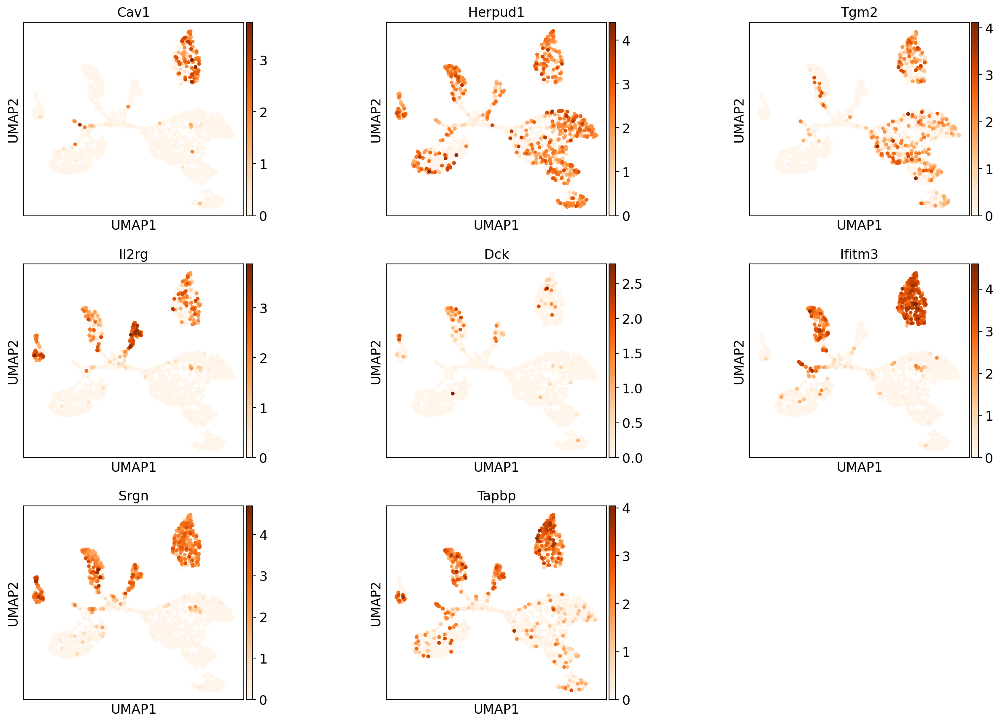

In [20]:
#M1 short
sc.pl.umap(tissue, color = ['Cav1','Herpud1','Tgm2','Il2rg','Dck','Ifitm3','Srgn',
                            'Tapbp'], wspace= 0.5, color_map= 'Oranges',ncols = 3,
          save = 'kidney_Jablonski_M1_marker_genes_05192022.png')

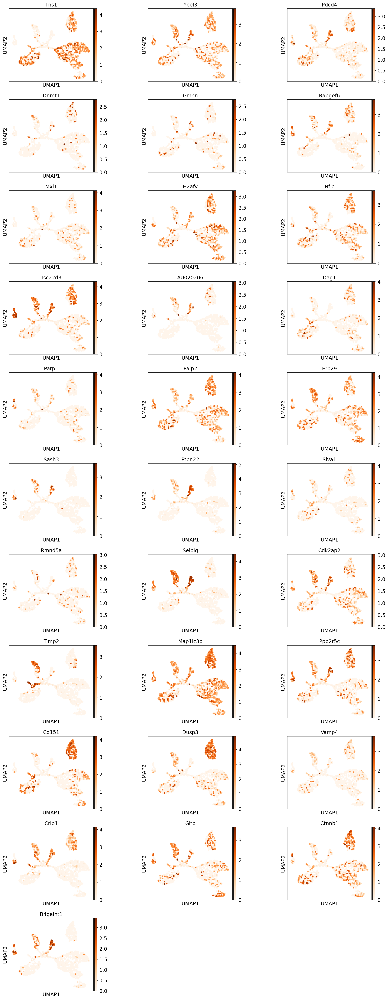

In [21]:
#M2 short

sc.pl.umap(tissue, color = ['Tns1','Ypel3',
                            'Pdcd4','Dnmt1','Gmnn',
                            'Rapgef6','Mxi1','H2afv',
                            'Nfic','Tsc22d3','AU020206',
                            'Dag1','Parp1','Paip2',
                            'Erp29','Sash3','Ptpn22',
                            'Siva1','Rmnd5a','Selplg',
                            'Cdk2ap2','Timp2','Map1lc3b',
                            'Ppp2r5c','Cd151','Dusp3',
                            'Vamp4','Crip1','Gltp',
                            'Ctnnb1','B4galnt1'], wspace= 0.5, color_map= 'Oranges',ncols = 3,
          save = 'kidney_Jablonski_M2_marker_genes_05192022.png')

# Lists

In [3]:
mitocarta3_path = "/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/Mouse_mt_genes.csv"
mitocarta3_df = pd.read_csv(mitocarta3_path)
mt_nc_genes = list(mitocarta3_df['Symbol'])

mitocarta_remove = ["mt-Atp6",
                    "mt-Atp8",
                    "mt-Co1",
                    "mt-Co2",
                    "mt-Co3",
                    "mt-Cytb",
                    "mt-Nd1",
                    "mt-Nd2",
                    "mt-Nd3",
                    "mt-Nd4",
                    "mt-Nd4l",
                    "mt-Nd5",
                    "mt-Nd6",
                    ]

#removing mt_encoded genes
for m in mitocarta_remove:
    mt_nc_genes.remove(m)

In [4]:
mt_genes = [
    "mt-Atp6",
    "mt-Atp8",
    "mt-Co1",
    "mt-Co2",
    "mt-Co3",
    "mt-Cytb",
    "mt-Nd1",
    "mt-Nd2",
    "mt-Nd3",
    "mt-Nd4",
    "mt-Nd4l",
    "mt-Nd5",
    "mt-Nd6",
    "mt-Rnr1",
    "mt-Rnr2",
    "mt-Ta",
    "mt-Te",
    "mt-Tf",
    "mt-Ti",
    "mt-Tl1",
     "mt-Tl2",
    "mt-Tm",
    "mt-Tp",
    "mt-Tq",
    "mt-Tt",
    "mt-Tv"
] 

In [5]:
OXPHOS = ['CYC1','SDHB','SDHA','UQCRC1','COX5A','UQCRFS1',
          'ATP5F1A','UQCRC2','SDHD','UQCRQ','NDUFS1','ATP5F1E','ATP5F1B',
          'UQCR10','UQCRH','ATP5PO','COX6A1','NDUFS7','ATP5ME','NDUFV2',
          'ATP5PF','NDUFB8','NDUFS8','NDUFS2','NDUFV1','SDHC','NDUFB5',
          'COX6C','NDUFB9','NDUFA6','COX6B1','NDUFS4','NDUFA9','ATP5F1C',
          'COX4I1','NDUFS6','COX5B','NDUFA5','NDUFB6','NDUFB10','NDUFA2',
          'NDUFS5','CYCS','COX7A2','HCCS','NDUFA7','NDUFB2','ATP5IF1','ATP5PB',
          'COX7C','COX7A1','NDUFA12','NDUFA10','NDUFC2','NDUFA8','NDUFB11',
          'NDUFV3','UQCRB','ATP5PD','ATP5MG','ATP5MC3','COX6A2','NDUFAB1',
          'NDUFS3','NDUFB7','COX8A','NDUFC1','NDUFA3','NDUFB3','NDUFA4',
          'NDUFA13','COX7B','NDUFA11','ATP5MPL','COX6B2','COX4I2','ATP5MF',
          'COX8C','NDUFB4','UQCR11','NDUFA1','COX7A2L','ATP5MC1','ATP5MC2',
          'DMAC2L','ATP5MD','COX7B2','NDUFB1']
oxphos = []
for o in OXPHOS:
    p = o.lower()
    q = p.title()
    oxphos.append(q)
    
missed = ['Cox5A', 'Atp5F1A', 'Atp5F1E', 'Atp5F1B', 'Atp5Po', 'Cox6A1', 'Atp5Me', 
          'Atp5Pf', 'Cox6C', 'Cox6B1', 'Atp5F1C', 'Cox4I1', 'Cox5B', 'Cox7A2', 
          'Atp5If1', 'Atp5Pb', 'Cox7C', 'Cox7A1', 'Atp5Pd', 'Atp5Mg', 'Atp5Mc3', 
          'Cox6A2', 'Cox8A', 'Cox7B', 'Atp5Mpl', 'Cox6B2', 'Cox4I2', 'Atp5Mf', 'Cox8C', 
          'Cox7A2L', 'Atp5Mc1', 'Atp5Mc2', 'Dmac2L', 'Atp5Md', 'Cox7B2', 'Ndufb1']

for m in missed:
    oxphos.remove(m)

Genes not in adata.vars

In [6]:
#sc.tl.score_genes_cell_cycle ignored these genes since they're not in .vars
ignored = ['Oxnad1','Gatd3a', 'Micos10', 'Fdx2', 'Mmut', 'Atp5pb', 'Mtarc2', 'Micos13', 'Mtres1', 'Coa8', 
           'Tmlhe', 'Mtarc1', 'Prxl2a', 'Marchf5', 'Dmac2l','Gatd3a', 'Micos10','Hspe1','Atp5pb', 'Mtarc2', 
           'Mtres1', 'Coa8', 'Tmlhe', 'Mtarc1', 'Idi1','Mcl1', 'Antkmt', 'Noct', 'Atpsckmt', 'Septin4', 
           'Prorp', 'Htd2', 'Pigbos1','Atp5md']


Mitocarta3.0 nuclear genes combined with mitochondrial genes

In [7]:
mt_nc = mt_genes + mt_nc_genes

In [8]:
tis_cells = list(set(tissue.obs['cell_ontology_class']))
ages = ['3m','18m','24m']

In [9]:
bcr = ['Ighm','Iglc1','Syk','Ighd','Lime1', 'Cd79a','Cd79b']


# GSEA test run

Testing out GSEA code. Results are not to be used. See Notebook 5 (04192022 GSEA) for actual results.

In [56]:
from gseapy.plot import barplot, dotplot
from gseapy.plot import gseaplot

In [57]:
def pd_dictionary(listy, column_header):
    '''Creates a simple panda dataframe from a list.
    Input list and 'column header'. Returns a pandas dataframe. '''
    
    data = defaultdict(list)
    
    for l in listy:
        data[column_header].append(l)
            
    df = pd.DataFrame(data)
    return df

In [58]:
oxphos_df = pd_dictionary(oxphos,'Gene')

In [59]:
enr = gp.enrichr(gene_list=oxphos,
                 gene_sets=['WikiPathways_2019_Mouse','KEGG_2016'],
                 organism='Mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 description='test_name',
                 outdir='test/enrichr_kegg',
                 #no_plot=True,
                 cutoff=0.5 # test dataset, use lower value from range(0,1)
                )

enr.results

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,WikiPathways_2019_Mouse,Electron Transport Chain WP295,45/103,1.609049e-100,1.287239e-99,0,0,2204.556650,5.065693e+05,NDUFB9;NDUFB7;NDUFB6;NDUFB10;UQCRB;NDUFB5;NDUF...
1,WikiPathways_2019_Mouse,Oxidative phosphorylation WP1248,30/62,2.945028e-65,1.178011e-64,0,0,848.693182,1.261055e+05,NDUFB9;NDUFB8;NDUFB7;NDUFB6;NDUFB10;NDUFA11;ND...
2,WikiPathways_2019_Mouse,TCA Cycle WP434,4/31,1.213417e-06,3.235780e-06,0,0,61.484568,8.375471e+02,SDHC;SDHD;SDHA;SDHB
3,WikiPathways_2019_Mouse,Amino Acid metabolism WP662,2/95,2.538141e-02,5.076281e-02,0,0,8.539785,3.137294e+01,SDHD;SDHA
4,WikiPathways_2019_Mouse,Parkinsons Disease Pathway WP3638,1/39,9.663482e-02,1.382357e-01,0,0,10.273478,2.400723e+01,CYCS
5,WikiPathways_2019_Mouse,Oxidative Damage WP1496,1/42,1.036768e-01,1.382357e-01,0,0,9.520325,2.157760e+01,CYCS
6,WikiPathways_2019_Mouse,p53 signaling WP2902,1/67,1.603039e-01,1.832044e-01,0,0,5.906714,1.081333e+01,CYCS
7,WikiPathways_2019_Mouse,EGFR1 Signaling Pathway WP572,1/178,3.721583e-01,3.721583e-01,0,0,2.190207,2.164879e+00,NDUFA13
8,KEGG_2016,Parkinson's disease Homo sapiens hsa05012,51/142,4.731777e-113,1.135627e-111,0,0,11128.648352,2.878289e+06,NDUFA13;NDUFA11;NDUFA12;NDUFA10;UQCRFS1;NDUFC2...
9,KEGG_2016,Non-alcoholic fatty liver disease (NAFLD) Homo...,51/151,2.195157e-111,2.634188e-110,0,0,10122.480000,2.579215e+06,NDUFA13;NDUFA11;NDUFA12;NDUFA10;UQCRFS1;NDUFC2...


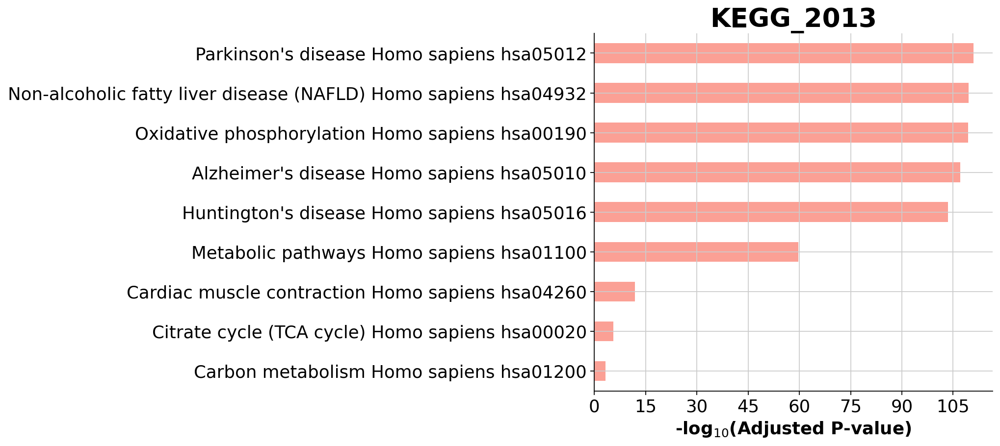

In [60]:
barplot(enr.res2d,title='KEGG_2013')
# to save your figure, make sure that ``ofname`` is not None

<AxesSubplot:title={'center':'KEGG_2013'}, xlabel='-log$_{10}$(Adjusted P-value)'>

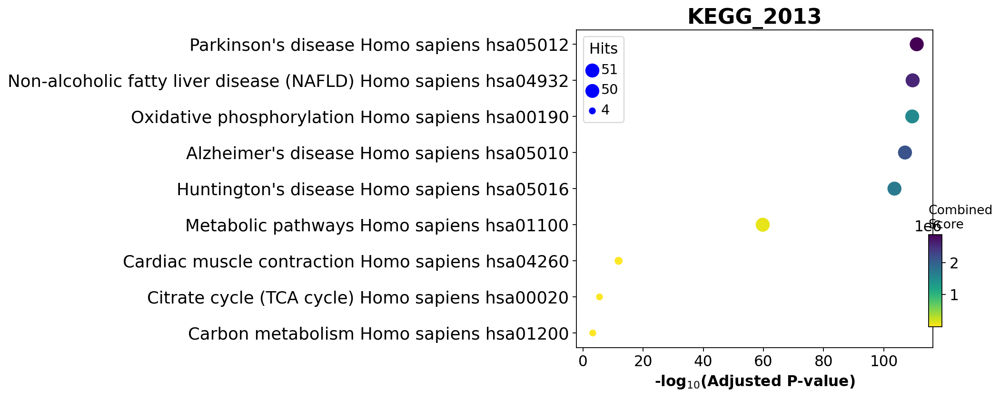

In [61]:
dotplot(enr.res2d, title='KEGG_2013',cmap='viridis_r')

# leiden plots

## Kidney

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


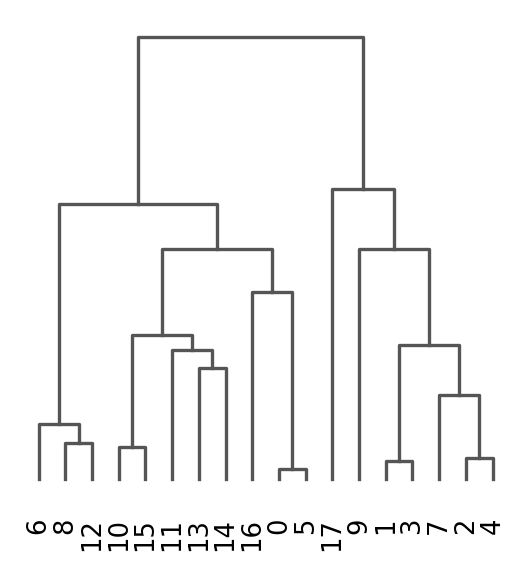

<AxesSubplot:>

In [62]:
sc.tl.dendrogram(tissue, groupby = 'leiden')
sc.pl.dendrogram(tissue, groupby = 'leiden')

### leiden 14 cluster (B cell)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5


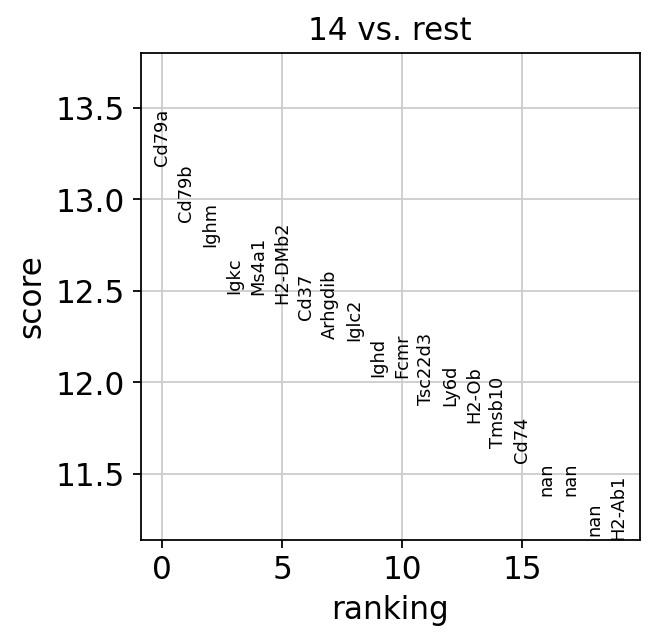

categories: 0, 1, 2, etc.
var_group_labels: 14


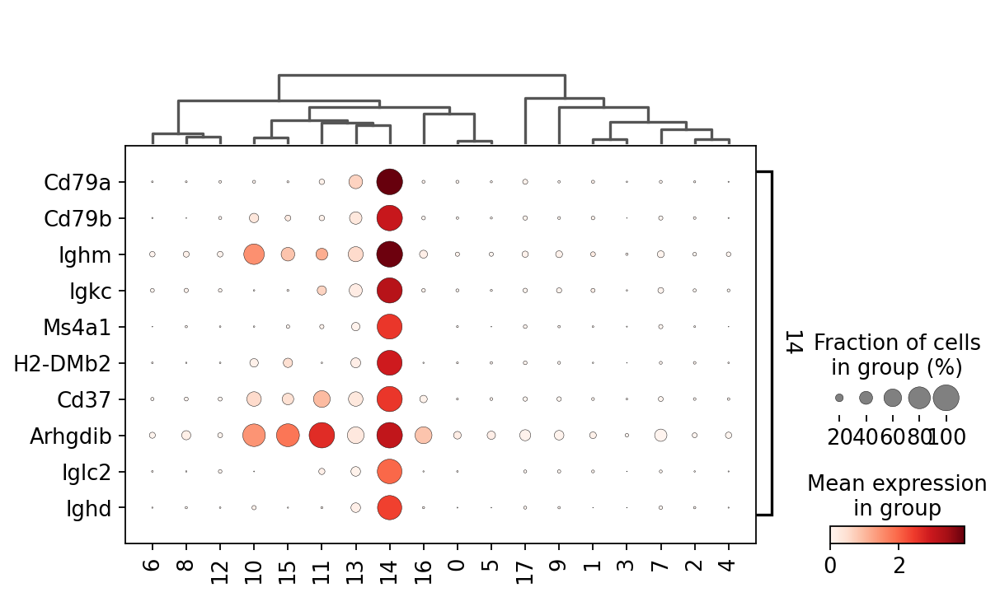

In [64]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['14'], method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=2)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)


### leiden 10 cluster vs leiden 15 cluster (macrophages)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5


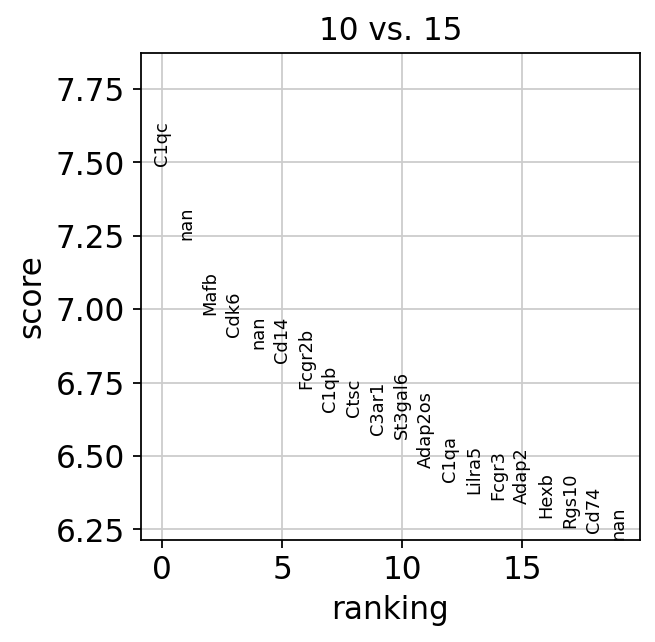

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: 10


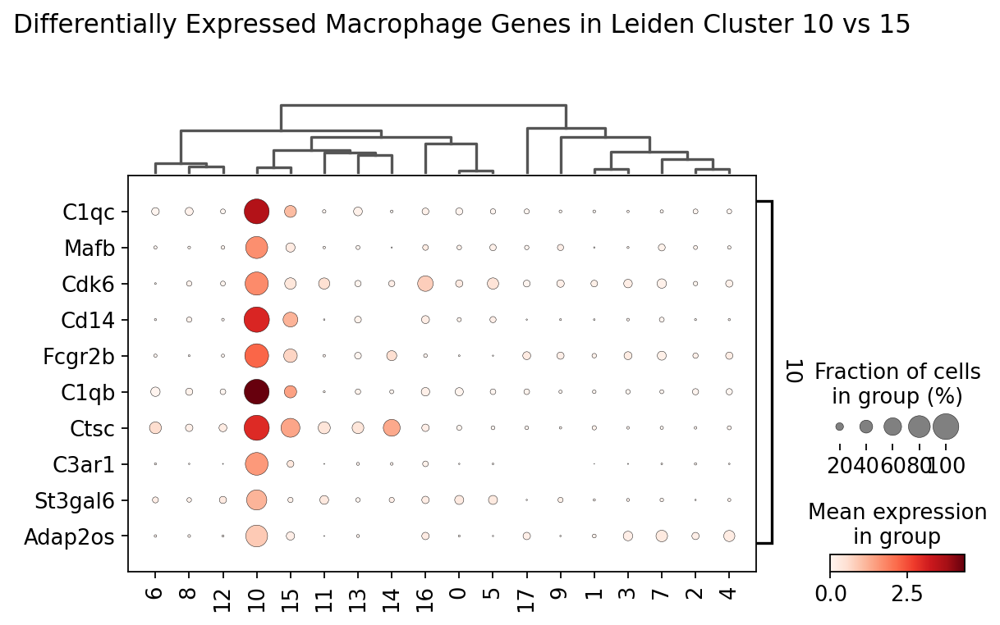

In [30]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['10'], reference='15', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=2)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True, 
                               title = 'Differentially Expressed Macrophage Genes in Leiden Cluster 10 vs 15',
                               save = 'kidney_macrophage_cluster10v15_rankegenes_05192022.png')


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5


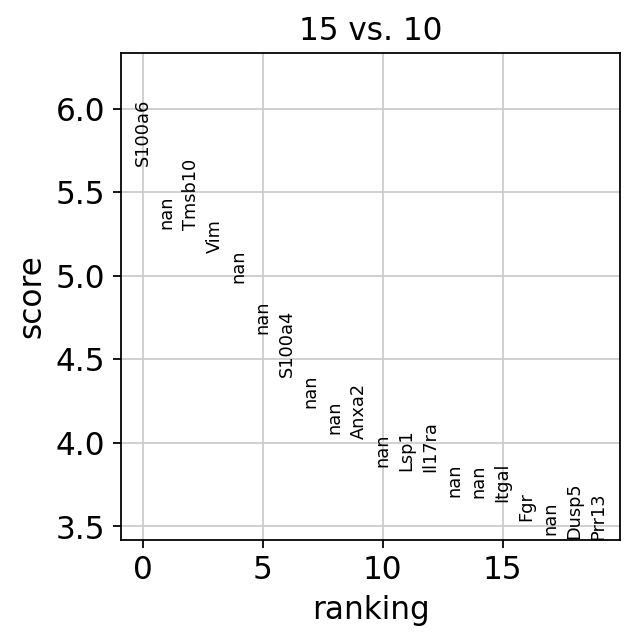

categories: 0, 1, 2, etc.
var_group_labels: 15


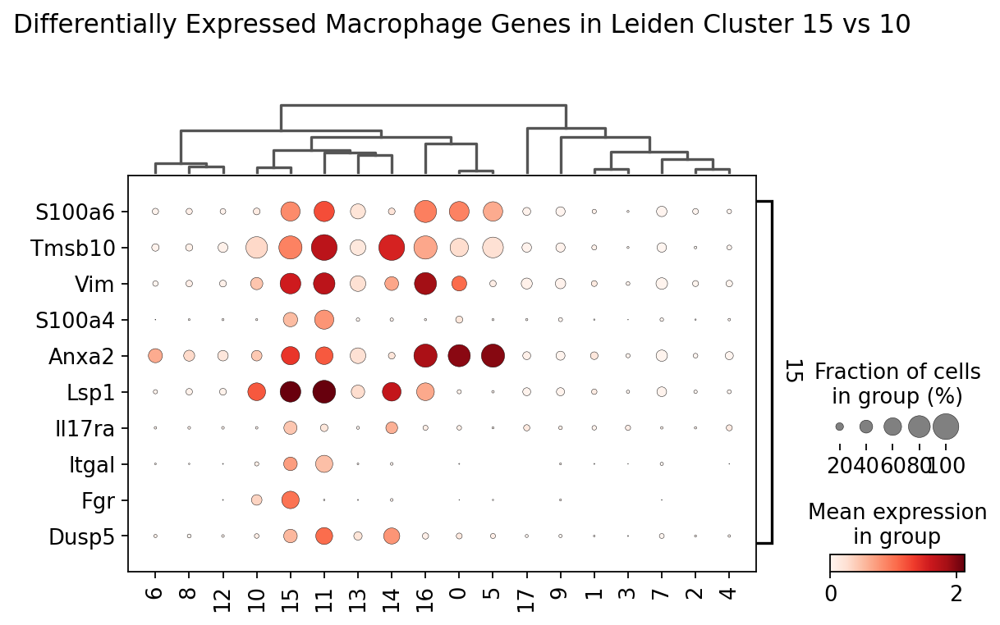

In [32]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['15'], reference='10', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=2)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True,
                               title = 'Differentially Expressed Macrophage Genes in Leiden Cluster 15 vs 10',
                               save = 'kidney_macrophage_cluster15v10_rankegenes_05192022.png')



### leiden 14 (B cell) vs 15 (macrophage)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


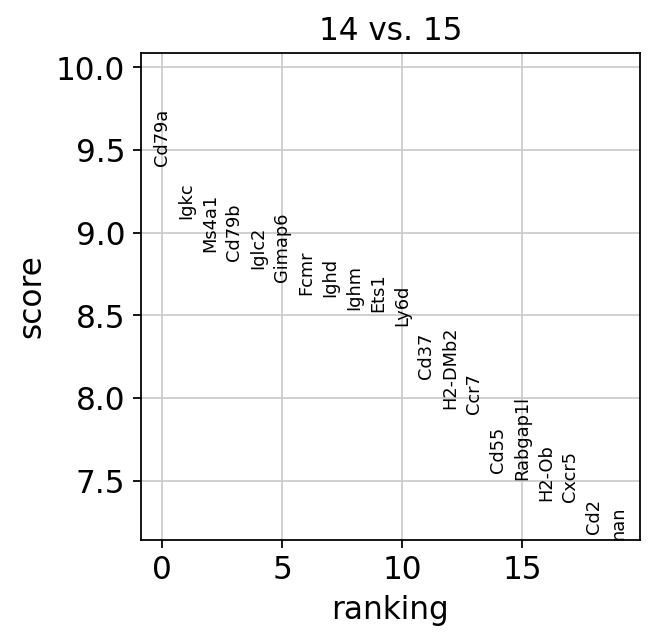

categories: 0, 1, 2, etc.
var_group_labels: 14


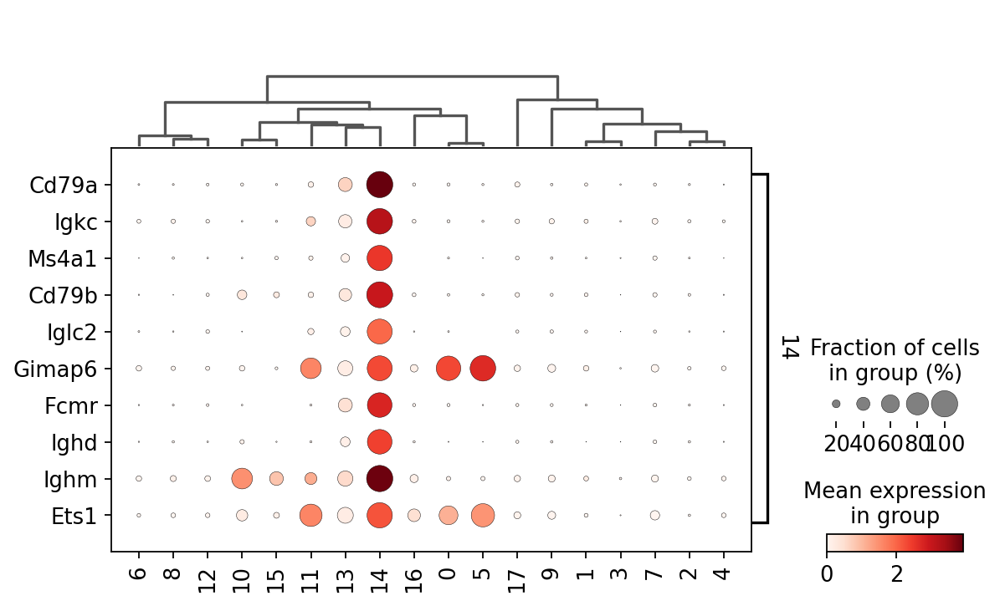

In [68]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['14'], reference='15', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=3)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)

###  leiden 14 (B cell) vs 11 (T cells)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


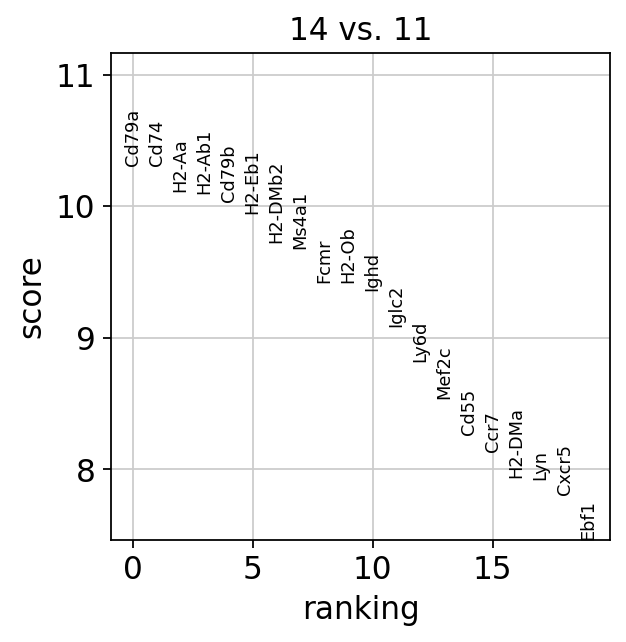

categories: 0, 1, 2, etc.
var_group_labels: 14


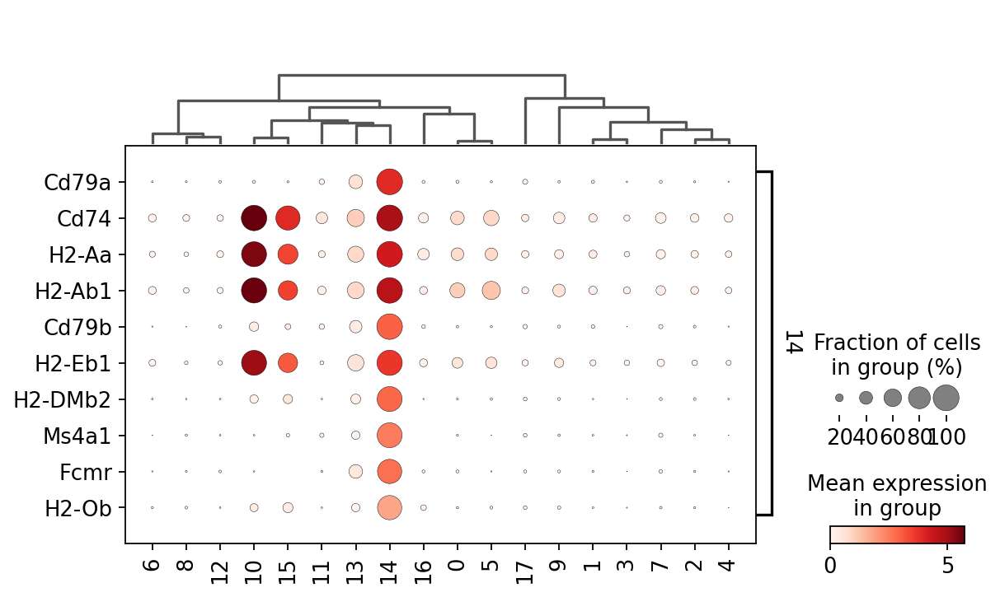

In [69]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', groups = ['14'], reference='11', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=3)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)

### all leiden vs rest

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 3, max_out_group_fraction: 0.5


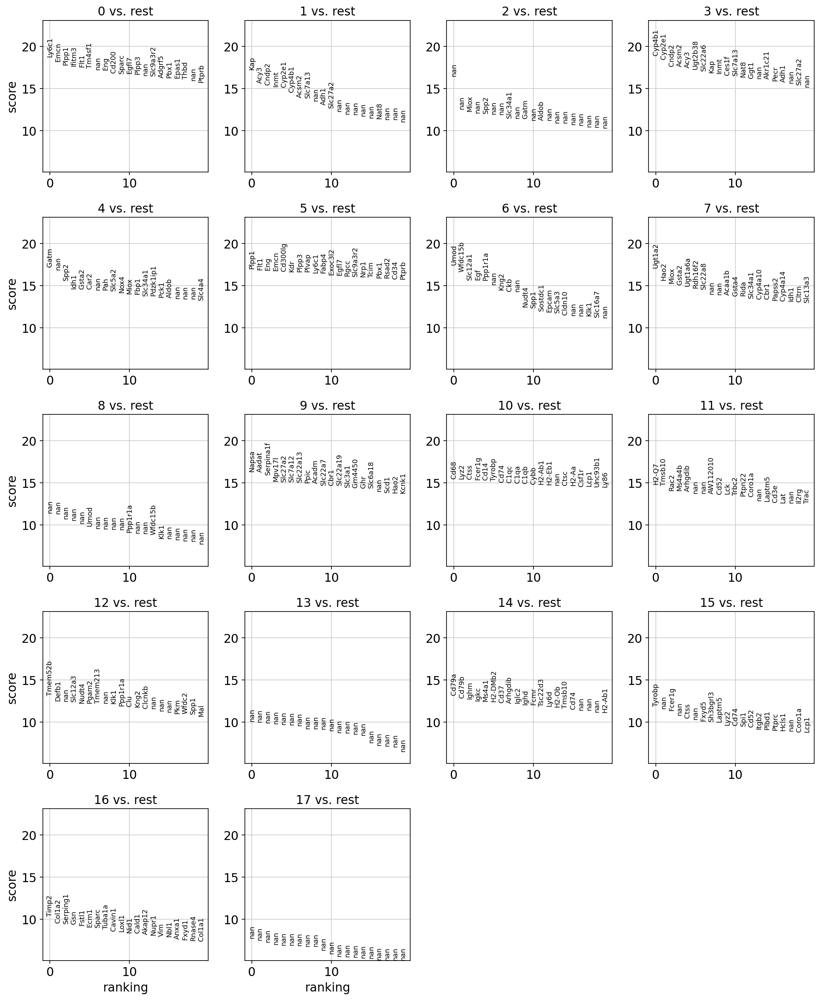

categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


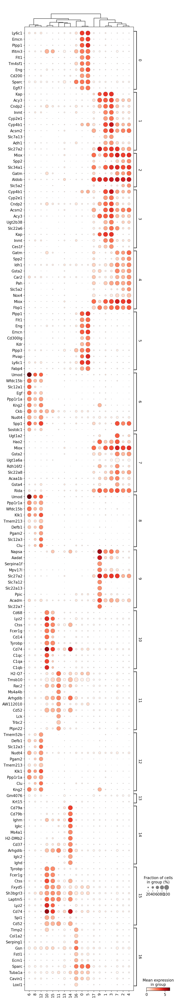

In [70]:
sc.tl.rank_genes_groups(tissue, groupby = 'leiden', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(tissue, min_fold_change=3)
sc.pl.rank_genes_groups(tissue, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(tissue, key='rank_genes_groups_filtered', swap_axes=True)

# Plots

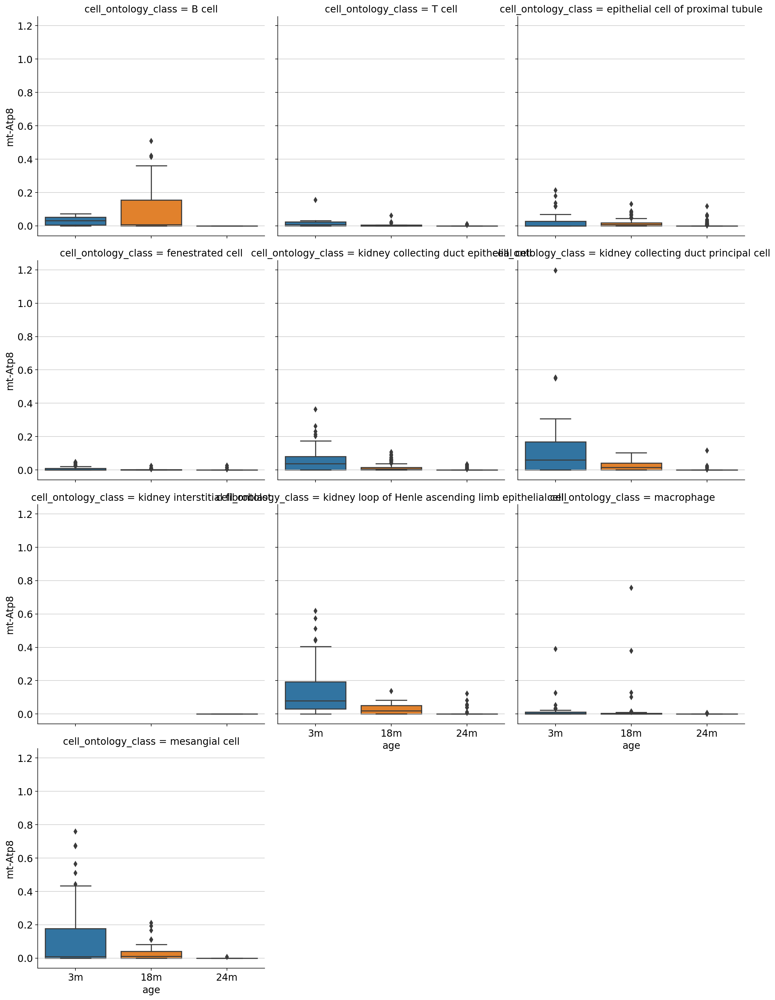

In [71]:
''' [] cells expressing [] gene across ages'''
g = tissue[:,'mt-Atp8'].copy() #only has this gene
#g = g[g.obs.cell_ontology_class=='B cell'].copy() 
g.obs['mt-Atp8']=g[:,'mt-Atp8'].X.toarray().flatten() 
g = g.obs.copy()

sns.catplot(data = g, x='age', y = 'mt-Atp8', col = 'cell_ontology_class',col_wrap=3, kind = 'box')

# Characterize cell proportions across ages

In [5]:
from collections import defaultdict

def cell_per_tissue(celltypelist, adata):
    ''' Input is cell type list. Output is a pandas DataFrame 
    of the percentage of that cell type for inputted subsetted adata tissue object'''
    
    data = defaultdict(list)
    
    for a in ages:
        b = adata[adata.obs['age']== a]#filter by age
        for e in celltypelist:#going through keys/tissue types       
            c = b[b.obs['cell_ontology_class']== e]#have adata filtered by cell types in list
            tissue_cell_count = adata.n_obs
            data["Age"].append(a)
            data["Cell Type"].append(e)
            data["Cell Count"].append(c.n_obs)
            data["Cell Type/Tissue %"].append((c.n_obs/b.n_obs)*100)
            
    df = pd.DataFrame(data)
    return df

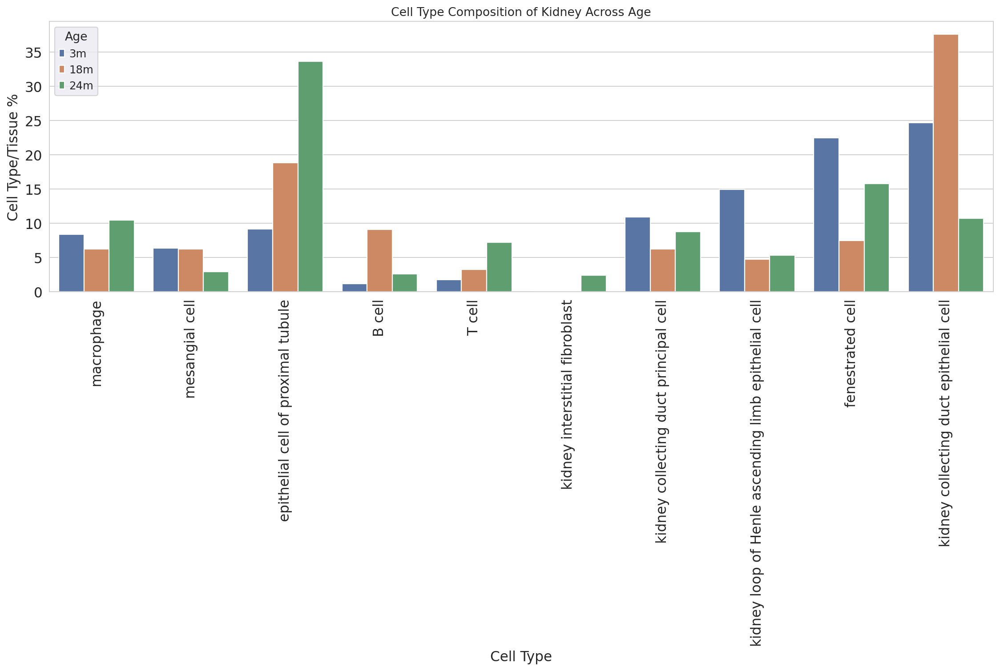

In [15]:
df = cell_per_tissue(tis_cells,tissue)

sns.set_style('whitegrid')
fig = plt.figure(figsize=(17, 5))
plt.xticks(rotation=90)
sns.set(font_scale =1)
sns.barplot(data=df, y="Cell Type/Tissue %", x="Cell Type", hue = "Age").set(title="Cell Type Composition of Kidney Across Age")
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/cell_type_percents_kidney_05192022', dpi=150,bbox_inches='tight')


In [16]:
mouse_ids = list(set(tissue.obs['mouse.id']))

In [17]:
from collections import defaultdict

def cell_per_tissue2(a_list, adata):
    ''' Input is list and adata tissue object. Output is a pandas DataFrame 
    of the percentage of that cell type for inputted subsetted adata tissue object'''
    
    data = defaultdict(list)
    
    for a in a_list:
        b = adata[adata.obs['mouse.id']== a]#filter by mouse
        for c in tis_cells:       
            d = b[b.obs['cell_ontology_class']== c]#have adata filtered by cell types in list
            tissue_cell_count = b.n_obs
            
            data["mouse.id"].append(a)
            data["Cell Type"].append(c)
            data["Cell Count"].append(d.n_obs)
            data["Cell Type/Tissue %"].append((d.n_obs/b.n_obs)*100)
            
    df = pd.DataFrame(data)
    return df

In [18]:
df2=cell_per_tissue2(mouse_ids,tissue)

In [19]:
df2.groupby(["mouse.id"])[["Cell Type/Tissue %"]].sum()#don't think i need
dd = df2.groupby(["mouse.id", "Cell Type"]).sum()

In [20]:
dd = dd.reset_index('Cell Type')

Pivoting pandas DataFrame so that Cell Type column values becomes columns, and Cell Type/Tissue % populate new columns.

In [21]:
tmp = dd.pivot_table(values='Cell Type/Tissue %', columns="Cell Type", index=dd.index)

Reordering mouse.id X axis

In [22]:
mouse_id_order = [
    '3_8_M', 
    '3_9_M',
    '3_11_M', 
    '3_38_F', 
    '3_39_F', 
    '18_45_M', 
    '18_46_F', 
    '18_47_F', 
    '18_53_M', 
    '24_58_M', 
    '24_59_M',
    '24_60_M', 
    '24_61_M', 
]

tmp = tmp.reindex(mouse_id_order)

**Cell Type % of Thymus per Mouse**

<ipython-input-23-4e4e6d487bb0>:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = plt.axes()


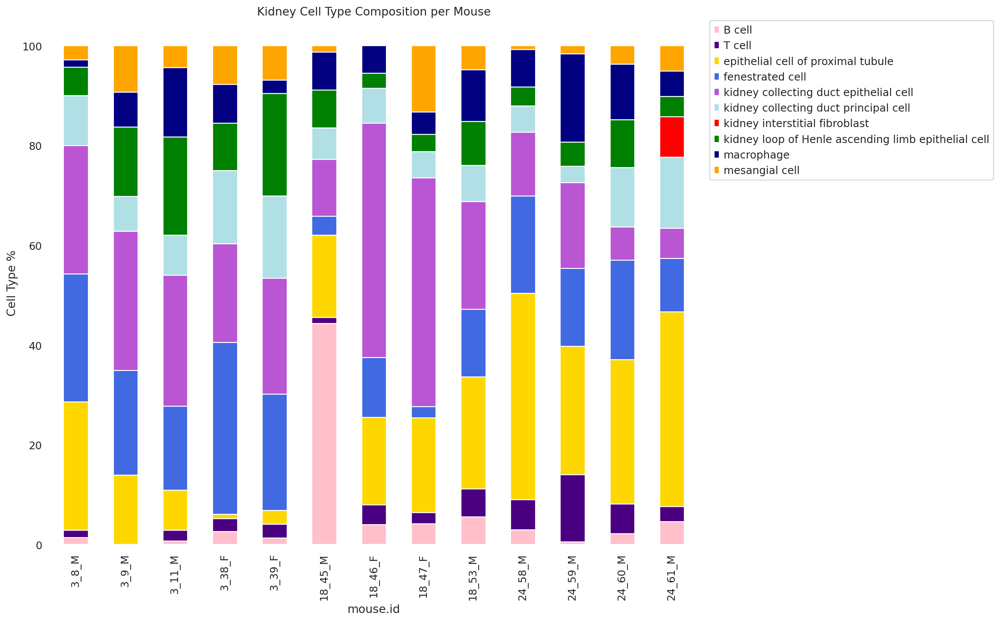

In [23]:
tmp.plot(kind='bar', stacked=True, figsize=(12, 10), color = ['pink','indigo','gold','royalblue','mediumorchid','powderblue','red','green','navy','orange'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, facecolor = 'white')
plt.title("Kidney Cell Type Composition per Mouse")
plt.ylabel('Cell Type %')
ax = plt.axes()
ax.set_facecolor("white")
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_cell_types_per_mouse_05192022', dpi=150,bbox_inches='tight')



**Cell Type % of Thymus by Age**

In [24]:
from collections import defaultdict

def cell_per_age(a_list, adata):
    ''' Input is list and adata tissue object. Output is a pandas DataFrame 
    of the percentage of that cell type by age for inputted subsetted adata tissue object'''
    
    data = defaultdict(list)
    
    for a in a_list:
        b = adata[adata.obs['age']== a]#filter by age
        for c in tis_cells:       
            d = b[b.obs['cell_ontology_class']== c]#have adata filtered by cell types in list
            tissue_cell_count = b.n_obs
            
            data["age"].append(a)
            data["Cell Type"].append(c)
            #data["Cell Count"].append(d.n_obs)
            data["Cell Type/Tissue %"].append((d.n_obs/b.n_obs)*100)
            
    df = pd.DataFrame(data)
    return df

In [25]:
ac = cell_per_age(ages,tissue)

In [26]:
ad = ac.groupby(["age", "Cell Type"]).sum()

In [27]:
ad = ad.reset_index('Cell Type')

In [28]:
ae = ad.pivot_table(values='Cell Type/Tissue %', columns="Cell Type", index=ad.index)
ae = ae.reindex(ages)

<ipython-input-29-74223e77ddc2>:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = plt.axes()


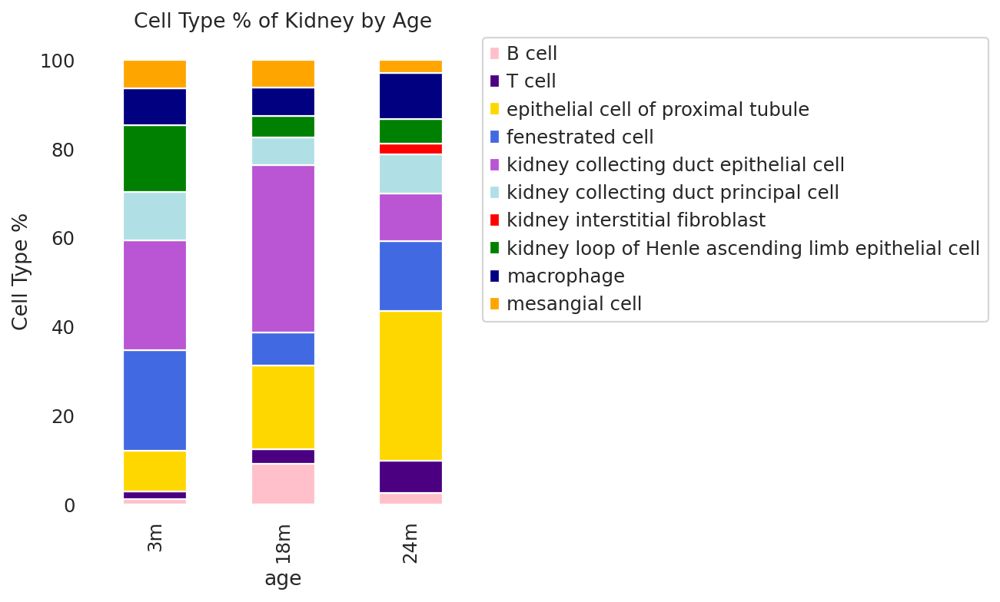

In [29]:
ae.plot(kind='bar', stacked=True, figsize=(4, 5), color = ['pink','indigo','gold','royalblue','mediumorchid','powderblue','red','green','navy','orange'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, facecolor = 'white')
plt.title("Cell Type % of Kidney by Age")
plt.ylabel('Cell Type %')
ax = plt.axes()
ax.set_facecolor("white")
#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_cell_types_by_age_05192022', dpi=150,bbox_inches='tight')



**Variance of Cell Type % of Kidney across Age**

* I'd like to break apart the macrophage cluster (shows two leiden clusters) into two categories and plot

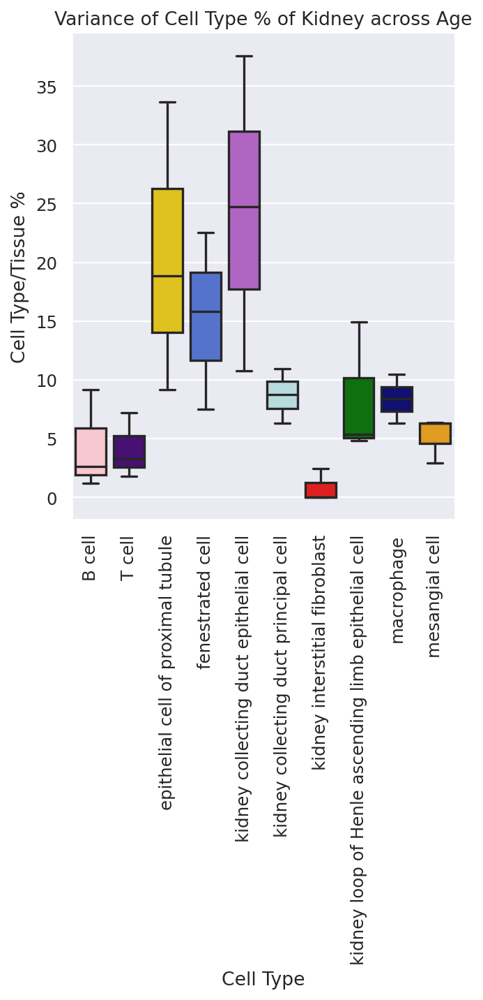

In [30]:
sns.catplot(data = ad, x = 'Cell Type', y = 'Cell Type/Tissue %', kind = "box", palette=sns.color_palette(['pink','indigo','gold','royalblue','mediumorchid','powderblue','red','green','navy','orange']))
plt.title("Variance of Cell Type % of Kidney across Age")
sns.set_style("whitegrid")
plt.xticks(rotation=90);
#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_cell_type_variance_by_age_05192022', dpi=150,bbox_inches='tight')



# Gene expression vars->obs & dataframe

In [10]:
def remove_cats(adata):

    cat_columns = adata.obs.select_dtypes(['category']).columns
    adata.obs[cat_columns] = adata.obs[cat_columns].astype(str)
    
    return adata

## Copy Adata

In [11]:
tissue = remove_cats(tissue)

In [12]:
tissue_copy1 = tissue.copy()

tissue_copy2 = tissue.copy()

tissue_copy3 = tissue.copy()

tissue_copy4 = tissue.copy()


## score_genes

In [155]:
sc.tl.score_genes(tissue_copy1, oxphos, score_name = 'OXPHOS')
tissue_copy1 = remove_cats(tissue_copy1)


computing score 'OXPHOS'
    finished: added
    'OXPHOS', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)


In [13]:
sc.tl.score_genes(tissue_copy2, mt_genes, score_name = 'MT_GENES')
tissue_copy2 = remove_cats(tissue_copy2)


computing score 'MT_GENES'
    finished: added
    'MT_GENES', score of gene set (adata.obs).
    450 total control genes are used. (0:00:00)


In [157]:
sc.tl.score_genes(tissue_copy3, mt_nc_genes, score_name = 'NC_MT_GENES')
tissue_copy3 = remove_cats(tissue_copy3)


computing score 'NC_MT_GENES'
    finished: added
    'NC_MT_GENES', score of gene set (adata.obs).
    721 total control genes are used. (0:00:00)


In [158]:
sc.tl.score_genes(tissue_copy4, bcr, score_name = 'BCR')
tissue_copy4 = remove_cats(tissue_copy4)

computing score 'BCR'
    finished: added
    'BCR', score of gene set (adata.obs).
    249 total control genes are used. (0:00:00)


To add var gene expression to obs

In [14]:
def gene_expression_obs(adata, listy):
    '''Takes adata object. Returns adata copy with var genes where genes 
    and their expression values are columns in dataframe of adata.'''
    adata2 = adata.copy()
    
    for j in listy:#list(adata2.var.index): took hours & didn't finish
        adata2.obs[j] = adata2[:,j].X.toarray().flatten()
    
    return adata2

To make dataframe from obs gene expression adata

In [15]:
def gene_expression_df(adata, genelist):
    '''Takes adata object and a list of genes. Returns a pandas dataframe 
    where genes and their expression values are columns in dataframe of adata.'''
    df = adata.obs.copy()
    
    for g in genelist:
        df[g] = tissue[:,g].X.toarray().flatten()
    return df   

## Removing genes from MitoCarta gene list that are not in .vars

Only need to do this if going to use "genes" list

In [122]:
genes = list(mt_nc.copy())

for i in range(len(ignored)):
    for i in ignored:
        if i in genes:
            genes.remove(i) 

In [123]:
'''Checking for duplicate genes'''
dupe_genes = []
for g in genes:
    count = genes.count(g)
    if count > 1:
        dupe_genes.append(g)
print(f'There are {len(dupe_genes)} duplicate genes in genes list')

There are 0 duplicate genes in genes list


In [124]:
'''Checking that all MT genes are in genes (mt_nc) list'''

for m in mt_genes:
    if m in genes:
        print(m,'yes')
    else:
        print(m, 'no') 

mt-Atp6 yes
mt-Atp8 yes
mt-Co1 yes
mt-Co2 yes
mt-Co3 yes
mt-Cytb yes
mt-Nd1 yes
mt-Nd2 yes
mt-Nd3 yes
mt-Nd4 yes
mt-Nd4l yes
mt-Nd5 yes
mt-Nd6 yes
mt-Rnr1 yes
mt-Rnr2 yes
mt-Ta yes
mt-Te yes
mt-Tf yes
mt-Ti yes
mt-Tl1 yes
mt-Tl2 yes
mt-Tm yes
mt-Tp yes
mt-Tq yes
mt-Tt yes
mt-Tv yes


## DataFrames

In [16]:
#mitochondria and nuclear-encoded mitochondria (MitoCarta3.0) gene expressions
tissue2 = gene_expression_obs(tissue_copy2, mt_genes)
tissue2 = remove_cats(tissue2)
t2_df = gene_expression_df(tissue2, mt_genes)

In [ ]:
#Run 9.2 cells! mitochondria and nuclear-encoded mitochondria (MitoCarta3.0) gene expressions
tissue3 = gene_expression_df(tissue_copy3, genes)

In [21]:
#BCR genes expressions

tissue4 = gene_expression_obs(tissue_copy4, bcr)
tissue4 = remove_cats(tissue4)
tissueBCR = gene_expression_df(tissue4, bcr)

In [22]:
j = ['Jchain', 'Ighg2b','Cpt1a', 'Slc2a1','Slc2a3', 'Foxo1', 'Immp2l', 'Cd19','Cd27','Cd38']
jchain_kid = gene_expression_obs(tissue, j)
jchain_kid = remove_cats(jchain_kid)
df_kid = gene_expression_df(jchain_kid, j)

In [60]:
p = ['Tmsb10','Lrp1','Psen1','Bace1','Lmtk2','Aplp2','App','Eif2s2','Eif2b3','Eif2b4','Tlr4','Mtor','Srpr','Eif2ak3','Eif4e','Eif2ak2','Eif2s1','Eif2ak4','Eif4ebp1','Eif2a',
     'Eif4g1','Eef1a2','Fmr1','Tufm','Eif4enif1','Eif2b2'] #App
tissue_copy6 = tissue.copy()

p1 = gene_expression_obs(tissue_copy6, p)
p1 = remove_cats(p1)
df_p = gene_expression_df(p1, j)


## leiden cluster breakdown

Only the clusters that have annotated B cells present

In [ ]:
leiden14 = tissue[tissue.obs['leiden']=='14']
l = pd.crosstab(leiden14.obs['cell_ontology_class'],leiden14.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden12 = tissue[tissue.obs['leiden']=='12']
l = pd.crosstab(leiden12.obs['cell_ontology_class'],leiden12.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden13 = tissue[tissue.obs['leiden']=='13']
l = pd.crosstab(leiden13.obs['cell_ontology_class'],leiden13.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
leiden16 = tissue[tissue.obs['leiden']=='16']
l = pd.crosstab(leiden16.obs['cell_ontology_class'],leiden16.obs['age'], normalize='index')
l.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

In [ ]:
tmp = pd.crosstab(tissue.obs['leiden'],tissue.obs['cell_ontology_class'], normalize='index')
tmp.plot.bar(stacked=True).legend(loc='upper left')
plt.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0, facecolor = 'white')

## MT and MitoCarta score_genes

**Save MT score_genes result** (unhash if doing for the first time)

* score_genes_cell_cycle(adata, s_genes, g2m_genes)
* mt_genes -> s_genes
* mt_nc_genes -> g2m_genes

A function to make a dataframe of gene_scores and gene expression score by cell

In [48]:
def cell_gene_exp_df(adata, gene):
    ''' Input is gene name that has an obs.gene_score. 
    Output is a pandas DataFrame with two columns: cell index and gene's gene_score'''
    
    data = defaultdict(list)
    
    for d in list(adata.obs['cell']):
        data["Cell"].append(d)
        
        cg = adata[adata.obs.cell == d, adata.var.index == gene]
        data["Gene Expression"].append(cg.X[0,0]) 
    
    #for g in list(adata.obs[gene]):
    #    data["gene_score"].append(g)
       
    df = pd.DataFrame(data)
    return df

# Statistics tests on gene expression

Need to run **8 Gene expression vars -> obs & dataframe** first

## statannot plots

### OXPHOS score_genes

In [83]:
oxphos_df = gene_expression_df(tissue_copy1, oxphos)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.290e-01 U_stat=5.400e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.940e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.800e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.400e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.127e-08 U_stat=1.937e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

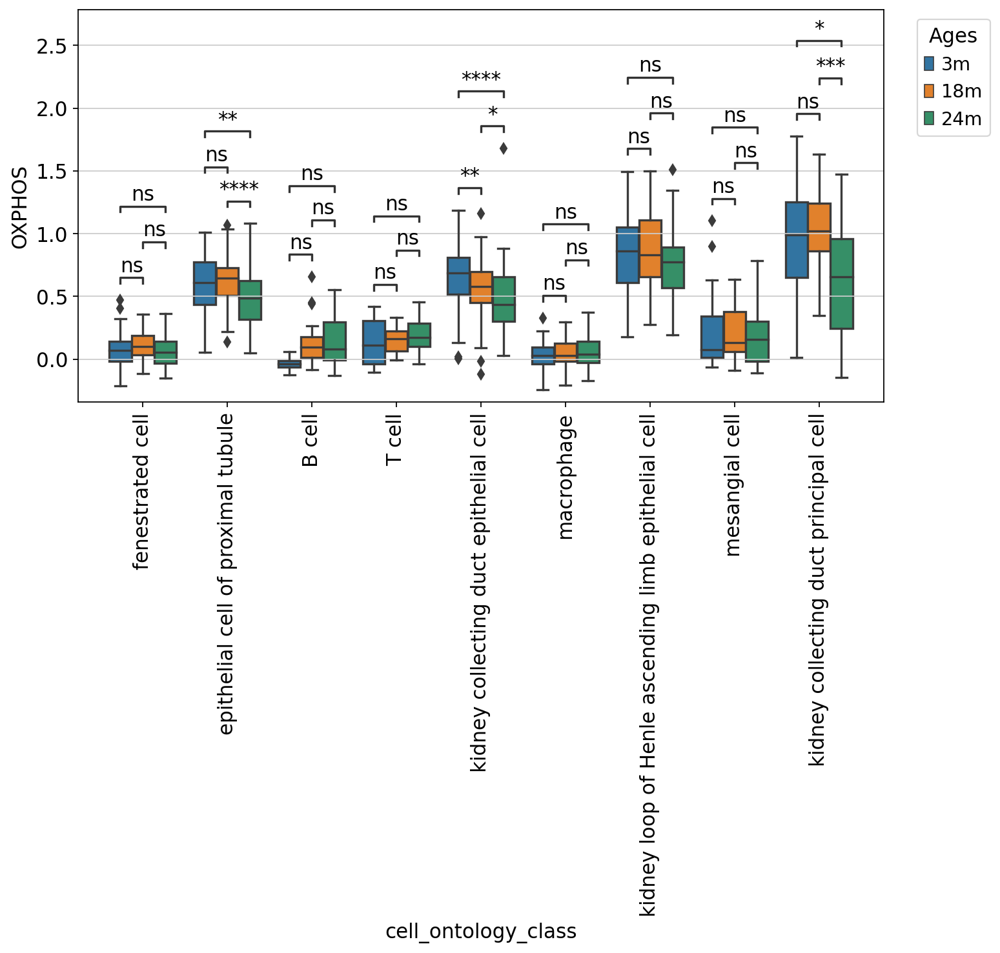

In [84]:
#df = tissue_copy1.obs[[ 'age','cell_ontology_class','OXPHOS']]
df = oxphos_df
df[[ 'age','cell_ontology_class','OXPHOS']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "OXPHOS" 
hue_order = ['3m', '18m', '24m']
hue = 'age'


box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m"))
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)

ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1), title = "Ages")

#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_oxphos_scoregenes_statannot_05192022', dpi=150,bbox_inches='tight')



p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

9_18m v.s. 9_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=2.070e+02
1_18m v.s. 1_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.119e+03
10_3m v.s. 10_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=3.410e+02
10_18m v.s. 10_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=3.020e+02
11_3m v.s. 11_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.200e+01
11_18m v.s. 11_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.130e+02
12_3m v.s. 12_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=3.780e+02
12_18m v.s. 12_24

/mnt/ibm_sm/home/lea.mcgeever/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:7171: RuntimeWarning: divide by zero encountered in double_scalars
  z = (bigu - meanrank) / sd


8_18m v.s. 8_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.920e+02
9_3m v.s. 9_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=2.700e+02
16_18m v.s. 16_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.510e+02
17_3m v.s. 17_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.000e+01
17_18m v.s. 17_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=2.460e+02
9_3m v.s. 9_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.100e+01
10_3m v.s. 10_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.790e+02
11_3m v.s. 11_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=2.030e+02
12_3m v.s. 12_24m: Mann-Whitney-Wilcoxon test two-sided with Bonfer

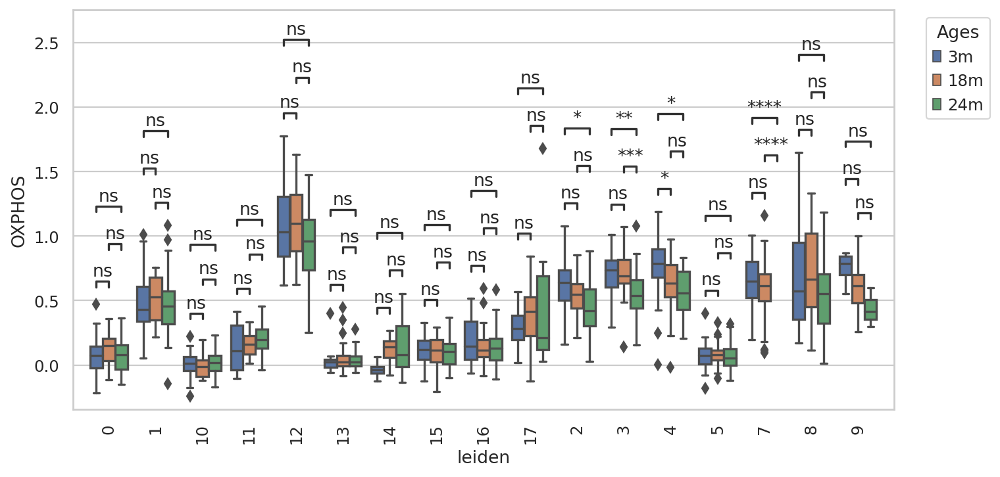

In [107]:
#df = tissue_copy1.obs[[ 'age','cell_ontology_class','OXPHOS']]
df = oxphos_df
df[[ 'age','leiden','OXPHOS']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")

df = df.sort_values("leiden")


mask = df['leiden'].isin(['0','1','2','3','4','5','7','8','9','10','11','12','13','14','15','16','17'])
df = df[mask]

x = "leiden" 
y = "OXPHOS" 
hue_order = ['3m', '18m', '24m']
hue = 'age'


box_pairs=[
    (("0", "3m"), ("0", "18m")),
    (("0", "3m"), ("0", "24m")),
    (("0", "18m"), ("0", "24m")),
    
    (("1", "3m"), ("1", "18m")),
    (("1", "3m"), ("1", "24m")),
    (("1", "18m"), ("1", "24m")),
    
    (("2", "3m"), ("2", "18m")),
    (("2", "3m"), ("2", "24m")),
    (("2", "18m"), ("2", "24m")),
    
    (("3", "3m"), ("3", "18m")),
    (("3", "3m"), ("3", "24m")),
    (("3", "18m"), ("3", "24m")),
    
    (("4", "3m"), ("4", "18m")),
    (("4", "3m"), ("4", "24m")),
    (("4", "18m"), ("4", "24m")),
    
    (("5", "3m"), ("5", "18m")),
    (("5", "3m"), ("5", "24m")),
    (("5", "18m"), ("5", "24m")),
    
    (("7", "3m"), ("7", "18m")),
    (("7", "3m"), ("7", "24m")),
    (("7", "18m"), ("7", "24m")),
    
    (("8", "3m"), ("8", "18m")),
    (("8", "3m"), ("8", "24m")),
    (("8", "18m"), ("8", "24m")),
    
    (("9", "3m"), ("9", "18m")),
    (("9", "3m"), ("9", "24m")),
    (("9", "18m"), ("9", "24m")),
    
    (("10", "3m"), ("10", "18m")),
    (("10", "3m"), ("10", "24m")),
    (("10", "18m"), ("10", "24m")),
    
    (("11", "3m"), ("11", "18m")),
    (("11", "3m"), ("11", "24m")),
    (("11", "18m"), ("11", "24m")),
    
    (("12", "3m"), ("12", "18m")),
    (("12", "3m"), ("12", "24m")),
    (("12", "18m"), ("12", "24m")),
    
    (("13", "3m"), ("13", "18m")),
    (("13", "3m"), ("13", "24m")),
    (("13", "18m"), ("13", "24m")),
    
    (("14", "3m"), ("14", "18m")),
    (("14", "3m"), ("14", "24m")),
    (("14", "18m"), ("14", "24m")),
    
    (("15", "3m"), ("15", "18m")),
    (("15", "3m"), ("15", "24m")),
    (("15", "18m"), ("15", "24m")),
    
    (("16", "3m"), ("16", "18m")),
    (("16", "3m"), ("16", "24m")),
    (("16", "18m"), ("16", "24m")),
    
    (("17", "3m"), ("17", "18m")),
    (("17", "3m"), ("17", "24m")),
    (("17", "18m"), ("17", "24m"))    
    ]

fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)

ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1), title = "Ages")

#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_leiden_oxphos_scoregenes_statannot_05192022', dpi=150,bbox_inches='tight')



### score_genes for mt genes |B

<ipython-input-108-614f050bd786>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.290e-01 U_stat=5.400e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.469e-02 U_stat=7.850e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.200e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.960e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.937e-03 U_stat=1.026e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

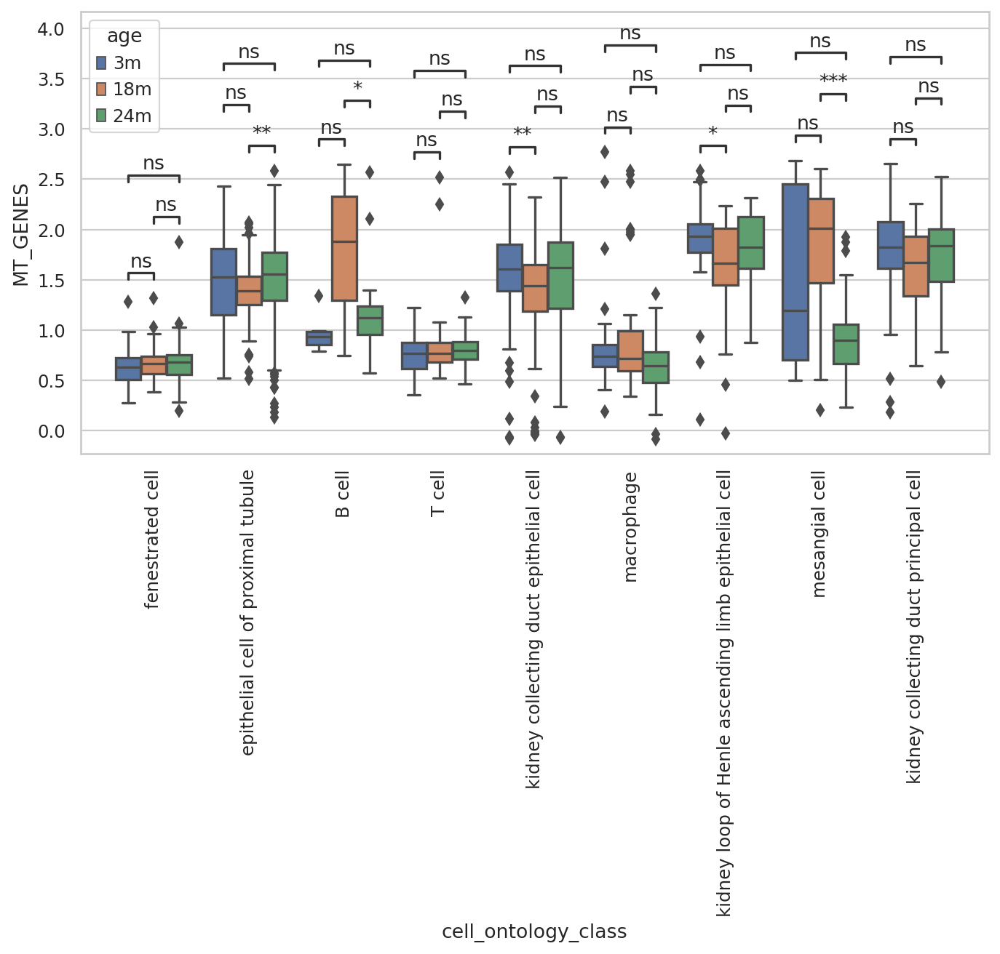

In [108]:
#Don't really think score_genes can be used for mt-encoded genes

df = tissue_copy2.obs[[ 'age','cell_ontology_class','MT_GENES']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "MT_GENES" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtgenes_scoregenes_statannot_05192022', dpi=150,bbox_inches='tight')


### Nc-encoded MT genes [N]

<ipython-input-109-0d8a8358f457>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.710e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.798e-01 U_stat=3.280e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.000e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.200e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.251e-06 U_stat=1.867e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

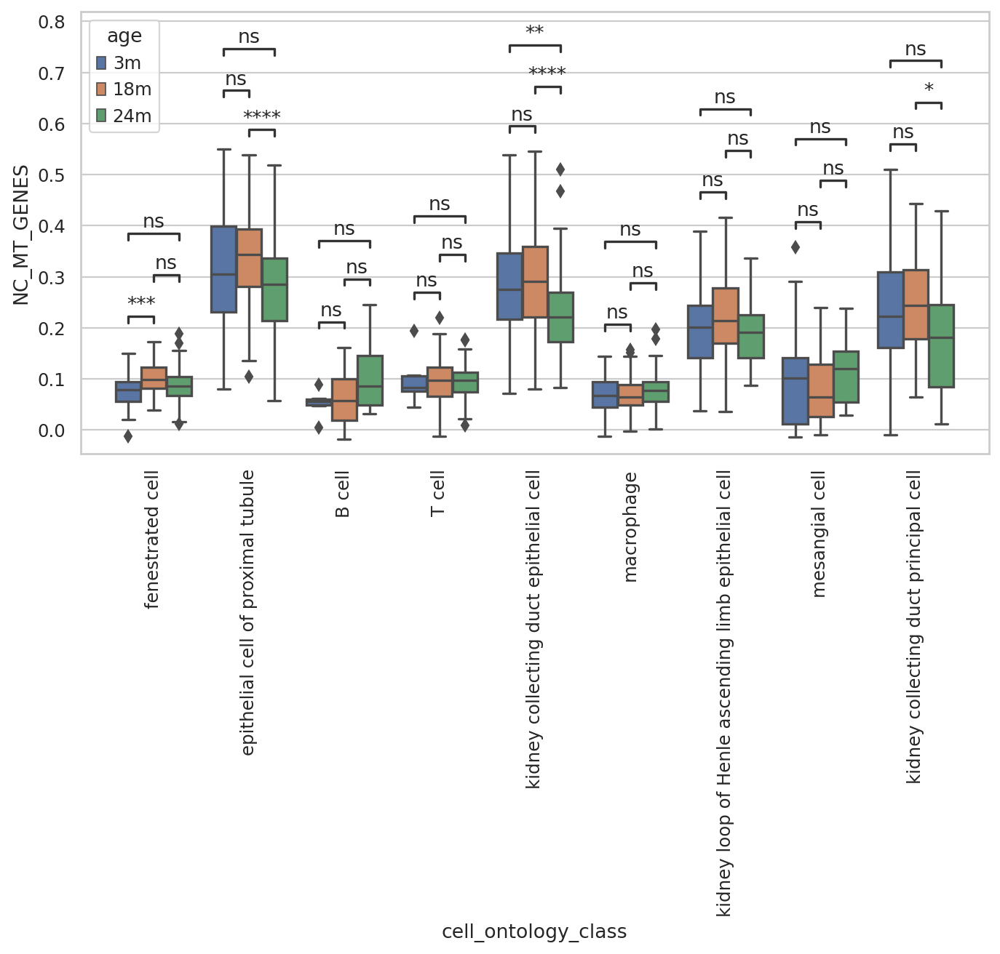

In [109]:
#score_genes
df = tissue_copy3.obs[[ 'age','cell_ontology_class','NC_MT_GENES']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "NC_MT_GENES" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_ncmtgenes_scoregenes_statannot_05192022', dpi=150,bbox_inches='tight')


### mt-genes

#### mt-Atp6 | T (18 vs 24)

<ipython-input-110-a45c00c14461>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.150e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.290e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.400e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.215e-04 U_stat=1.810e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=8.484e-27 U_stat=3.969e+03
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

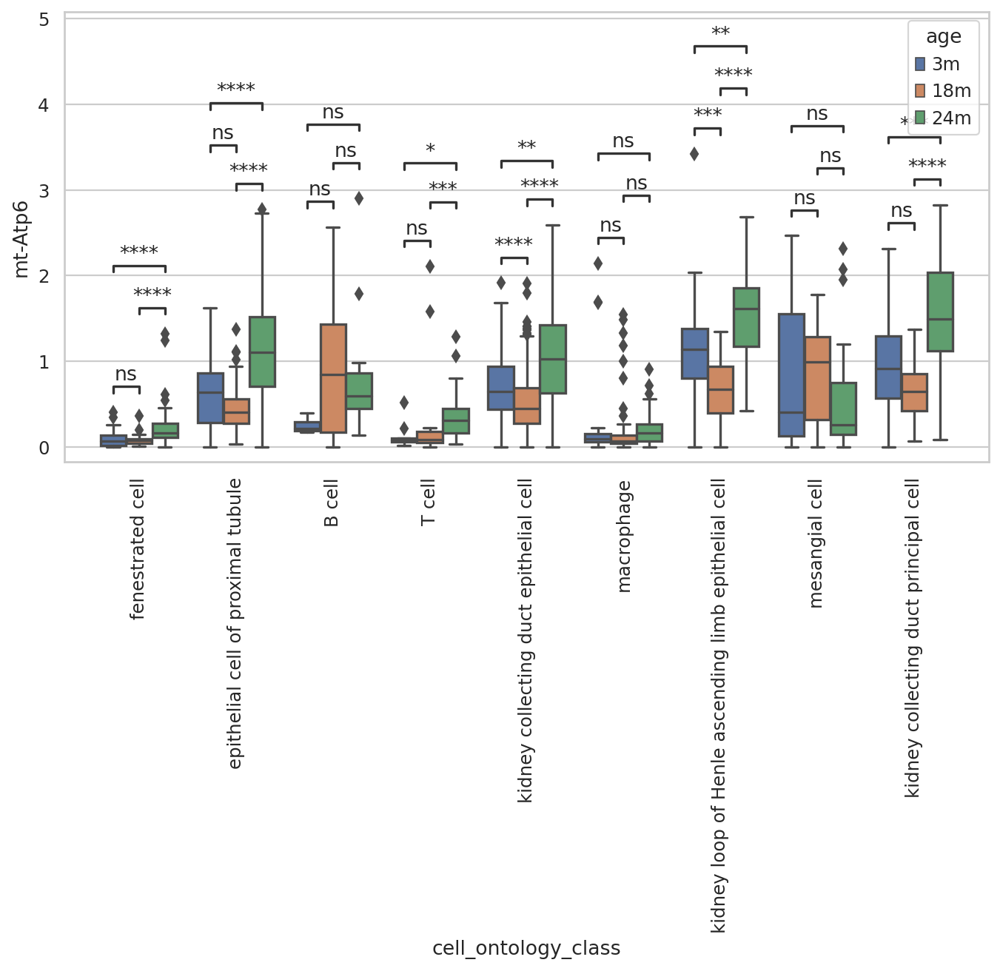

In [110]:
df = t2_df[['age','cell_ontology_class','mt-Atp6']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Atp6" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtAtp6_statannot_05192022', dpi=150,bbox_inches='tight')



#### mt-Atp8 |B , T , M. all: (3v18, 18v24)

<ipython-input-111-3564bd16979c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.720e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.410e-03 U_stat=7.990e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.270e+02
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.848e-02 U_stat=6.865e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.083e-14 U_stat=2.007e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

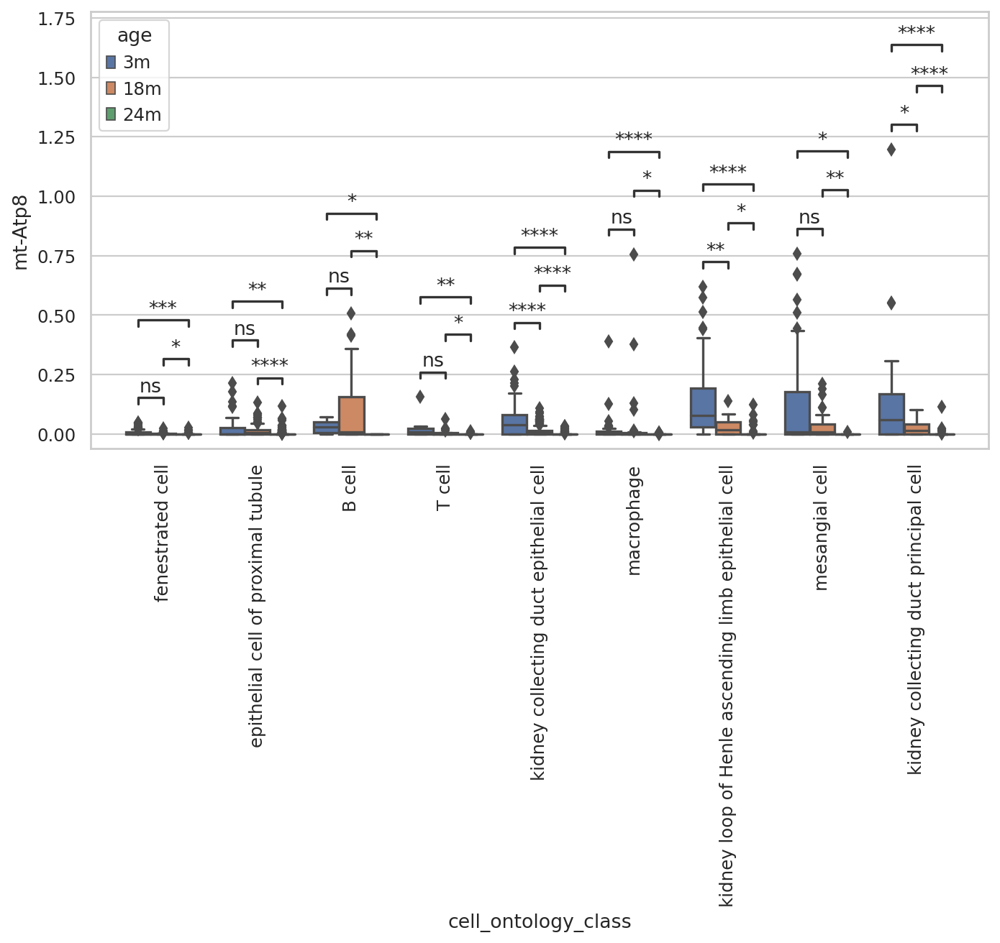

In [111]:
df = t2_df[['age','cell_ontology_class','mt-Atp8']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Atp8" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtAtp8_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Co1 |B (3v24)

<ipython-input-112-62d13d6d0786>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.567e-02 U_stat=3.200e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.660e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=9.396e-01 U_stat=5.000e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.650e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.338e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

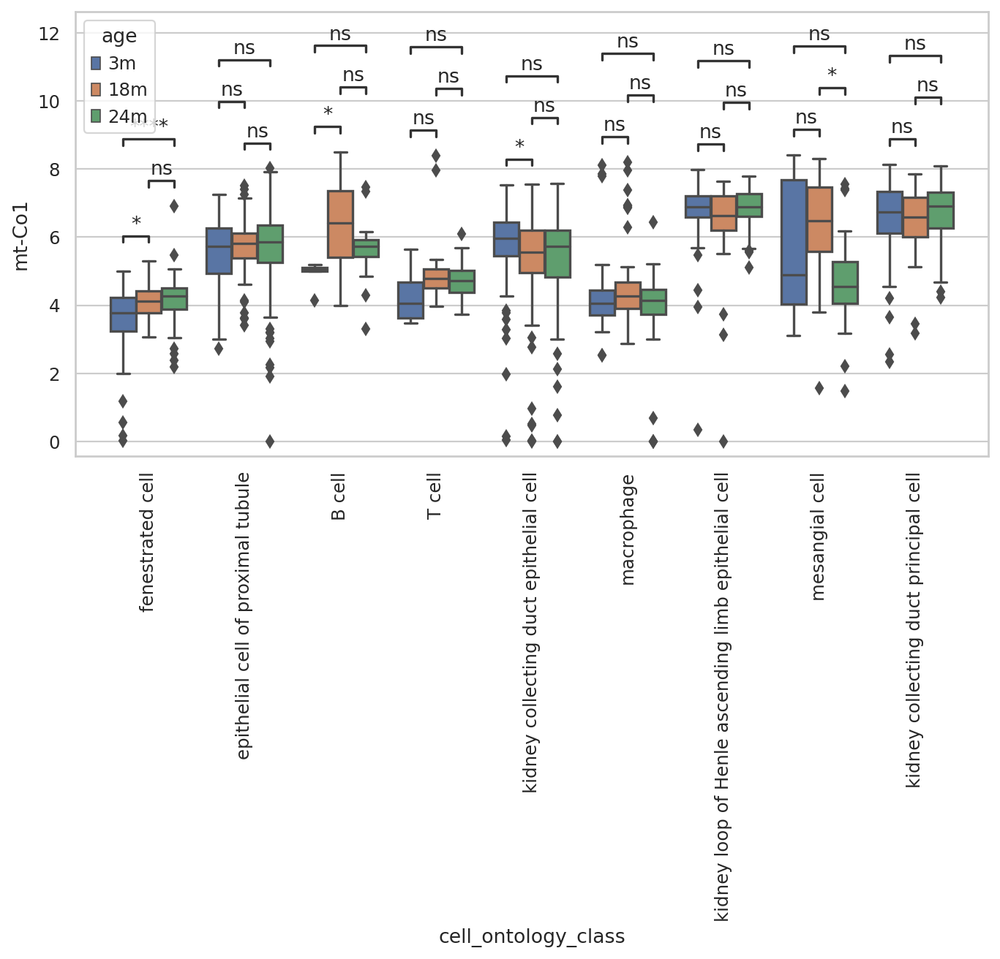

In [112]:
df = t2_df[['age','cell_ontology_class','mt-Co1']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Co1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtCo1_statannot_05192022', dpi=150,bbox_inches='tight')



#### mt-Co2 |T, M. both (3v18, 18v24)

<ipython-input-113-6bdc0375a18d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.362e-02 U_stat=4.400e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.360e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.000e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.003e-05 U_stat=1.490e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.839e-29 U_stat=3.488e+03
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

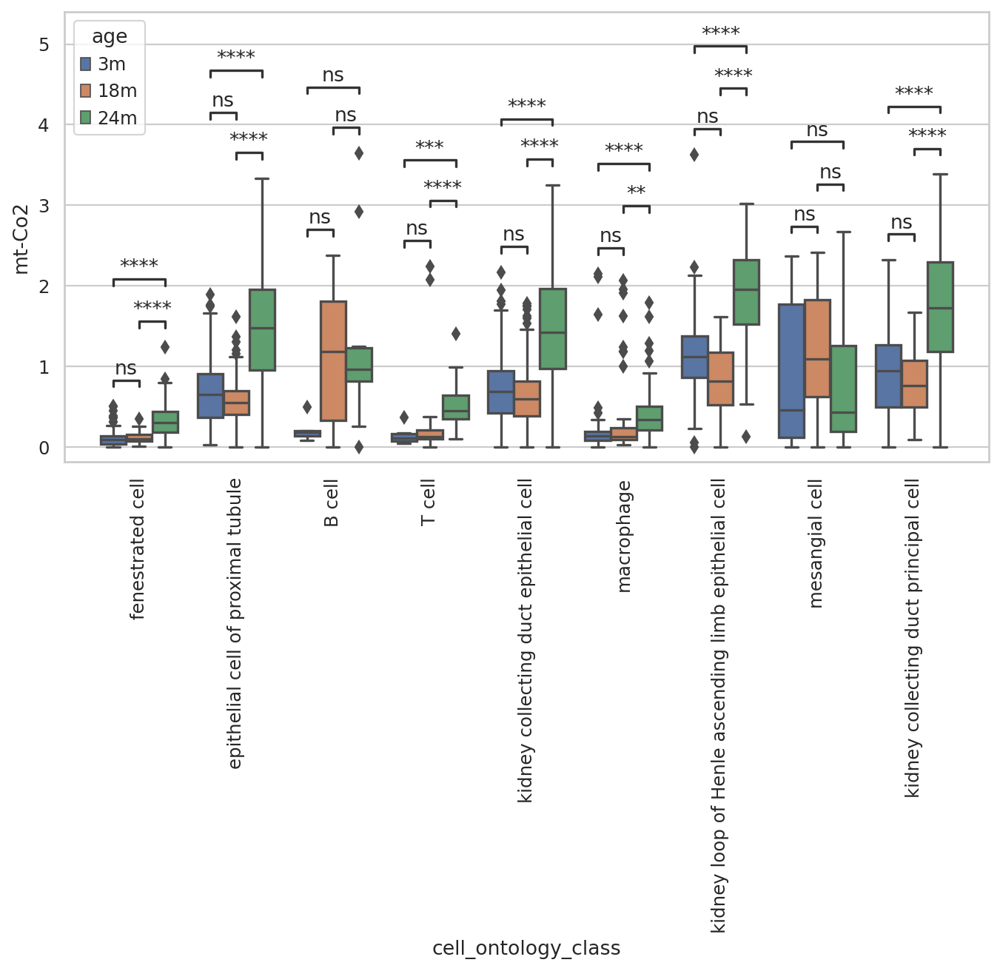

In [113]:
df = t2_df[['age','cell_ontology_class','mt-Co2']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Co2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtCo2_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Co3 | T (3v18)

<ipython-input-114-05f0c49256b0>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.030e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.810e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=7.200e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.059e-02 U_stat=2.750e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.492e-24 U_stat=4.530e+03
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

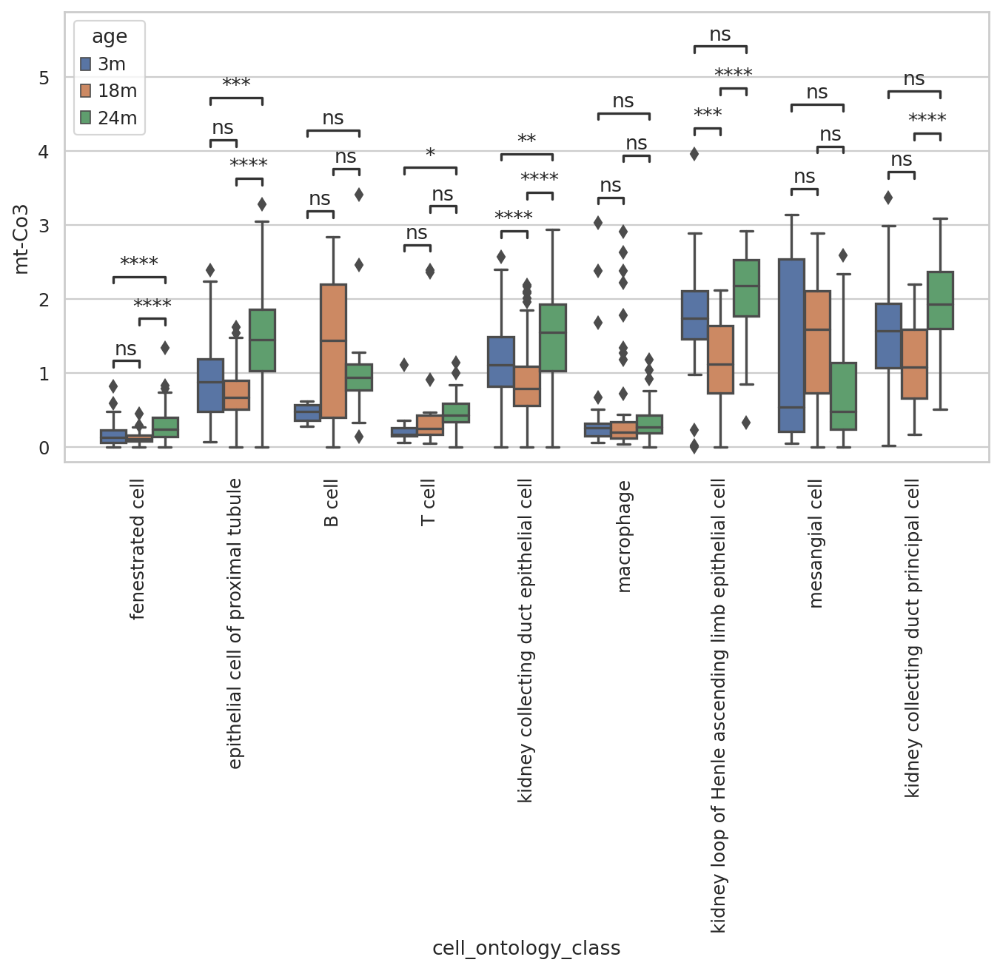

In [114]:
df = t2_df[['age','cell_ontology_class','mt-Co3']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Co3" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtCo3_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Cytb | B (18v24)

<ipython-input-115-a877ec0cbfbe>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.381e-01 U_stat=5.500e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.261e-03 U_stat=8.440e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.100e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.290e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.685e-03 U_stat=1.032e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

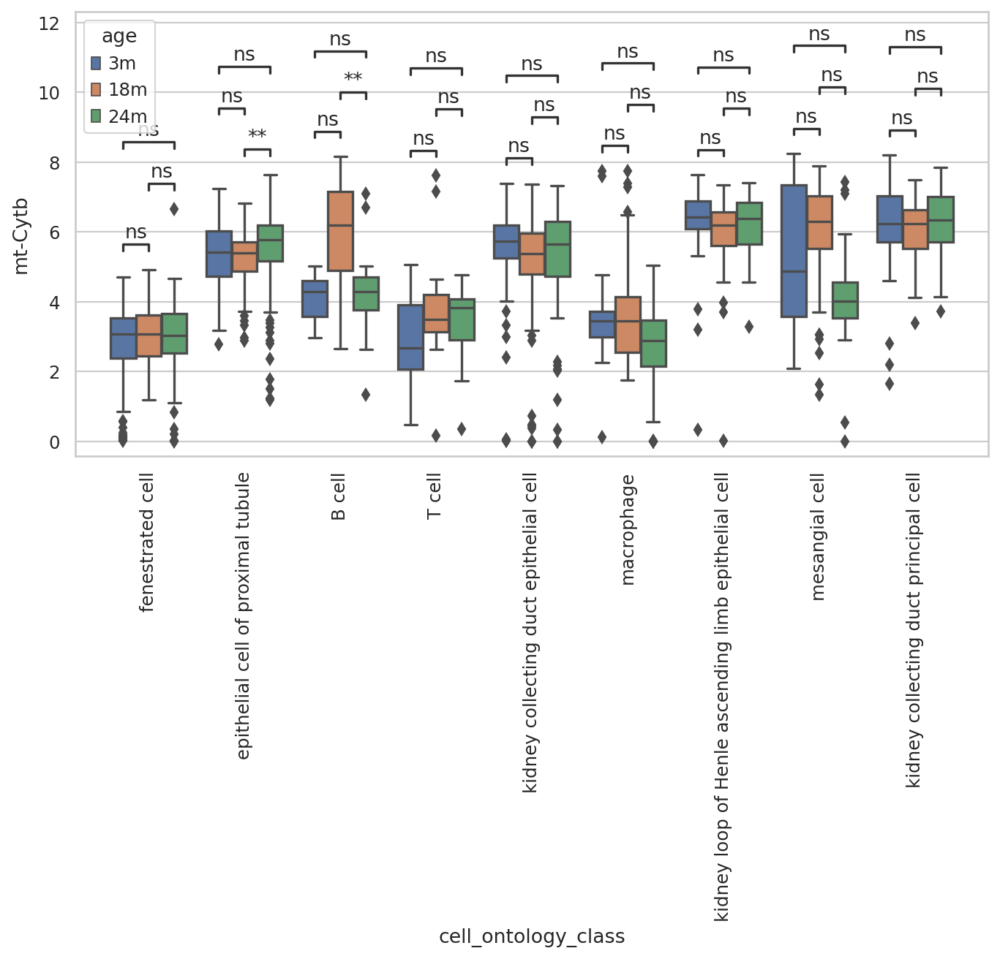

In [115]:
df = t2_df[['age','cell_ontology_class','mt-Cytb']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Cytb" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtCytB_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Nd1

<ipython-input-116-9c5297d2968d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.374e-01 U_stat=7.300e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=8.167e-02 U_stat=7.640e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=7.000e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.020e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=9.764e-02 U_stat=1.120e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

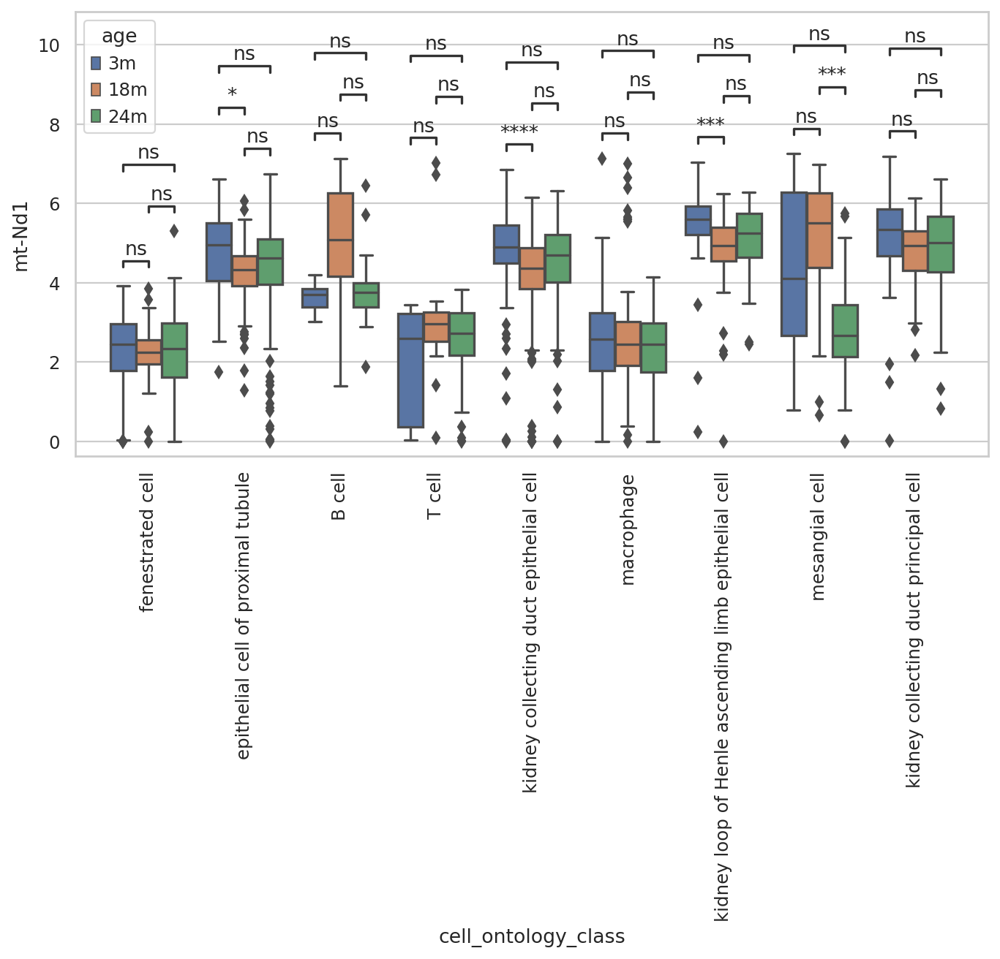

In [116]:
df = t2_df[['age','cell_ontology_class','mt-Nd1']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd1_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Nd2 |B (18v24)

<ipython-input-117-92bf49601854>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.902e-02 U_stat=4.700e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.458e-02 U_stat=7.790e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.060e+02
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.530e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.474e-01 U_stat=1.173e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

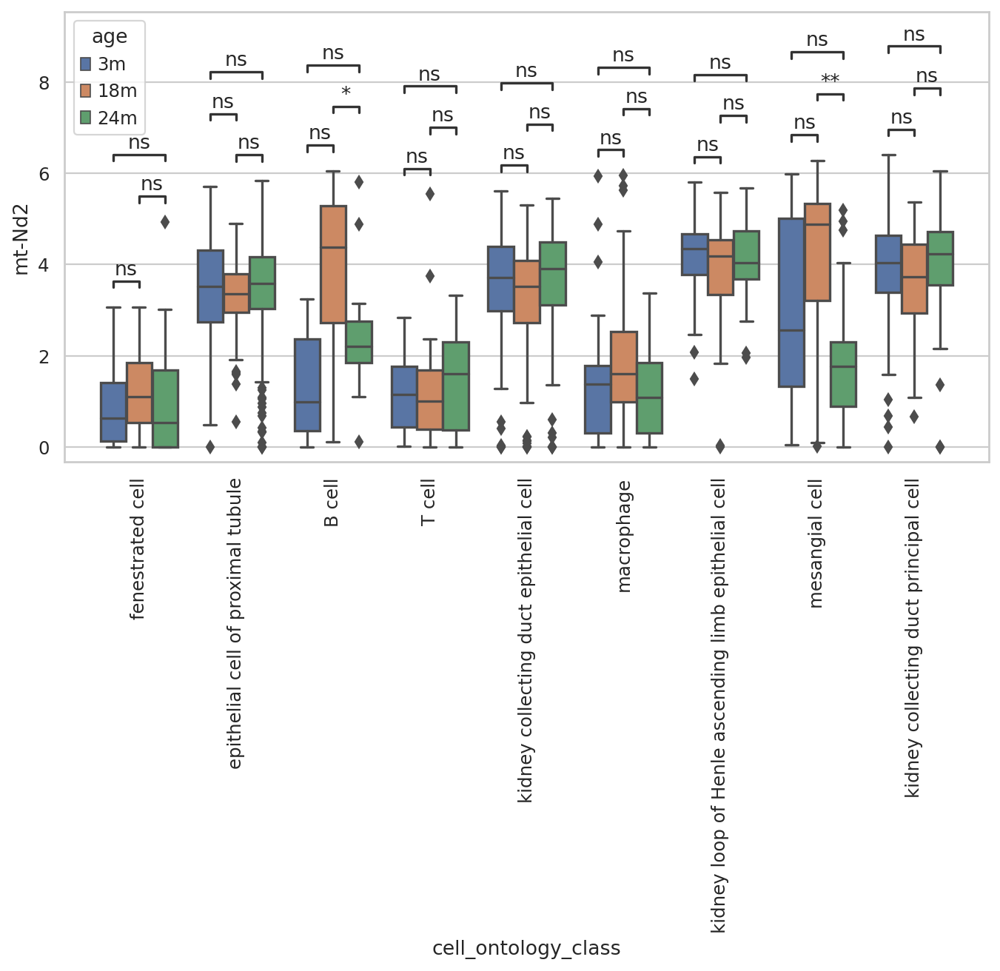

In [117]:
df = t2_df[['age','cell_ontology_class','mt-Nd2']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd2_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Nd3 |B (18v24)

<ipython-input-118-ab0480734dcc>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.035e-02 U_stat=4.550e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.908e-03 U_stat=8.180e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.500e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.510e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.449e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

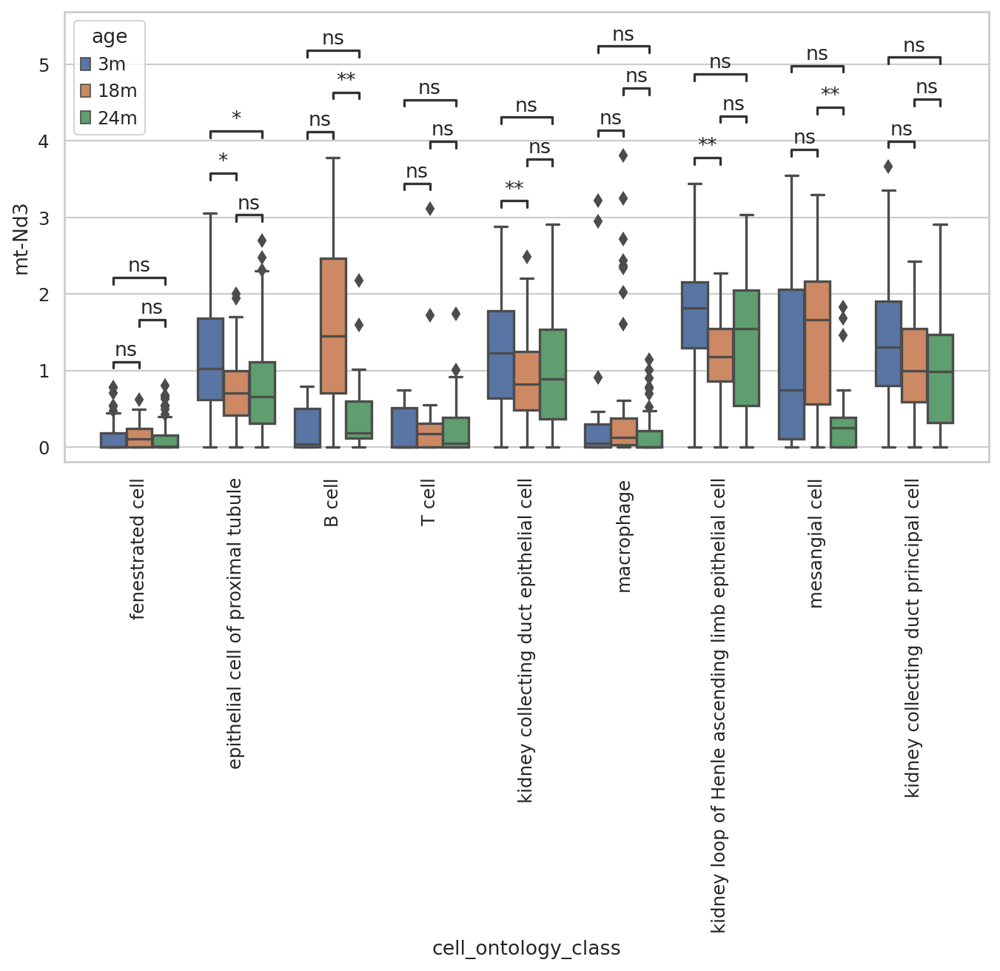

In [118]:
df = t2_df[['age','cell_ontology_class','mt-Nd3']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd3" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd3_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Nd4

<ipython-input-119-fb6b72701cf1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.494e-02 U_stat=4.200e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.451e-01 U_stat=7.490e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.220e+02
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.880e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=9.164e-04 U_stat=1.010e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

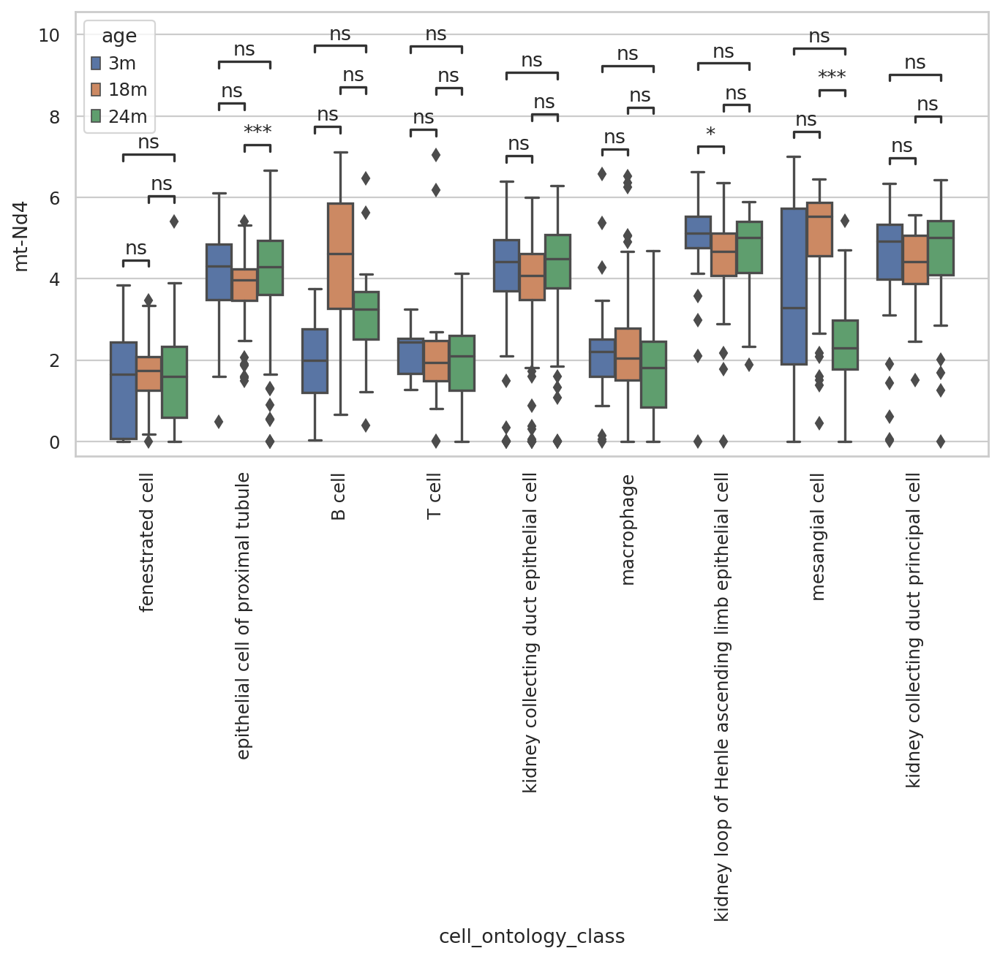

In [119]:
df = t2_df[['age','cell_ontology_class','mt-Nd4']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd4" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd4_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Nd4l

<ipython-input-120-f2de30559b96>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.565e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.400e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.550e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.903e-01 U_stat=5.875e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.980e-01 U_stat=1.564e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

ValueError: All numbers are identical in mannwhitneyu

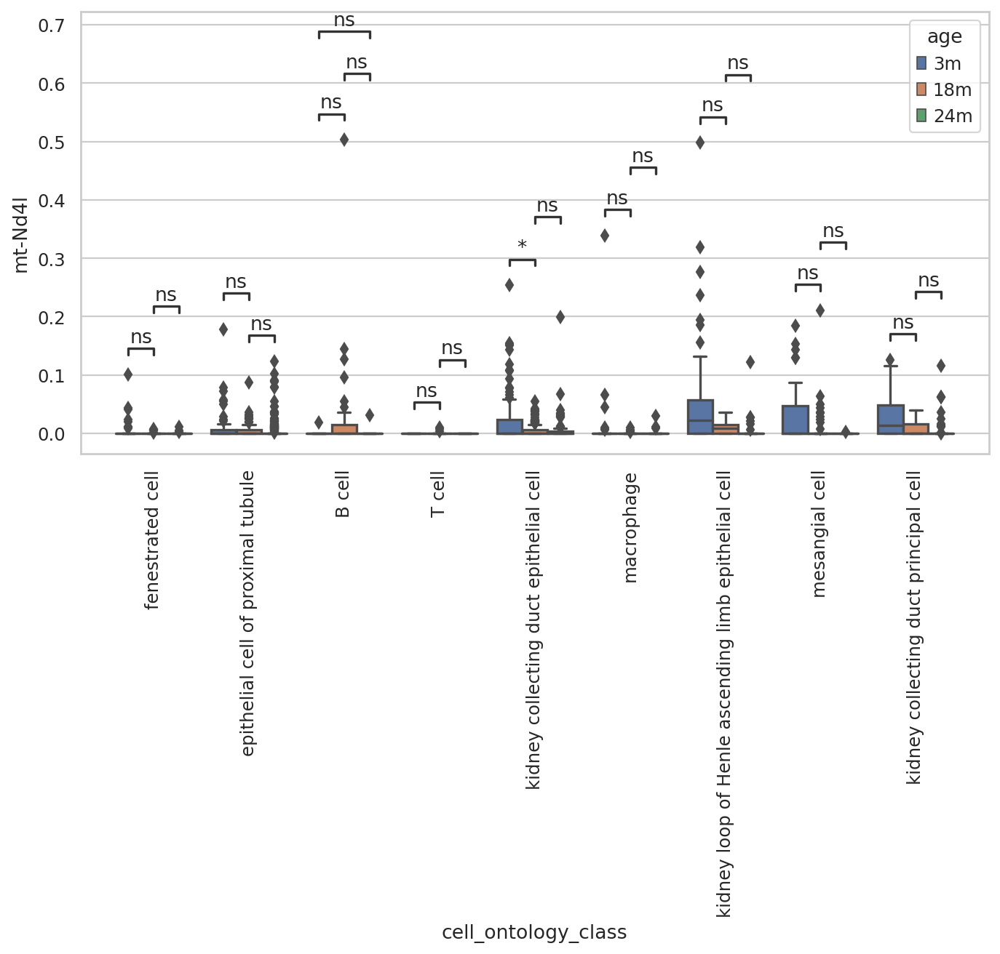

In [120]:
df = t2_df[['age','cell_ontology_class','mt-Nd4l']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd4l" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd4l_statannot_05192022', dpi=150,bbox_inches='tight')


#### mt-Nd5 | B (3v24, 18v24), M (3v18)

<ipython-input-121-388490560acb>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.074e-02 U_stat=3.800e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.737e-03 U_stat=8.290e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.000e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.780e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.356e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

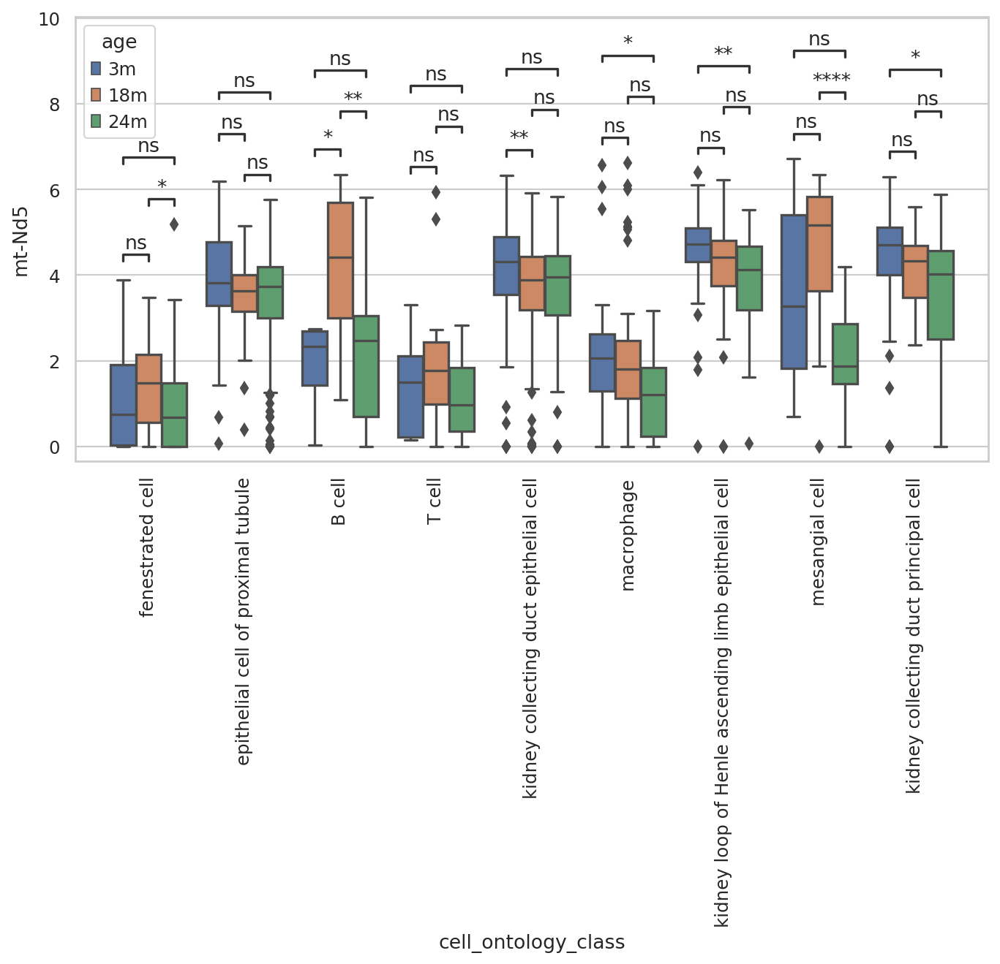

In [121]:
df = t2_df[['age','cell_ontology_class','mt-Nd5']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd5" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd5_statannot_05192022', dpi=150,bbox_inches='tight')



#### mt-Nd6 | B (18v24), M (3v18)

<ipython-input-122-94c8a66ec9a7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.030e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.130e-02 U_stat=8.105e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.280e+02
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.670e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.157e-02 U_stat=1.669e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

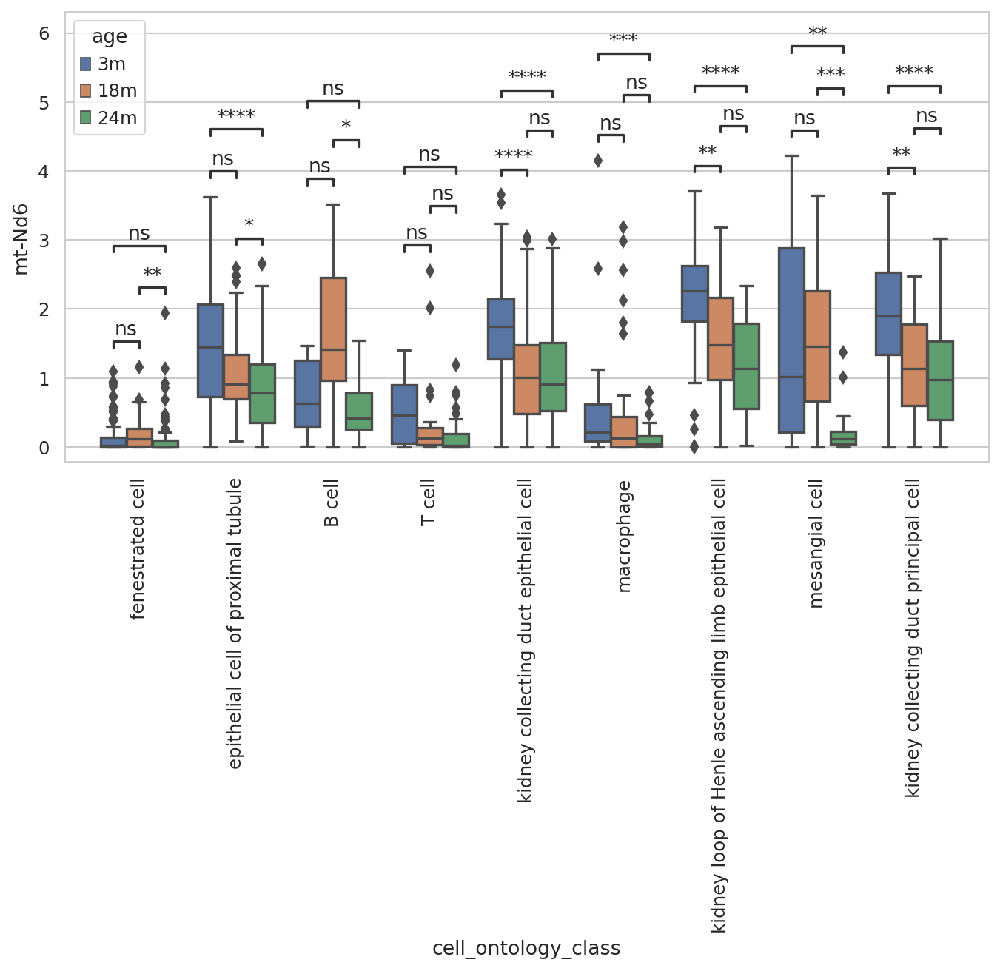

In [122]:
df = t2_df[['age','cell_ontology_class','mt-Nd6']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Nd6" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtNd6_statannot_05192022', dpi=150,bbox_inches='tight')



#### mt-Rnr1 | B (18v24), M (18v24)

<ipython-input-17-704c5d009314>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.427e-01 U_stat=6.900e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.409e-04 U_stat=8.860e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.300e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=9.225e-01 U_stat=6.820e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.439e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

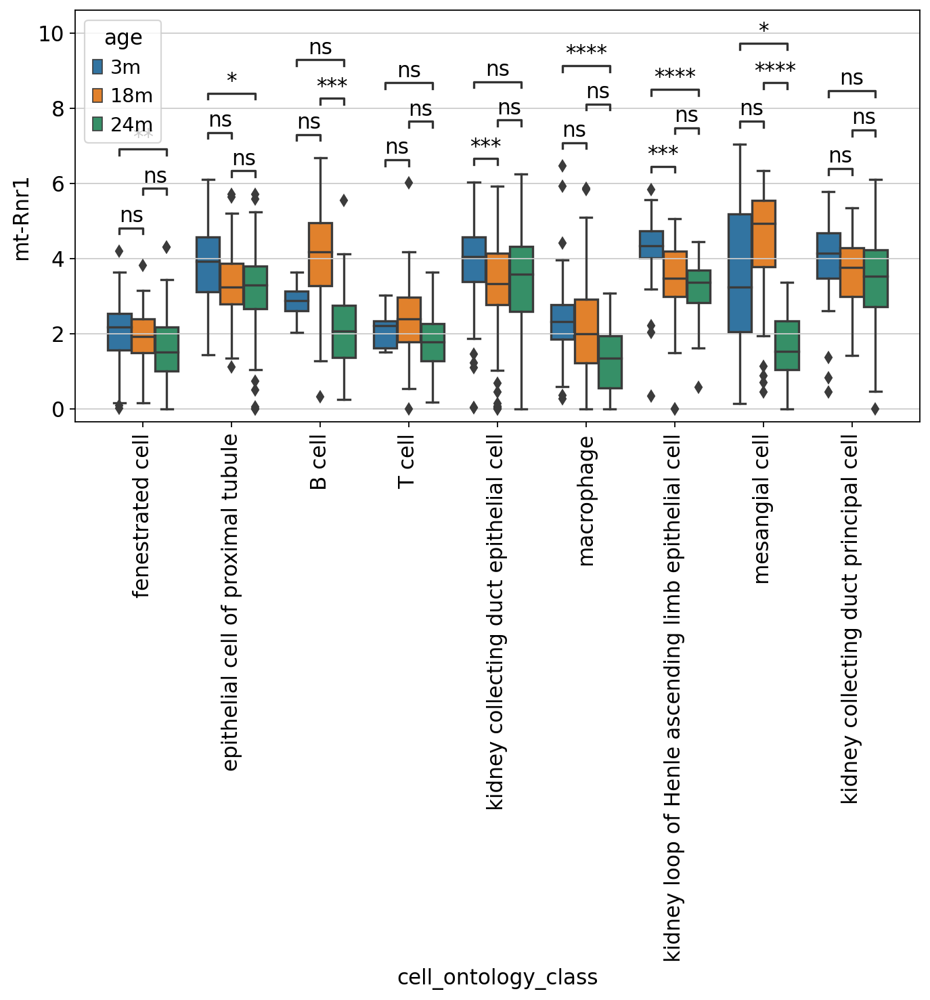

In [17]:
df = t2_df[['age','cell_ontology_class','mt-Rnr1']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Rnr1" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtRnr1_statannot_05192022', dpi=150,bbox_inches='tight')



#### mt-Rnr2

<ipython-input-123-c48ee0f22177>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.355e-02 U_stat=4.600e+01
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.473e-02 U_stat=7.740e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.010e+02
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.250e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.800e-04 U_stat=9.779e+03
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

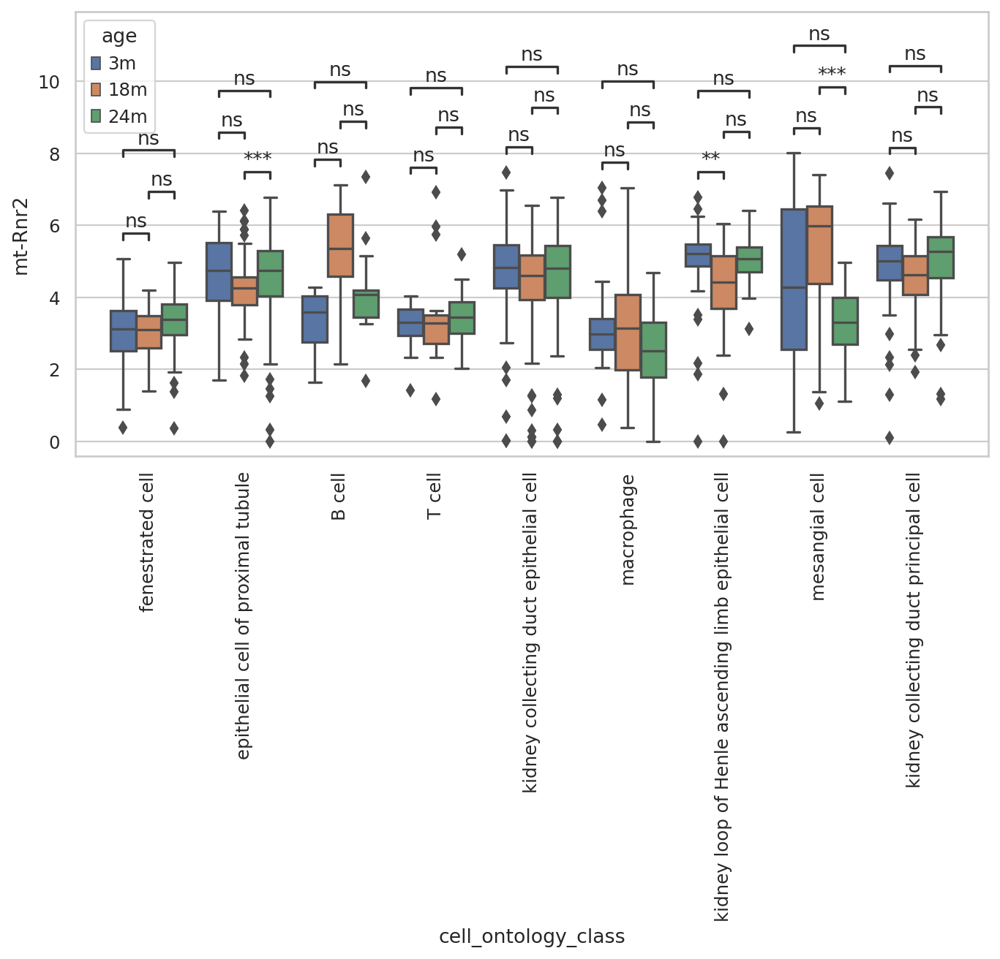

In [123]:
df = t2_df[['age','cell_ontology_class','mt-Rnr2']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "mt-Rnr2" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_mtRnr2_statannot_05192022', dpi=150,bbox_inches='tight')



### Genes and score_genes

#### histplot

In [ ]:
sns.histplot(, color='navy')
sns.histplot(, color='gold')


#### BCR

<ipython-input-164-cacf2786cdbe>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.902e-02 U_stat=3.190e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.007e-01 U_stat=3.340e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=8.600e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.460e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.390e-05 U_stat=9.587e+03
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

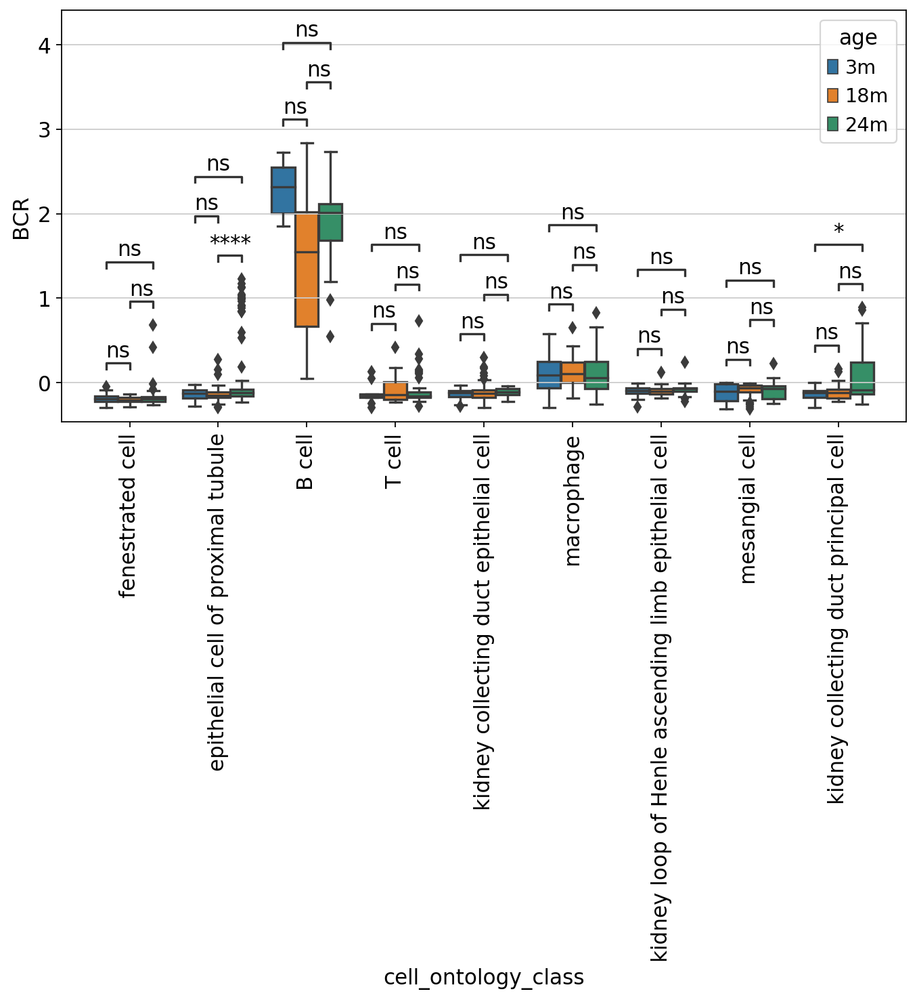

In [164]:
df = tissueBCR[['age','cell_ontology_class','BCR']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "BCR" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/BCR_kidney_Ighm_Iglc1_Syk_Ighd_Lime1_Cd79a_Cd79b_05242022', 
            dpi=150,bbox_inches='tight')



#### Cd79a, | B, principal, maybe interesting

<ipython-input-131-b30843ae786b>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.026e-01 U_stat=2.990e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.223e-03 U_stat=1.810e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.450e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.175e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.337e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

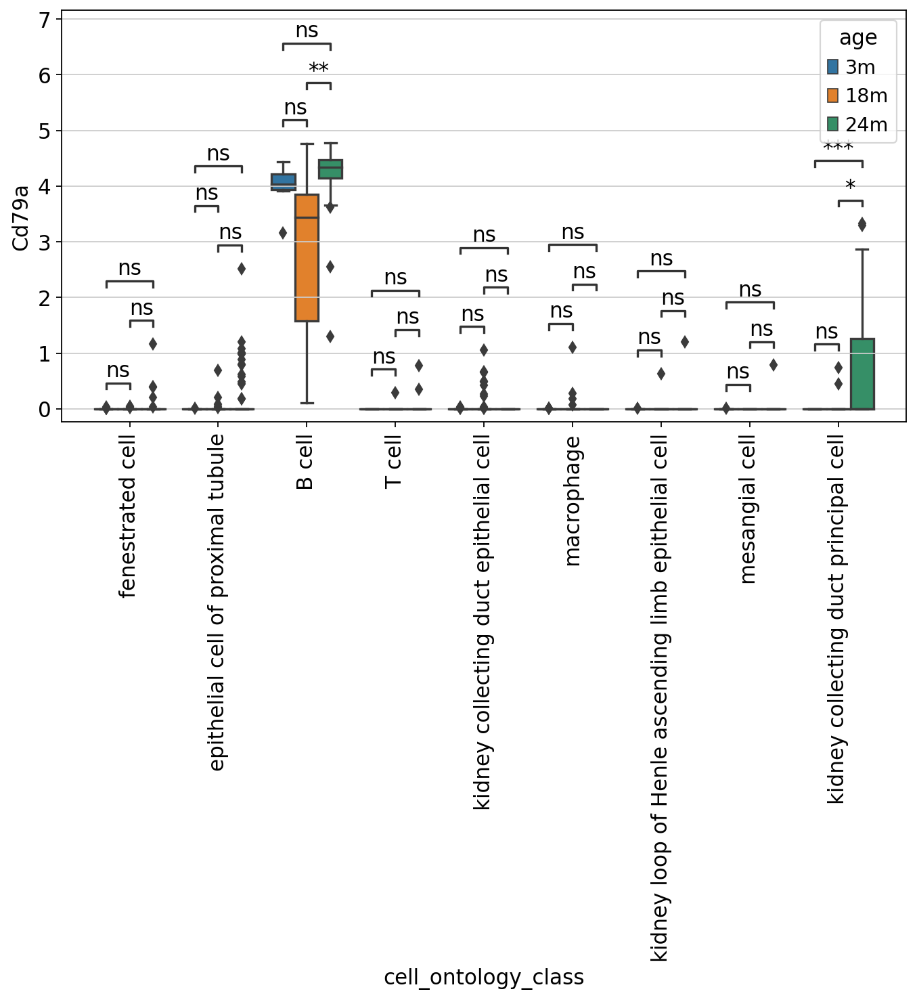

In [131]:
df = tissueBCR[['age','cell_ontology_class','Cd79a']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Cd79a" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/BCR_kidney_Cd79a_05242022', 
            dpi=150,bbox_inches='tight')

<ipython-input-59-66a9c974d66a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.643e-01 U_stat=2.920e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.161e-03 U_stat=1.800e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.450e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.175e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.330e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

ValueError: All numbers are identical in mannwhitneyu

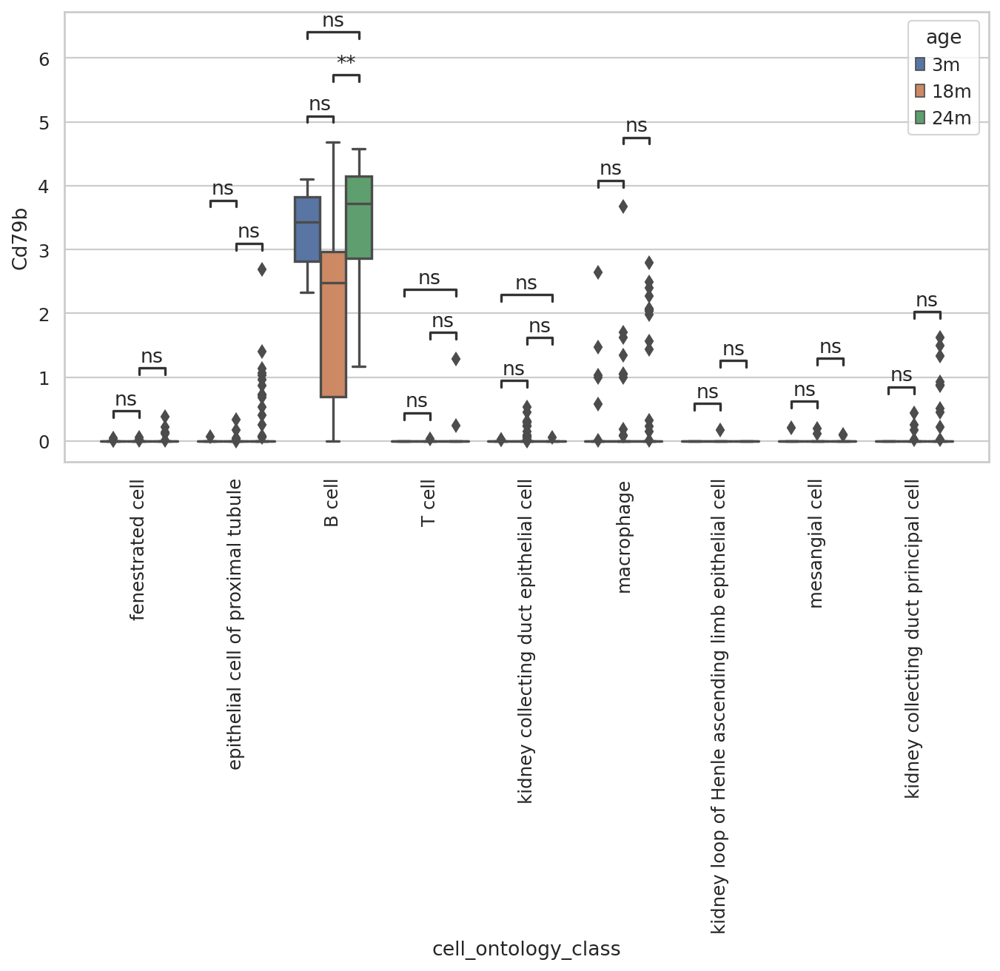

In [59]:
df = tissueBCR[['age','cell_ontology_class','Cd79b']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Cd79b" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/BCR_kidney_Cd79b_05242022', 
            dpi=150,bbox_inches='tight')

<ipython-input-139-edd2b9898e13>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.026e-01 U_stat=2.990e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.288e-03 U_stat=1.820e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.450e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.175e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.337e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

(<AxesSubplot:xlabel='cell_ontology_class', ylabel='Cd79a'>,
  <statannot.StatResult.StatResult at 0x7faffd75cdc0>])

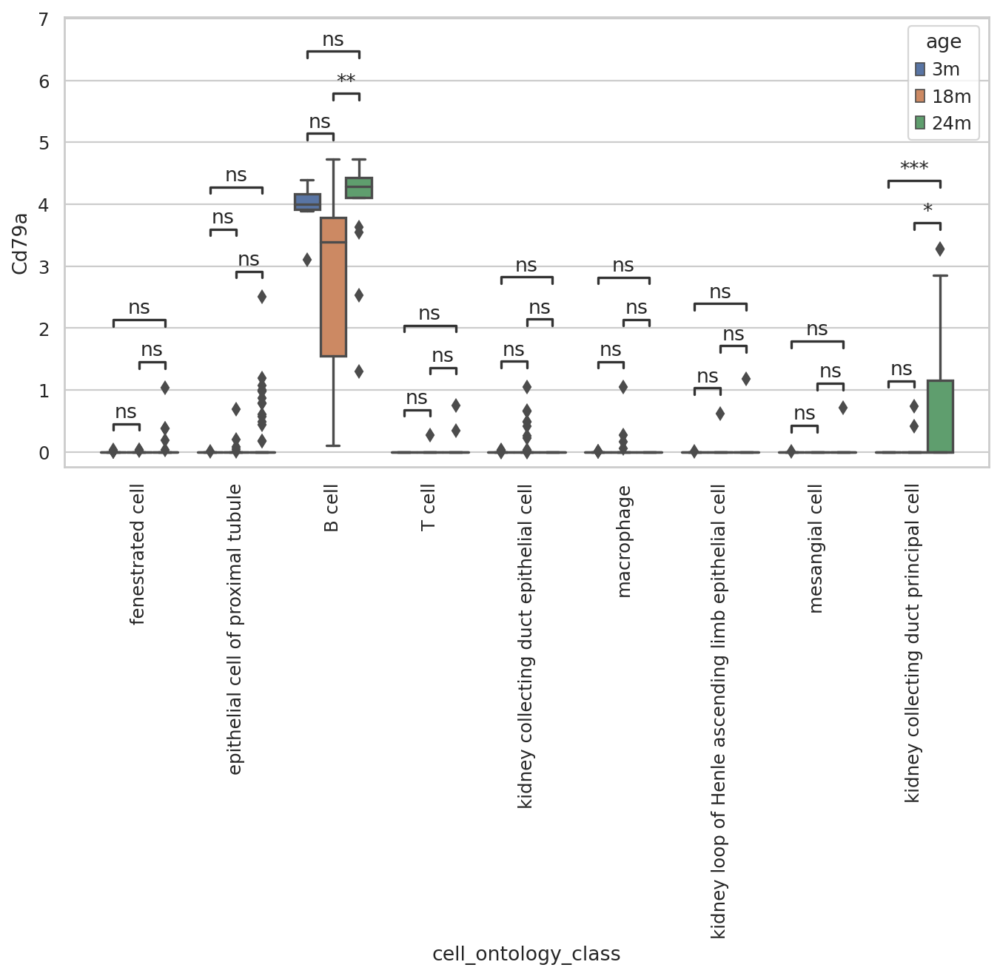

In [139]:
df = tissueBCR[['age','cell_ontology_class','Cd79a']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Cd79a" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

#### Cd79b, |B maybe interesting

<ipython-input-140-2f65e9739571>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.928e-01 U_stat=2.910e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.102e-03 U_stat=1.790e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.450e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.175e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.330e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

ValueError: All numbers are identical in mannwhitneyu

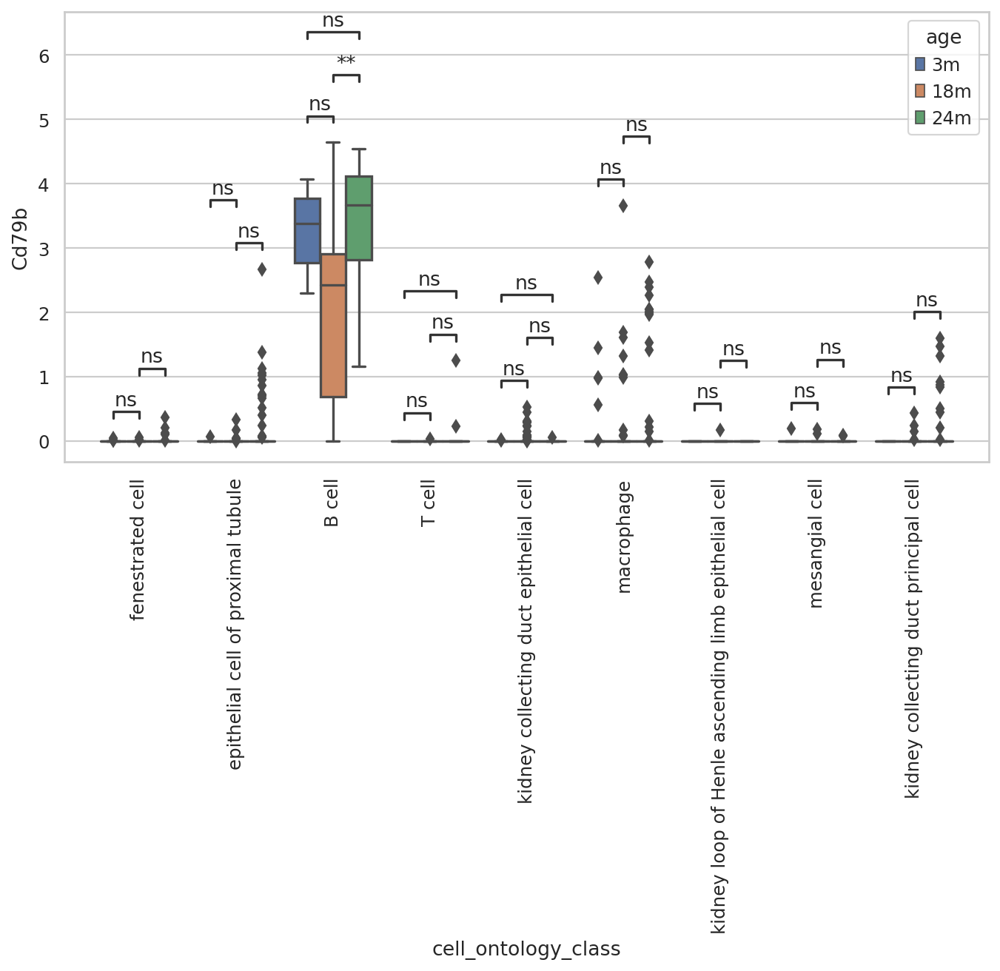

In [140]:
df = tissueBCR[['age','cell_ontology_class','Cd79b']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Cd79b" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

<ipython-input-62-95e4f2120128>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

3m v.s. 18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.362e-02 U_stat=2.990e+02
18m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.359e-04 U_stat=1.810e+02
3m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.614e-01 U_stat=3.300e+01


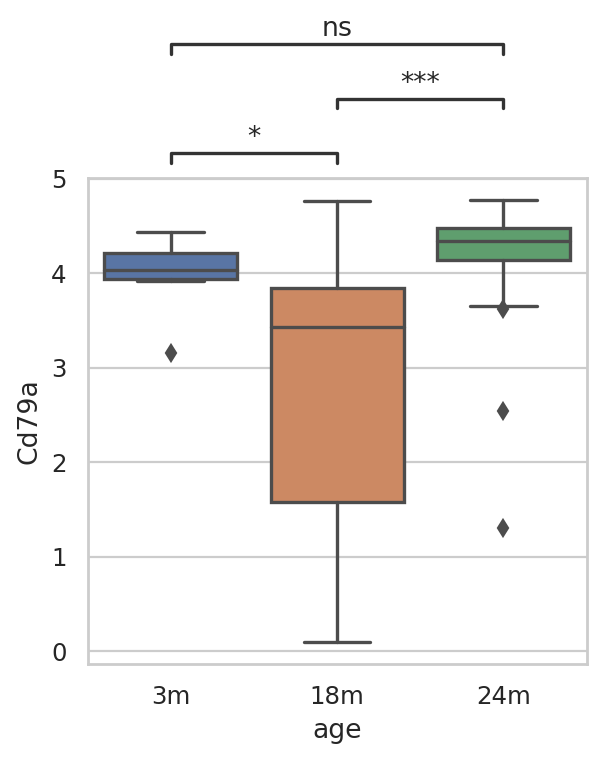

In [62]:
df = tissueBCR[['age','cell_ontology_class','Cd79a']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]


bc = tissueBCR.loc[tissueBCR['cell_ontology_class'] == 'B cell']
bbc=bc[['age','Cd79a']]

df = bbc
x = "age"
y = "Cd79a"
order = ['3m', '18m', '24m']
ax = sns.boxplot(data=df, x=x, y=y, order=order)
test_results = add_stat_annotation(ax, data=df, x=x, y=y, order=order,
                                   box_pairs=[("3m", "18m"), ("3m", "24m"), ("18m", "24m")],
                                   test='Mann-Whitney', text_format='star',
                                   loc='outside', verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/BCR_kidney_Bcell_Cd79a_05242022', 
            dpi=150,bbox_inches='tight')

<ipython-input-63-450f65393e0e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

3m v.s. 18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.159e-02 U_stat=2.920e+02
18m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.290e-04 U_stat=1.800e+02
3m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.100e+01


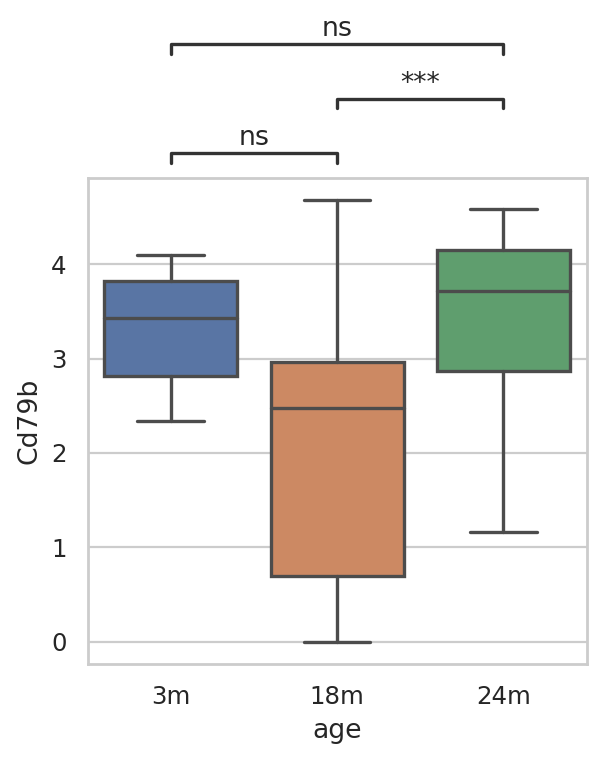

In [63]:
df = tissueBCR[['age','cell_ontology_class','Cd79b']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]


bc = tissueBCR.loc[tissueBCR['cell_ontology_class'] == 'B cell']
bbc=bc[['age','Cd79b']]

df = bbc
x = "age"
y = "Cd79b"
order = ['3m', '18m', '24m']
ax = sns.boxplot(data=df, x=x, y=y, order=order)
test_results = add_stat_annotation(ax, data=df, x=x, y=y, order=order,
                                   box_pairs=[("3m", "18m"), ("3m", "24m"), ("18m", "24m")],
                                   test='Mann-Whitney', text_format='star',
                                   loc='outside', verbose=2)
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/BCR_kidney_Bcell_Cd79b_05242022', 
            dpi=150,bbox_inches='tight')

#### Protein Synthesis

'Eif4e',

'Eif2s1'?

'Eif4g1'?

'Eif2b2'

'App',
'Aplp2'
Bace1



<ipython-input-63-115ad8f32f26>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.220e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.228e-01 U_stat=7.020e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.351e-02 U_stat=2.200e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.920e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.401e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

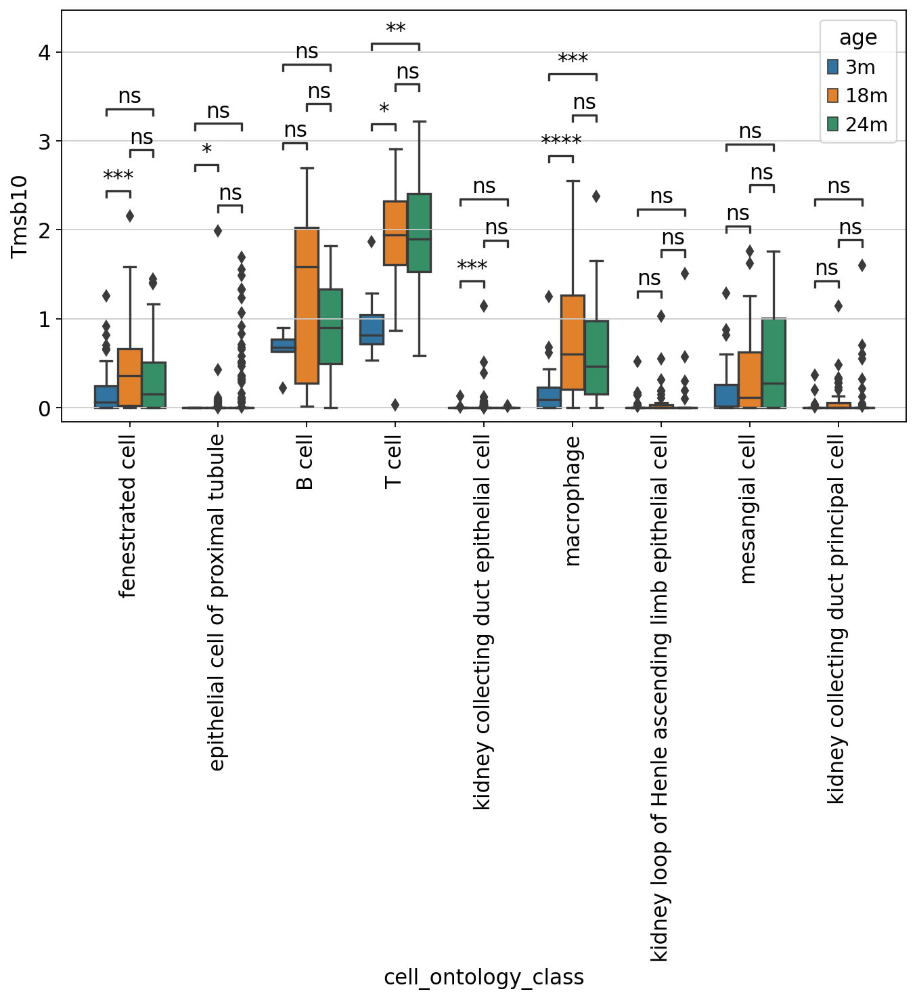

In [63]:
df = df_p[['age','cell_ontology_class','Tmsb10']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Tmsb10" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1), title = "Kidney Ages")
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/kidney_Tmsb10_stat_05272022', dpi=150,bbox_inches='tight')


Cd38 has a zero inflated distribution so I don't think this test works. However it is interesting to see CD38 expression in annotated endothelial cells

<ipython-input-145-12b22551594e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.710e+02
B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.245e+02
fenestrated cell_3m v.s. fenestrated cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.812e-01 U_stat=3.423e+03
fenestrated cell_18m v.s. fenestrated cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.969e-02 U_stat=3.307e+03
B cell_3m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.000e+01
fenestrated cell_3m v.s. fenestrated cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.471e-07 U_stat=8.192e+03


(<AxesSubplot:xlabel='cell_ontology_class', ylabel='Cd38'>,
  <statannot.StatResult.StatResult at 0x7faffdfaae80>])

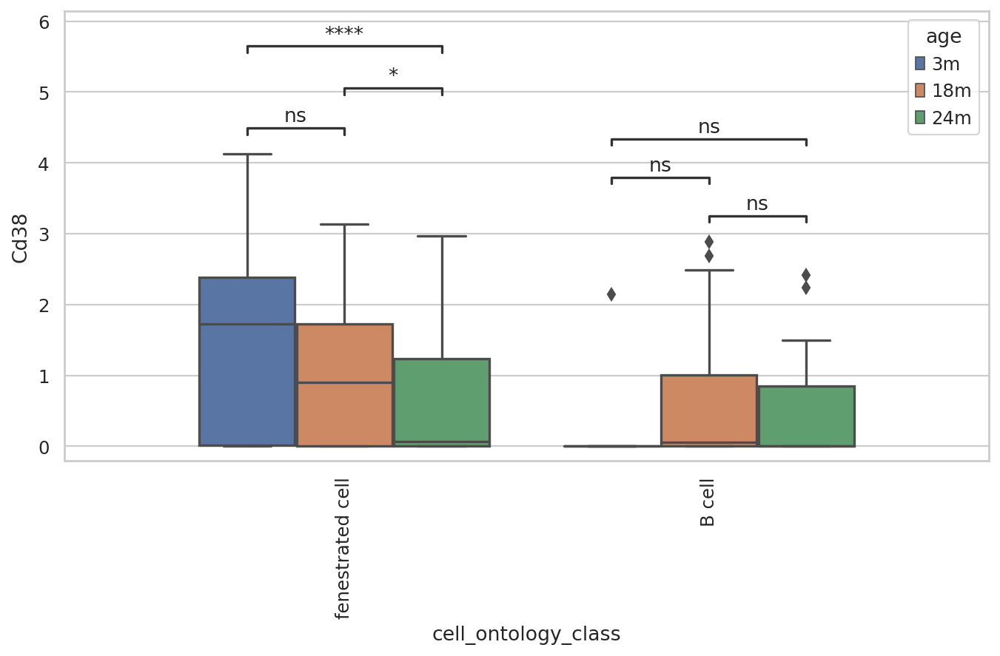

In [145]:
df = df_kid[['age','cell_ontology_class','Cd38']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','fenestrated cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Cd38" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),

    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

### TRACHEA SIDE JOURNEY

In [24]:
adata_trachea = adata[adata.obs['tissue'] == "Trachea"].copy()
sc.pp.pca(adata_trachea)
sc.pp.neighbors(adata_trachea, n_pcs=9)
sc.tl.leiden(adata_trachea) 
sc.tl.umap(adata_trachea)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


In [25]:
adata_trachea.obs.tissue

index
A18.D042475.3_9_M.1.1-1-1-0-0-0                Trachea
E4.D042475.3_9_M.1.1-1-1-0-0-0                 Trachea
J20.D042474.3_8_M.1.1-1-1-0-0-0                Trachea
P18.D042474.3_8_M.1.1-1-1-0-0-0                Trachea
A1.MAA000496.3_10_M.1.1-1-1-0-0-0              Trachea
                                                ...   
P5_B000524_B009242_S365.mm10-plus-0-0-1-0-0    Trachea
P6_B000524_B009242_S366.mm10-plus-0-0-1-0-0    Trachea
P7_B000524_B009242_S367.mm10-plus-0-0-1-0-0    Trachea
P8_B000524_B009242_S368.mm10-plus-0-0-1-0-0    Trachea
P9_B000524_B009242_S369.mm10-plus-0-0-1-0-0    Trachea
Name: tissue, Length: 2651, dtype: category
Categories (1, object): ['Trachea']

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 2, max_out_group_fraction: 0.5


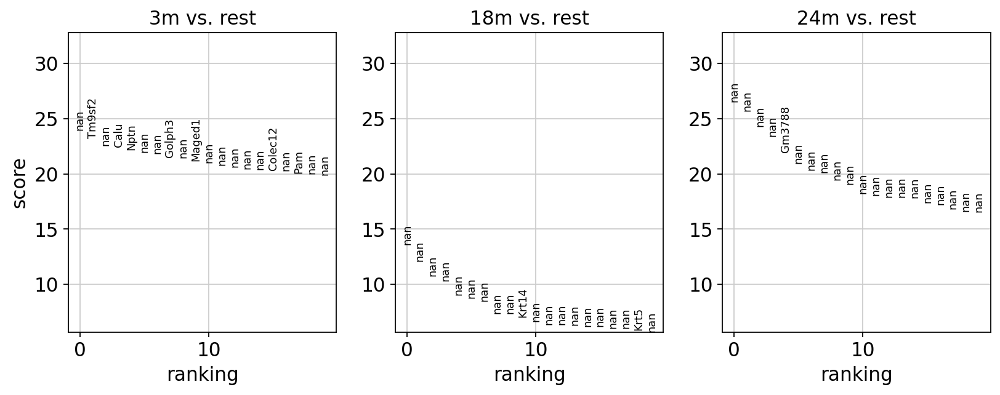

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_age']`


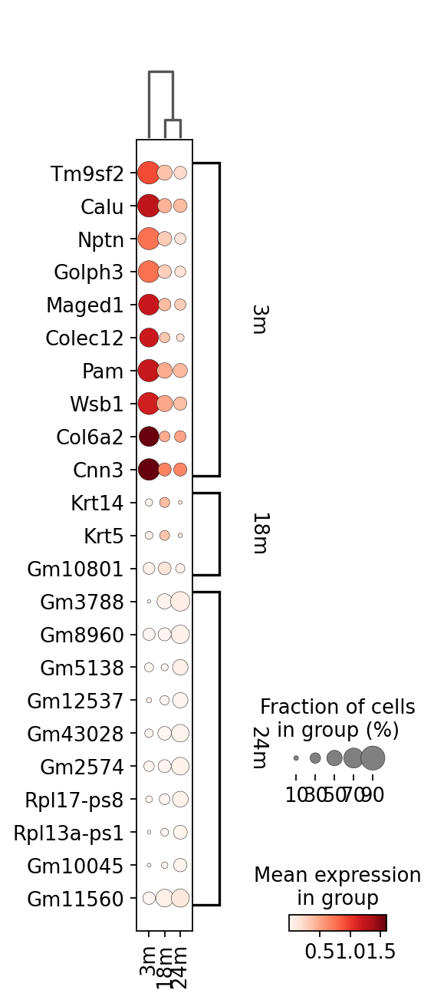

In [26]:
sc.tl.rank_genes_groups(adata_trachea, groupby = 'age', method = 'wilcoxon', pts = True)
sc.tl.filter_rank_genes_groups(adata_trachea, min_fold_change=2)
sc.pl.rank_genes_groups(adata_trachea, key='rank_genes_groups_filtered')
sc.pl.rank_genes_groups_dotplot(adata_trachea, key='rank_genes_groups_filtered', swap_axes=True)


In [48]:
adata_trachea = remove_cats(adata_trachea)
adata_trachea1 = adata_trachea.copy()

sc.tl.score_genes(adata_trachea1, oxphos, score_name = 'OXPHOS')
adata_trachea1 = remove_cats(adata_trachea1)

trachea1 = gene_expression_obs(adata_trachea1, oxphos)
trachea1 = remove_cats(trachea1)

computing score 'OXPHOS'
    finished: added
    'OXPHOS', score of gene set (adata.obs).
    149 total control genes are used. (0:00:00)


In [28]:
set(trachea1.obs['cell_ontology_class'])

{'T cell',
 'basal epithelial cell of tracheobronchial tree',
 'chondrocyte',
 'ciliated columnar cell of tracheobronchial tree',
 'endothelial cell',
 'fibroblast',
 'granulocyte',
 'keratinocyte',
 'macrophage',
 'mucus secreting cell',
 'smooth muscle cell of trachea'}

<ipython-input-49-641f228a9263>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.476e-03 U_stat=3.533e+03
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.322e+03
basal epithelial cell of tracheobronchial tree_3m v.s. basal epithelial cell of tracheobronchial tree_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.554e+03
basal epithelial cell of tracheobronchial tree_18m v.s. basal epithelial cell of tracheobronchial tree_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.292e+04
ciliated columnar cell of tracheobronchial tree_3m v.s. ciliated columnar cell of tracheobronchial tree_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, 

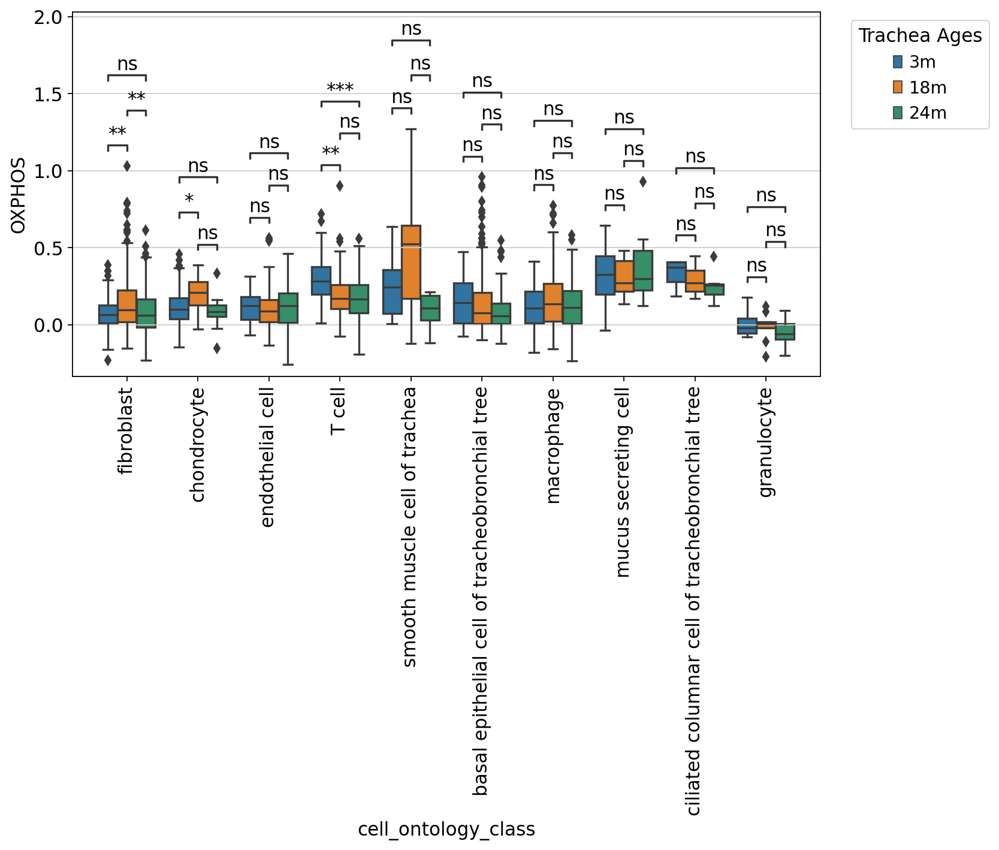

In [49]:
df = trachea1.obs[[ 'age','cell_ontology_class','OXPHOS']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")

mask = df['cell_ontology_class'].isin(['T cell',
 'basal epithelial cell of tracheobronchial tree',
 'chondrocyte',
 'ciliated columnar cell of tracheobronchial tree',
 'endothelial cell',
 'fibroblast',
 'granulocyte',
 'macrophage',
 'mucus secreting cell',
 'smooth muscle cell of trachea'])
df = df[mask]

x = "cell_ontology_class" 
y = "OXPHOS" 
hue_order = ['3m', '18m', '24m']
hue = 'age'


box_pairs=[
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("basal epithelial cell of tracheobronchial tree", "3m"), ("basal epithelial cell of tracheobronchial tree", "18m")),
    (("basal epithelial cell of tracheobronchial tree", "3m"), ("basal epithelial cell of tracheobronchial tree", "24m")),
    (("basal epithelial cell of tracheobronchial tree", "18m"), ("basal epithelial cell of tracheobronchial tree", "24m")),
    
    (("ciliated columnar cell of tracheobronchial tree", "3m"), ("ciliated columnar cell of tracheobronchial tree", "18m")),
    (("ciliated columnar cell of tracheobronchial tree", "3m"), ("ciliated columnar cell of tracheobronchial tree", "24m")),
    (("ciliated columnar cell of tracheobronchial tree", "18m"), ("ciliated columnar cell of tracheobronchial tree", "24m")),
    
    (("granulocyte", "3m"), ("granulocyte", "18m")),
    (("granulocyte", "3m"), ("granulocyte", "24m")),
    (("granulocyte", "18m"), ("granulocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "18m")),
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "24m")),
    (("mucus secreting cell", "18m"), ("mucus secreting cell", "24m")),
    
    (("chondrocyte", "3m"), ("chondrocyte", "18m")),
    (("chondrocyte", "3m"), ("chondrocyte", "24m")),
    (("chondrocyte", "18m"), ("chondrocyte", "24m")),
    
    (("smooth muscle cell of trachea", "3m"), ("smooth muscle cell of trachea", "18m")),
    (("smooth muscle cell of trachea", "3m"), ("smooth muscle cell of trachea", "24m")),
    (("smooth muscle cell of trachea", "18m"), ("smooth muscle cell of trachea", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1), title = "Trachea Ages")
#plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/trachea_OXPHOS_stat_05262022', dpi=150,bbox_inches='tight')



In [33]:
t_18sig = ['Tmsb10',
 'Cox6a1',
 'Gm6900',
 'Elob',
 'Serf2',
 'Ptprc',
 'Cox7c',
 'Tmem258',
 'mt-Atp8',
 'Sec61g',
 'Atp5k',
 'Msn',
 'Gm15536',
 'Arhgap30',
 'Tmem50b',
 'Lfng',
 'Cox5b',
 'Sept9',
 'Rexo2',
 'Xist',
 'Crlf2',
 'Selenot',
 'Nr3c1',
 'Nptn',
 'Cdk2ap2',
 'Lgals3bp',
 'Gm22751',
 'Tmem256',
 'Lamtor4',
 'Gm49369',
 'Rad23b',
 'AW112010',
 'Mknk2',
 'Mir692-2',
 'Was',
 'Arid1b',
 'CT033749.1',
 'Runx1',
 'Ifi204',
 'Ndufs5',
 'Dynlt1c',
 'Dbnl',
 'Ell2',
 'Ndufa3',
 'Gm15801',
 'Arrb2',
 'Usp8',
 'Zcrb1',
 'Pik3ap1',
 'Gigyf1',
 'Gngt2',
 'Tomm5',
 'Ubald2',
 'Snrpc',
 'Atf6b',
 'Lyst',
 'Dpm3',
 'Paip1',
 'Gm16372',
 'Pet100',
 'Cpne2',
 'Golph3',
 'Xiap',
 'Ddx17',
 'Qsox1',
 'Gm10012',
 'Babam1',
 'Ptk2b',
 'Shoc2',
 'Qdpr',
 'Brcc3',
 'Gm16418',
 'Sh2d1b1',
 'Scand1',
 'Gm26445',
 'Grk6',
 'Washc2',
 'Lsm7',
 'Dck',
 'Chmp4b',
 'Cers6',
 'Xpr1',
 'Trio',
 'Arl13b',
 'Haao',
 'Crybg3',
 'Fbxo6',
 'Nin',
 'Mrpl51',
 'Cops9',
 'Uqcr11',
 'Gm11966',
 'Tbl1xr1',
 'Uso1',
 'Hsd3b7',
 'Adcy7',
 'Tbc1d9',
 'Mctp1',
 'Nus1',
 'Oas1a',
 'Zfp386',
 'Ube4a',
 'Tifab',
 'Ifi27l2a',
 'Usp37',
 'Igsf8',
 'Sacm1l',
 'Crlf3',
 'Sh3bp1',
 'Mpnd',
 'Tomm6',
 'Svil',
 'Lmo4',
 'Cenpx',
 'Syne1',
 'Zbp1',
 'Tob1',
 'Ndufc1',
 'Dglucy',
 'Trim12c',
 'Add3',
 'Ywhag',
 'Trappc5',
 'Card11',
 'Slc4a7',
 'Arhgef1',
 'Gsr',
 'Evi2',
 'Myo18a',
 'P2ry14',
 'Cep170',
 'Sf3a2',
 'Gna15',
 'Ppm1h',
 'Hnrnpul2',
 'Sgk3',
 'Exosc5',
 'Thap6',
 'Smc5',
 'Dock8',
 'Irf2',
 '1700020I14Rik',
 'Gm44851',
 'Cfap43',
 'Anapc13',
 'Ube3b',
 'Bin2',
 'Mef2d',
 'Gm26526',
 'Socs4',
 'Dnajb14',
 'Sema4d',
 'Fes',
 'Uqcc2',
 'Slc15a2',
 'Ankrd13c',
 'Gak',
 'Vps37b',
 'Ciita',
 'Txndc11',
 'Gm35853',
 'Gm5846',
 'Gfod1',
 'Tpgs2',
 'Pink1',
 'Homer1',
 'Atp2c1',
 'Fth-ps3',
 'Slc4a1ap',
 'Smim27',
 'Gtf3a',
 'Slc38a10',
 'Frmd4b',
 'Pcbd2']

In [35]:
trachea1 = adata_trachea.copy()
trachea2 = remove_cats(trachea1)

In [37]:
def TRACHEA_gene_expression_df(adata, genelist):
    '''Takes adata object and a list of genes. 
    Returns a pandas dataframe where genes and their expression values are columns in dataframe of adata.'''
    df = adata.obs.copy()
    
    for g in genelist:
        df[g] = adata_trachea[:,g].X.toarray().flatten()
    return df 

adata_trachea_obs = gene_expression_obs(trachea2, t_18sig)
adata_trachea_obs = remove_cats(adata_trachea_obs)
df_trach = TRACHEA_gene_expression_df(adata_trachea_obs, t_18sig)

<ipython-input-46-69a05b0fbb91>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.189e-18 U_stat=2.360e+02
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.068e-11 U_stat=9.375e+03
basal epithelial cell of tracheobronchial tree_3m v.s. basal epithelial cell of tracheobronchial tree_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.563e-02 U_stat=4.451e+03
basal epithelial cell of tracheobronchial tree_18m v.s. basal epithelial cell of tracheobronchial tree_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=6.045e-02 U_stat=1.401e+04
ciliated columnar cell of tracheobronchial tree_3m v.s. ciliated columnar cell of tracheobronchial tree_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, 

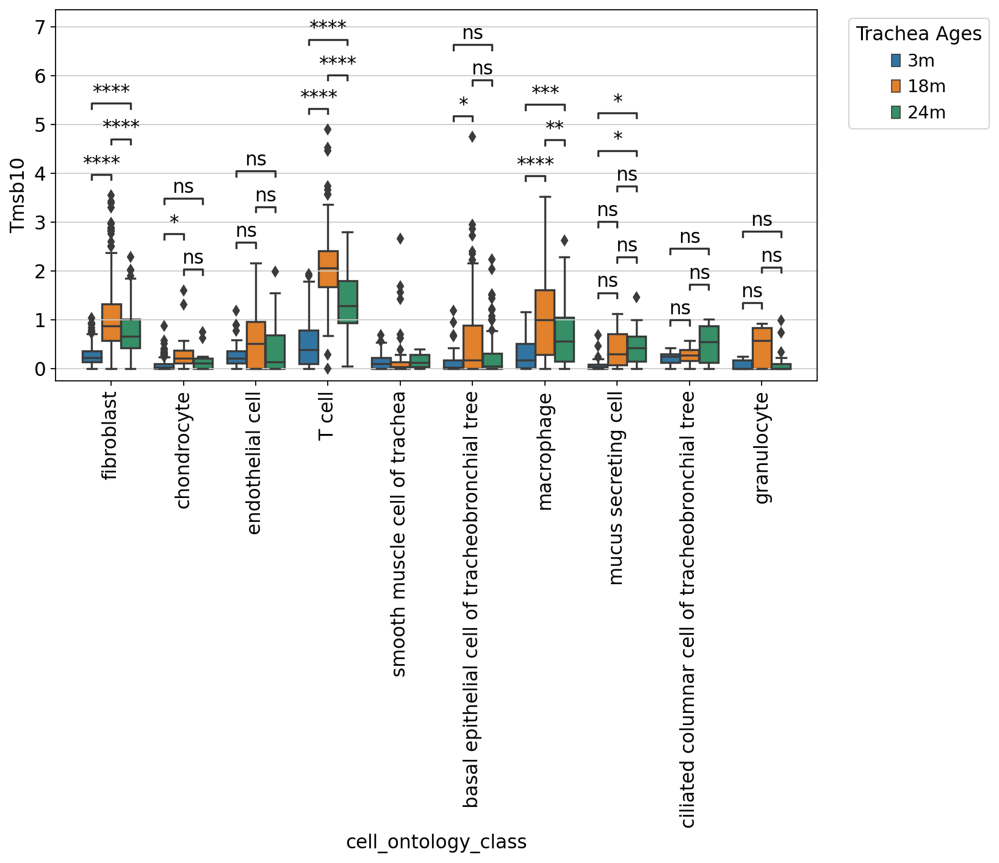

In [46]:
df = df_trach[[ 'age','cell_ontology_class','Tmsb10']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")

mask = df['cell_ontology_class'].isin(['T cell',
 'basal epithelial cell of tracheobronchial tree',
 'chondrocyte',
 'ciliated columnar cell of tracheobronchial tree',
 'endothelial cell',
 'fibroblast',
 'granulocyte',
 'macrophage',
 'mucus secreting cell',
 'smooth muscle cell of trachea'])
df = df[mask]


x = "cell_ontology_class" 
y = "Tmsb10" 
hue_order = ['3m', '18m', '24m']
hue = 'age'

box_pairs=[
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("basal epithelial cell of tracheobronchial tree", "3m"), ("basal epithelial cell of tracheobronchial tree", "18m")),
    (("basal epithelial cell of tracheobronchial tree", "3m"), ("basal epithelial cell of tracheobronchial tree", "24m")),
    (("basal epithelial cell of tracheobronchial tree", "18m"), ("basal epithelial cell of tracheobronchial tree", "24m")),
    
    (("ciliated columnar cell of tracheobronchial tree", "3m"), ("ciliated columnar cell of tracheobronchial tree", "18m")),
    (("ciliated columnar cell of tracheobronchial tree", "3m"), ("ciliated columnar cell of tracheobronchial tree", "24m")),
    (("ciliated columnar cell of tracheobronchial tree", "18m"), ("ciliated columnar cell of tracheobronchial tree", "24m")),
    
    (("granulocyte", "3m"), ("granulocyte", "18m")),
    (("granulocyte", "3m"), ("granulocyte", "24m")),
    (("granulocyte", "18m"), ("granulocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "18m")),
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "24m")),
    (("mucus secreting cell", "18m"), ("mucus secreting cell", "24m")),
    
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "18m")),
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "24m")),
    (("mucus secreting cell", "18m"), ("mucus secreting cell", "24m")),
    
    (("chondrocyte", "3m"), ("chondrocyte", "18m")),
    (("chondrocyte", "3m"), ("chondrocyte", "24m")),
    (("chondrocyte", "18m"), ("chondrocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
plt.xticks(rotation=90)

ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1), title = "Trachea Ages")
plt.savefig('/mnt/ibm_sm/home/lea.mcgeever/ms/notebooks/figures/trachea_Tmsb10_statannot_05262022.png', dpi=150,bbox_inches='tight')



In [41]:
df = tracheaOXPHOS_obs.obs[[ 'age','cell_ontology_class','OXPHOS']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")

x = "cell_ontology_class" 
y = "OXPHOS" 
hue_order = ['3m', '18m', '24m']
hue = 'age'


box_pairs=[
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("basal epithelial cell of tracheobronchial tree", "3m"), ("basal epithelial cell of tracheobronchial tree", "18m")),
    (("basal epithelial cell of tracheobronchial tree", "3m"), ("basal epithelial cell of tracheobronchial tree", "24m")),
    (("basal epithelial cell of tracheobronchial tree", "18m"), ("basal epithelial cell of tracheobronchial tree", "24m")),
    
    (("ciliated columnar cell of tracheobronchial tree", "3m"), ("ciliated columnar cell of tracheobronchial tree", "18m")),
    (("ciliated columnar cell of tracheobronchial tree", "3m"), ("ciliated columnar cell of tracheobronchial tree", "24m")),
    (("ciliated columnar cell of tracheobronchial tree", "18m"), ("ciliated columnar cell of tracheobronchial tree", "24m")),
    
    (("granulocyte", "3m"), ("granulocyte", "18m")),
    (("granulocyte", "3m"), ("granulocyte", "24m")),
    (("granulocyte", "18m"), ("granulocyte", "24m")),
    
    (("endothelial cell", "3m"), ("endothelial cell", "18m")),
    (("endothelial cell", "3m"), ("endothelial cell", "24m")),
    (("endothelial cell", "18m"), ("endothelial cell", "24m")),
    
    (("fibroblast", "3m"), ("fibroblast", "18m")),
    (("fibroblast", "3m"), ("fibroblast", "24m")),
    (("fibroblast", "18m"), ("fibroblast", "24m")),
    
    (("keratinocyte", "3m"), ("keratinocyte", "18m")),
    (("keratinocyte", "3m"), ("keratinocyte", "24m")),
    (("keratinocyte", "18m"), ("keratinocyte", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
    
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "18m")),
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "24m")),
    (("mucus secreting cell", "18m"), ("mucus secreting cell", "24m")),
    
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "18m")),
    (("mucus secreting cell", "3m"), ("mucus secreting cell", "24m")),
    (("mucus secreting cell", "18m"), ("mucus secreting cell", "24m")),
    
    (("chondrocyte", "3m"), ("chondrocyte", "18m")),
    (("chondrocyte", "3m"), ("chondrocyte", "24m")),
    (("chondrocyte", "18m"), ("chondrocyte", "24m")),
    ]
fig = plt.figure(figsize=(10, 5))
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1), title = "Ages")
plt.xticks(rotation=90)


NameError: name 'tracheaOXPHOS_obs' is not defined

### Jablonski, Cd38 confusion, overpowering?

In [185]:
Jablonski_genes = ['Cd38','Fpr2','Gpr18','Nos2','Il1b','Il12b','Ccr7','Inhba','Tnf','Arg1','Retnla','Fn1','Mrc1'
                  ]

In [186]:
tissue_copy5 = tissue.copy()
sc.tl.score_genes(tissue_copy5, Jablonski_genes, score_name = 'Jablonski')

Jablonski_obs = gene_expression_obs(tissue_copy5,Jablonski_genes)
Jablonski_obs = remove_cats(Jablonski_obs)
Jablonski_df = gene_expression_df(Jablonski_obs,Jablonski_genes)


computing score 'Jablonski'
    finished: added
    'Jablonski', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


In [187]:
ja = Jablonski_df.loc[Jablonski_df['cell_ontology_class'] == 'fenestrated cell']
jja=ja[['age','Cd38']]

**overpowering?**

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

3m v.s. 18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=5.319e-01 U_stat=1.245e+02
18m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.720e+02
3m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.000e+01


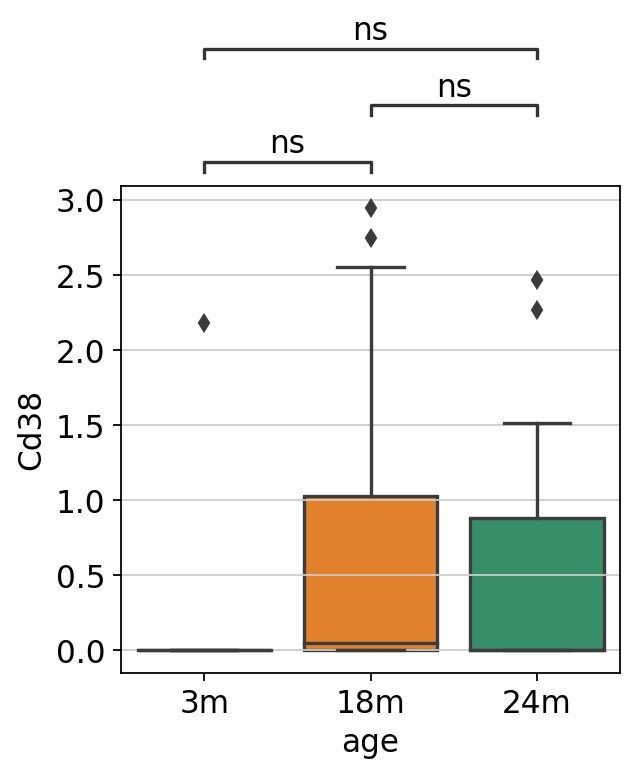

In [188]:
#B cell
jb = Jablonski_df.loc[Jablonski_df['cell_ontology_class'] == 'B cell']
jjb=jb[['age','Cd38']]

df = jjb
x = "age"
y = "Cd38"
order = ['3m', '18m', '24m']
ax = sns.boxplot(data=df, x=x, y=y, order=order)
test_results = add_stat_annotation(ax, data=df, x=x, y=y, order=order,
                                   box_pairs=[("3m", "18m"), ("3m", "24m"), ("18m", "24m")],
                                   test='Mann-Whitney', text_format='star',
                                   loc='outside', verbose=2)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

3m v.s. 18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=8.185e-02 U_stat=3.434e+03
18m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.037e-02 U_stat=3.303e+03
3m v.s. 24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.646e-07 U_stat=8.194e+03


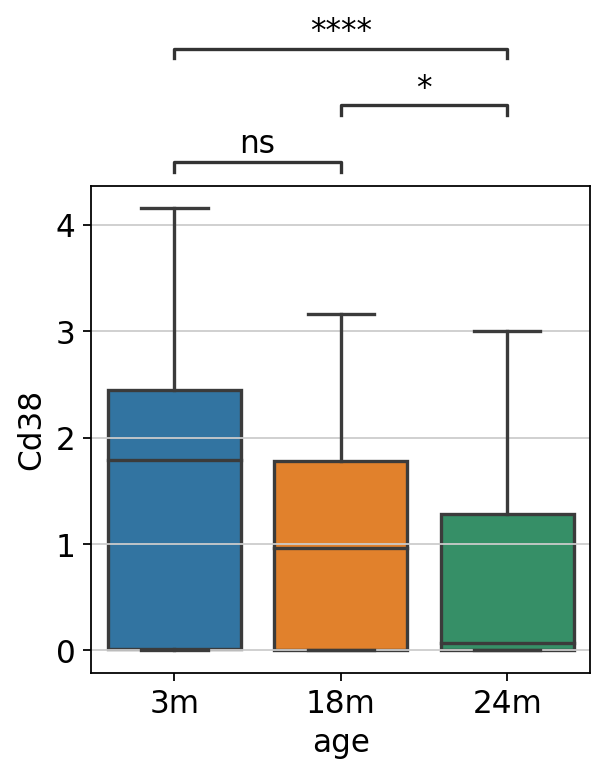

In [189]:
#fenestrated cell

df = jja
x = "age"
y = "Cd38"
order = ['3m', '18m', '24m']
ax = sns.boxplot(data=df, x=x, y=y, order=order)
test_results = add_stat_annotation(ax, data=df, x=x, y=y, order=order,
                                   box_pairs=[("3m", "18m"), ("3m", "24m"), ("18m", "24m")],
                                   test='Mann-Whitney', text_format='star',
                                   loc='outside', verbose=2)

<ipython-input-190-dad60dce1122>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.720e+02
B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.245e+02
fenestrated cell_3m v.s. fenestrated cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.637e-01 U_stat=3.434e+03
fenestrated cell_18m v.s. fenestrated cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.074e-02 U_stat=3.303e+03
B cell_3m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=4.000e+01
fenestrated cell_3m v.s. fenestrated cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.292e-07 U_stat=8.194e+03


(<AxesSubplot:xlabel='cell_ontology_class', ylabel='Cd38'>,
  <statannot.StatResult.StatResult at 0x7f7bbd66e0a0>])

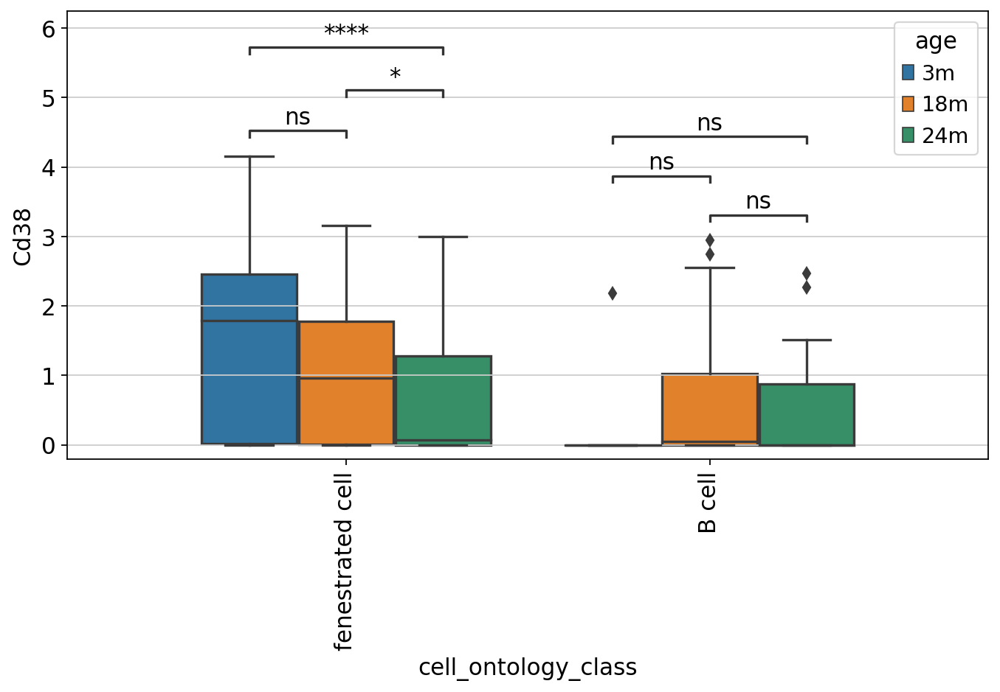

In [190]:
df = Jablonski_df[['age','cell_ontology_class','Cd38']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','fenestrated cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Cd38" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
   
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)


#### Jablonski score_genes

<ipython-input-191-d5d2d667871f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["age_months"] = [int(e[:-1]) for e in df.age]
No handles with labels found to put in legend.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

B cell_3m v.s. B cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.940e+02
B cell_18m v.s. B cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.680e+02
T cell_3m v.s. T cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.400e+01
T cell_18m v.s. T cell_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=5.650e+02
epithelial cell of proximal tubule_18m v.s. epithelial cell of proximal tubule_24m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=1.216e+04
kidney collecting duct epithelial cell_3m v.s. kidney collecting duct epithelial cell_18m: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correcti

(<AxesSubplot:xlabel='cell_ontology_class', ylabel='Jablonski'>,
  <statannot.StatResult.StatResult at 0x7f7786073a00>])

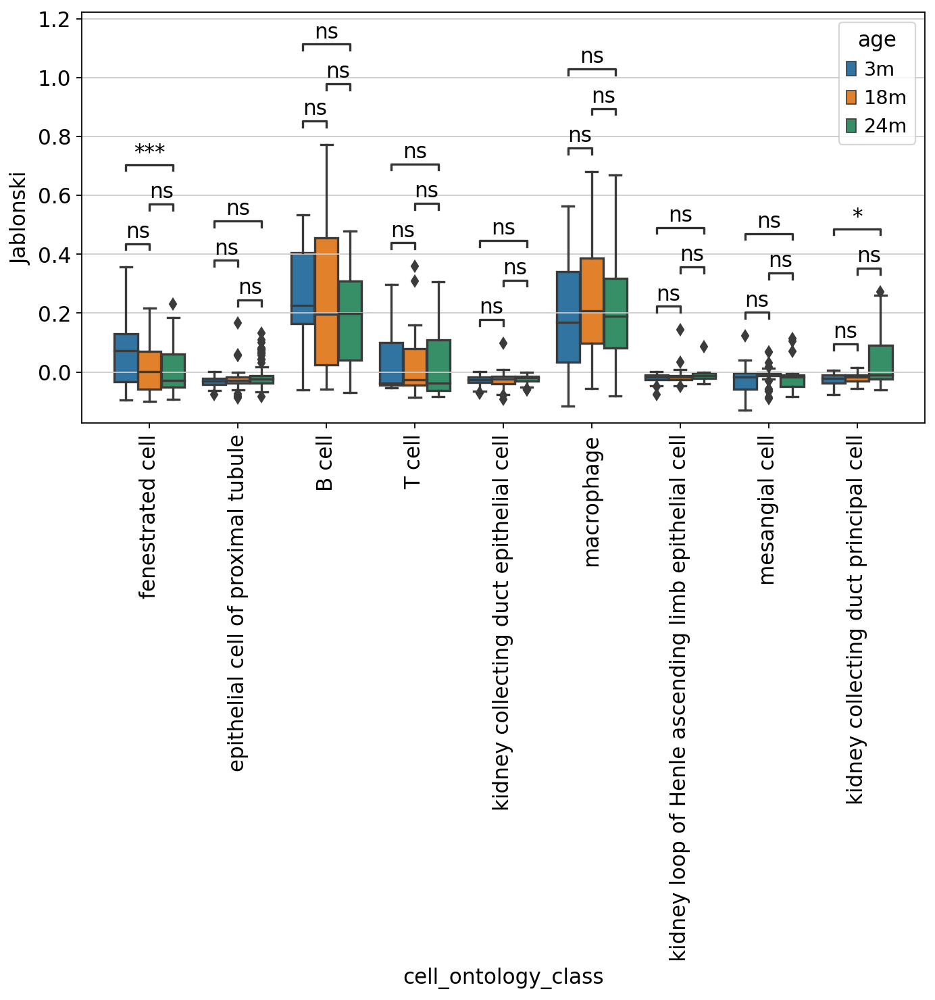

In [191]:
df = Jablonski_df[['age','cell_ontology_class','Jablonski']]
df["age_months"] = [int(e[:-1]) for e in df.age]
df = df.sort_values("age_months")
mask = df['cell_ontology_class'].isin(['B cell','T cell','epithelial cell of proximal tubule','fenestrated cell','kidney collecting duct epithelial cell','kidney collecting duct principal cell','kidney loop of Henle ascending limb epithelial cell','macrophage', 'mesangial cell'])
df = df[mask]

x = "cell_ontology_class" 
y = "Jablonski" 
hue = 'age'
hue_order = ['3m', '18m', '24m']

box_pairs=[
    (("B cell", "3m"), ("B cell", "18m")),
    (("B cell", "3m"), ("B cell", "24m")),
    (("B cell", "18m"), ("B cell", "24m")),
    
    (("T cell", "3m"), ("T cell", "18m")),
    (("T cell", "3m"), ("T cell", "24m")),
    (("T cell", "18m"), ("T cell", "24m")),
    
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "18m")),
    (("epithelial cell of proximal tubule", "3m"), ("epithelial cell of proximal tubule", "24m")),
    (("epithelial cell of proximal tubule", "18m"), ("epithelial cell of proximal tubule", "24m")),
    
    (("fenestrated cell", "3m"), ("fenestrated cell", "18m")),
    (("fenestrated cell", "3m"), ("fenestrated cell", "24m")),
    (("fenestrated cell", "18m"), ("fenestrated cell", "24m")),
    
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "18m")),
    (("kidney collecting duct epithelial cell", "3m"), ("kidney collecting duct epithelial cell", "24m")),
    (("kidney collecting duct epithelial cell", "18m"), ("kidney collecting duct epithelial cell", "24m")),
    
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "18m")),
    (("kidney collecting duct principal cell", "3m"), ("kidney collecting duct principal cell", "24m")),
    (("kidney collecting duct principal cell", "18m"), ("kidney collecting duct principal cell", "24m")),
    
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "18m")),
    (("kidney loop of Henle ascending limb epithelial cell", "3m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    (("kidney loop of Henle ascending limb epithelial cell", "18m"), ("kidney loop of Henle ascending limb epithelial cell", "24m")),
    
    (("macrophage", "3m"), ("macrophage", "18m")),
    (("macrophage", "3m"), ("macrophage", "24m")),
    (("macrophage", "18m"), ("macrophage", "24m")),
       
    (("mesangial cell", "3m"), ("mesangial cell", "18m")),
    (("mesangial cell", "3m"), ("mesangial cell", "24m")),
    (("mesangial cell", "18m"), ("mesangial cell", "24m")),  
    ]
fig = plt.figure(figsize=(10, 5))
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xticks(rotation=90)
ax = sns.boxplot(data=df, x=x, y=y, hue=hue)
add_stat_annotation(ax, data=df, x=x, y=y,hue=hue,box_pairs=box_pairs,
                    test='Mann-Whitney',loc='inside',verbose=2)